# Trabajo Práctico parte 1

Importar librerías necesarias

In [1]:
!pip install shap
!pip install optuna

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 532.9/532.9 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 409.6/409.6 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 230.6/230.6 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 8.7 MB/s eta 0:00:00


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.formula.api as smf
from scipy.stats import pearsonr
from sklearn.impute import KNNImputer
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold, cross_validate, cross_val_score, cross_val_predict, RandomizedSearchCV, GridSearchCV
from sklearn.pipeline import make_pipeline
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import LassoCV
from sklearn.linear_model import ElasticNetCV
from sklearn import metrics
from sklearn.metrics import r2_score, PredictionErrorDisplay, RocCurveDisplay
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegressionCV, LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, get_scorer_names
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import roc_curve, roc_auc_score, auc
from time import time
import scipy.stats as stats
import shap
from tensorflow import keras
from sklearn.model_selection import KFold
import optuna
import warnings
warnings.filterwarnings("ignore")

## 1 - Análisis Exploratorio (EDA)
Se comenzará haciendo un análisis explotarorio del dataset para conocer sus características principales y evaluar si es necesario hacer algún manejo de datos faltantes, outliers, codificar variables categóricas, o algún otro proceso antes de comenzar.


Para esto se hallarán:

-.  Medidas de centralidad

-.  Cuartiles y percentiles

-.  Medidas de dispersión

-.  Valores atípicos

-.  Gráficos de proporciones y porcentajes

-.  Matriz de correlación

-.  Métricas de distancia y similaridad

En esta primera etapa se obtendrá información sobre el dataset y se realizarán gráficos que permitan observar los datos sin realizar modificaciones previas sobre el set de datos, es decir, se analizará el dataset tal como proviene de la fuente.

### 1.1 - Importar el dataset y visualizar el dataframe

In [410]:
weatherAUS_df = pd.read_csv('weatherAUS.csv')

A cerca del dataset:

Este conjunto de datos contiene aproximadamente 10 años de observaciones meteorológicas diarias de distintas ciudades de Australia.

Fuente:

Las observaciones se obtuvieron de numerosas estaciones meteorológicas.

Definiciones adaptadas de http://www.bom.gov.au/climate/dwo/IDCJDW2801.latest.shtml.

Fuente de datos: http://www.bom.gov.au/climate/dwo/ y http://www.bom.gov.au/climate/data.

In [77]:
weatherAUS_df

,Unnamed: 0,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,...,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,RainfallTomorrow
0,0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,...,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No,0.0
1,1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,...,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No,0.0
2,2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,...,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No,0.0
3,3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,...,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No,1.0
4,4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,...,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145407,145454,2017-06-20,Uluru,3.5,21.8,0.0,NaN,NaN,E,31.0,...,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9,No,No,0.0
145408,145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,...,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No,0.0
145409,145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,...,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No,0.0
145410,145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,...,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No,0.0


### 1.2 - Filtrar las filas de interés

In [411]:
# Eliminar la columna 'Unnamed: 0' del DataFrame
weatherAUS_df = weatherAUS_df.drop(columns=['Unnamed: 0'])

# Eliminar registros con datos nulos en las variables respuesta 'RainTomorrow' y 'RainfallTomorrow'
weatherAUS_df.dropna(subset=['RainTomorrow', 'RainfallTomorrow'], inplace=True)

# Lista de ubicaciones de interés
ubicaciones_interes = ["Sydney", "SydneyAirport", "Canberra", "Melbourne", "MelbourneAirport"]

# Filtrar las filas en base a las ubicaciones interes
weatherAUS_df = weatherAUS_df[weatherAUS_df['Location'].isin(ubicaciones_interes)]

# Determinación de ciudades
cities = weatherAUS_df.Location.unique()

print(f'Lista de ciudades de interés: {cities}')
print(f'Cantidad de ciudades restantes: {len(cities)}')
print(f'Cantidad de registros {len(weatherAUS_df)}')

Lista de ciudades de interés: ['Sydney' 'SydneyAirport' 'Canberra' 'MelbourneAirport' 'Melbourne']
Cantidad de ciudades restantes: 5
Cantidad de registros 15199


### 1.3 - Conocer las columnas
En este paso se imprime una lista de las columnas con sus respectivos tipos y cantidad de datos.

La descripción de las columnas provista por quien publicó el dataset es la siguiente:

1. Date: Fecha de la observación
2. Location: El nombre común de la ubicación de la estación 1. 1. meteorológica.
3. MinTemp: La temperatura mínima en grados Celsius.
4. MaxTemp: La temperatura máxima en grados Celsius.
5. Rainfall: La cantidad de lluvia registrada durante el día en mm.
6. Evaporation: La denominada evaporación del recipiente de Clase A (mm) en las 24 horas hasta las 9 a.m.
7. Sunshine: El número de horas de sol brillante en el día.
8. WindGustDir: La dirección de la ráfaga de viento más fuerte en las 24 horas hasta la medianoche.
9. WindGustSpeed: La velocidad (km/h) de la ráfaga de viento más fuerte en las 24 horas previas a la medianoche.
10. WinDir9am: Dirección del viento a las 9 a.m.
11. WinDir3pm: Dirección del viento a las 3 p.m.
12. WindSpeed9am: Velocidad del viento (km/h) promediada durante 10 minutos antes de las 9 a.m.
13. WindSpeed3pm: Velocidad del viento (km/h) promediada durante 10 minutos antes de las 3 p.m.
14. Humidity9am: Humedad (porcentaje) a las 9 a.m.
15. Humidity3pm: Humedad (porcentaje) a las 15:00 horas.
16. Pressure9am: La presión atmosférica (hpa) se redujo al nivel medio del mar a las 9 a.m.
17. Pressure3pm: La presión atmosférica (hpa) se redujo al nivel medio del mar a las 3 p.m.
18. Cloud9am: Fracción del cielo oscurecida por las nubes a las 9:00 horas. Esto se mide en "oktas", que son una unidad de octavos. 1. 1. Registra cuántas octavas partes del cielo están oscurecidas por las nubes. Una medida 0 indica cielo completamente despejado mientras que un 8 indica que está completamente nublado.
19. Cloud3pm: Fracción de cielo oscurecida por nubes (en "oktas": octavos) a las 15.00 horas. Consulte Cload9am para obtener una descripción de los valores.
20. Temp9am: Temperatura (grados C) a las 9 a.m.
21. Temp3pm: Temperatura (grados C) a las 15:00 horas.
22. RainToday: Booleano: 1 si la precipitación (mm) en las 24 horas hasta las 9 a. m. excede 1 mm; de lo contrario, 0.
23. RainTomorrow: Indica si llueve mañana o no.
24. RainfallTomorrow: La cantidad de lluvia del día siguiente en mm.

### 1.4 - Medidas estadísticas y de localización
En este paso se estudian, para cada columna, medidas de localización como mínimo, máximo, cuartiles, y de centralidad como la mediana y la media.

In [ ]:
weatherAUS_df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainfallTomorrow
count,15189.000000,15193.000000,15036.000000,13505.000000,13260.000000,13756.000000,14939.000000,14950.000000,15111.000000,15154.000000,14946.000000,14954.000000,13158.000000,12917.000000,15175.000000,15183.000000,15199.000000
mean,11.606057,21.784203,2.299601,4.869108,6.897270,44.323786,16.479617,21.746622,68.884918,51.238683,1018.334022,1016.079898,4.738486,4.735852,15.570662,20.260304,2.302586
std,5.877294,6.055148,7.404618,3.057514,3.836702,14.952565,10.282170,9.529054,15.645965,17.735612,7.398337,7.264708,2.731410,2.593568,5.570913,5.858891,7.385251
min,-8.000000,4.100000,0.000000,0.000000,0.000000,11.000000,0.000000,0.000000,11.000000,3.000000,986.700000,985.500000,0.000000,0.000000,-1.300000,3.700000,0.000000
25%,7.900000,17.200000,0.000000,2.600000,3.800000,33.000000,9.000000,15.000000,59.000000,39.000000,1013.400000,1011.200000,2.000000,2.000000,11.600000,16.000000,0.000000
50%,11.600000,21.300000,0.000000,4.200000,7.600000,43.000000,15.000000,20.000000,70.000000,51.000000,1018.500000,1016.300000,6.000000,6.000000,15.400000,19.800000,0.000000
75%,15.900000,25.800000,0.800000,6.600000,10.000000,54.000000,22.000000,28.000000,80.000000,62.000000,1023.300000,1021.000000,7.000000,7.000000,19.600000,24.200000,0.800000
max,30.500000,46.800000,119.400000,23.800000,13.900000,122.000000,69.000000,76.000000,100.000000,100.000000,1040.600000,1037.900000,9.000000,8.000000,37.200000,46.100000,119.400000


In [ ]:
weatherAUS_df[['RainToday', 'RainTomorrow']].describe()

,RainToday,RainTomorrow
count,15036,15199
unique,2,2
top,No,No
freq,11541,11643


Para las columnas analizadas, en general se puede notar que la medida de la media es muy cercana a la mediana indicando que el valor promedio de los datos coincide con el valor central de la distribución. Los desvíos no suelen superar el 25% dando indicio de que la caja de un diagrama de boxplot no sería muy alargada.

Además, los valores mínimos y máximos registrados suelen estar muy alejados de los valores centrales, por lo que se espera presencia de valores atípicos.

Específicamente, en las columnas que representan presión se observa una media, mediana, valor mínimo y máximo muy cercanos. Tiene sentido considerando que se trata de pesión y no se espera gran variabilidad en las mediciones.

### 1.5 - Datos faltantes
Aquí se utiliza otro método de Pandas para ver más claramente la cantidad de datos faltantes

In [ ]:
# Identificar la cantidad de filas con datos faltantes para cada columna
missing_data = weatherAUS_df.isnull().sum()
print(missing_data)

Date                   0
Location               0
MinTemp               10
MaxTemp                6
Rainfall             163
Evaporation         1694
Sunshine            1939
WindGustDir         1445
WindGustSpeed       1443
WindDir9am           678
WindDir3pm           289
WindSpeed9am         260
WindSpeed3pm         249
Humidity9am           88
Humidity3pm           45
Pressure9am          253
Pressure3pm          245
Cloud9am            2041
Cloud3pm            2282
Temp9am               24
Temp3pm               16
RainToday            163
RainTomorrow           0
RainfallTomorrow       0
dtype: int64


In [ ]:
# Obtener el mayor valor de valores faltantes por columna
max_missing_values = missing_data.max()

# Calcular el porcentaje en relación a la cantidad total de datos
total_rows = weatherAUS_df.shape[0]
percentage_missing = (max_missing_values / total_rows) * 100

print(f"El mayor valor de valores faltantes por columna es {max_missing_values}.")
print(f"La cantidad de registros total en el dataframe es {total_rows }")
print(f"Representa aproximadamente el {percentage_missing:.2f}% de los datos totales.")


El mayor valor de valores faltantes por columna es 2282.
La cantidad de registros total en el dataframe es 15199
Representa aproximadamente el 15.01% de los datos totales.


Este resultado indica que se debe realizar una imputación de datos, debido a que los datos son valiosos y costosos y no se desean descartar más de un 5% de los mismos.

### 1.6 - Visualización de Datos Numéricos


#### 1.6.1 - Gráficos de Caja y Bigotes
Para visualizar la distribución de las variables se realizaron gráficos de caja y bigote.

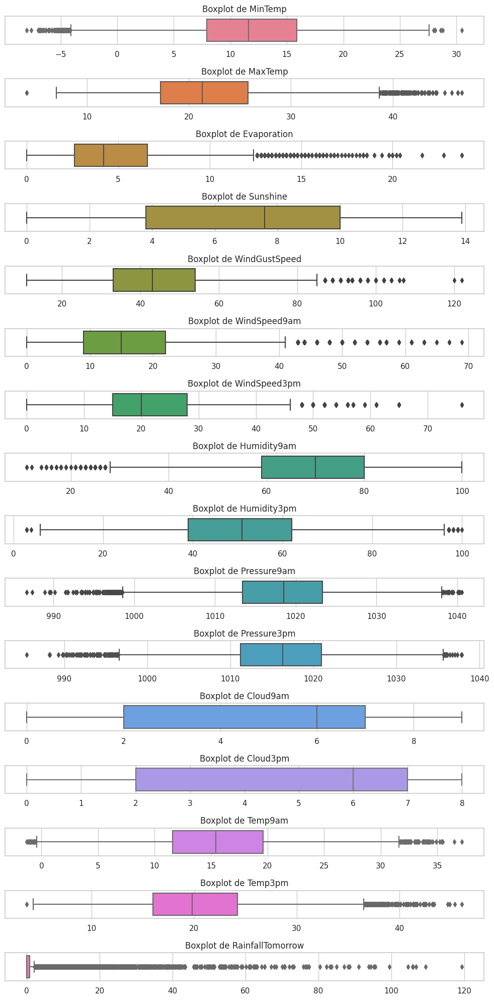

In [ ]:
# Columnas numéricas
numeric_columns = [
    'MinTemp', 'MaxTemp', 'Evaporation', 'Sunshine', 'WindGustSpeed',
    'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am',
    'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainfallTomorrow'
]

# Colores para los boxplots
colors = sns.color_palette('husl', n_colors=len(numeric_columns))

# Crear subplots
fig, axes = plt.subplots(len(numeric_columns), 1, figsize=(10, 20), sharex=False)

# Generar boxplots horizontales para cada columna numérica
for i, col in enumerate(numeric_columns):
    sns.boxplot(data=weatherAUS_df, x=col, ax=axes[i], color=colors[i], orient='h')
    axes[i].set_title(f'Boxplot de {col}')
    axes[i].set_xlabel('')  # Elimina la etiqueta del eje x para mayor claridad

# Ajustar espaciado entre subplots
plt.tight_layout()

# Mostrar los gráficos
plt.show()

En la figura donde se representan los boxplot de las columnas del dataset se observa en la mayoría de las columnas la presencia de valores atípicos. En algunas variables dichos valores se encuentran más alejados. Otras veces se encuentran más cercanos y hacia ambos lados del diagrama.

También se puede notar que hay varibales que no presentan valores atípicos según el cálculo usado por el boxplot para mostrar los mismos (para el límite inferior es es q1 -1.5\*RIC y para el límite superior es q3 + 1.5\*RIC).

Las variables que presentan mayor amplitud en el boxplot, indicando mayor dispersión en los valores de los datos son Sunshine, Cloud9am y Cloud3pm.

#### 1.6.2 - Histogramas
Para visualizar las distribuciones de forma más detallada se realizaron también histogramas de cada una.

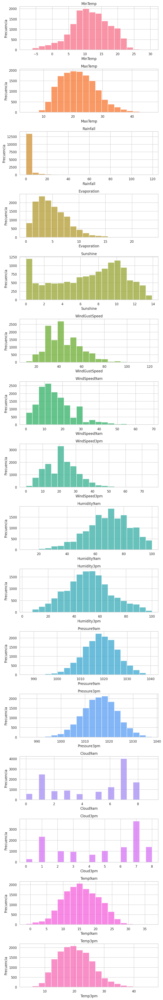

In [ ]:
# Seleccionar las columnas numéricas excluyendo "RainfallTomorrow"
numeric_columns = weatherAUS_df.select_dtypes(include=['float64']).drop(columns=['RainfallTomorrow'])

# Configurar el número de subplots y el tamaño de la figura
num_plots = len(numeric_columns.columns)
fig, axes = plt.subplots(num_plots, 1, figsize=(8, num_plots * 3))

# Definir una paleta de colores para Seaborn
color_palette = sns.color_palette("husl", num_plots)

# Crear un histograma para cada columna numérica con colores distintos
for i, column in enumerate(numeric_columns.columns):
    ax = axes[i]
    sns.histplot(weatherAUS_df[column].dropna(), bins=20, color=color_palette[i], ax=ax)
    ax.set_title(column)
    ax.set_xlabel(column)
    ax.set_ylabel('Frecuencia')

# Ajustar espaciado entre subplots
plt.tight_layout()

# Mostrar los histogramas
plt.show()

El gráfico boxplot es útil para visualizar medidas de centralidad y dispersión pero limita al momento de conocer mejor el comportamiento de los datos.

En los gráficos anteriores se puede notar que hay variables cuyos valores se encuentran más homogéneamente distribuidos, tales como los de temperatura, humedad y presión. Otros muestran la presencia de más de una moda en los datos y una distribución menos ordenada.

Ahora se confirma lo que se había obeservado en los box plots de que sunshine se desitribuye más dispersamente que las demás. Pero también se obserba que las Cloud que también parecían dispersas se muestran bimodales en lso valores de 1 y 7. Además se confirma que Rainfall tiene la inmensa mayoría de sus datos concentradas en cero.


### 1.7 - Correlación entre variables

#### 1.7.1 - Gráfico de pares

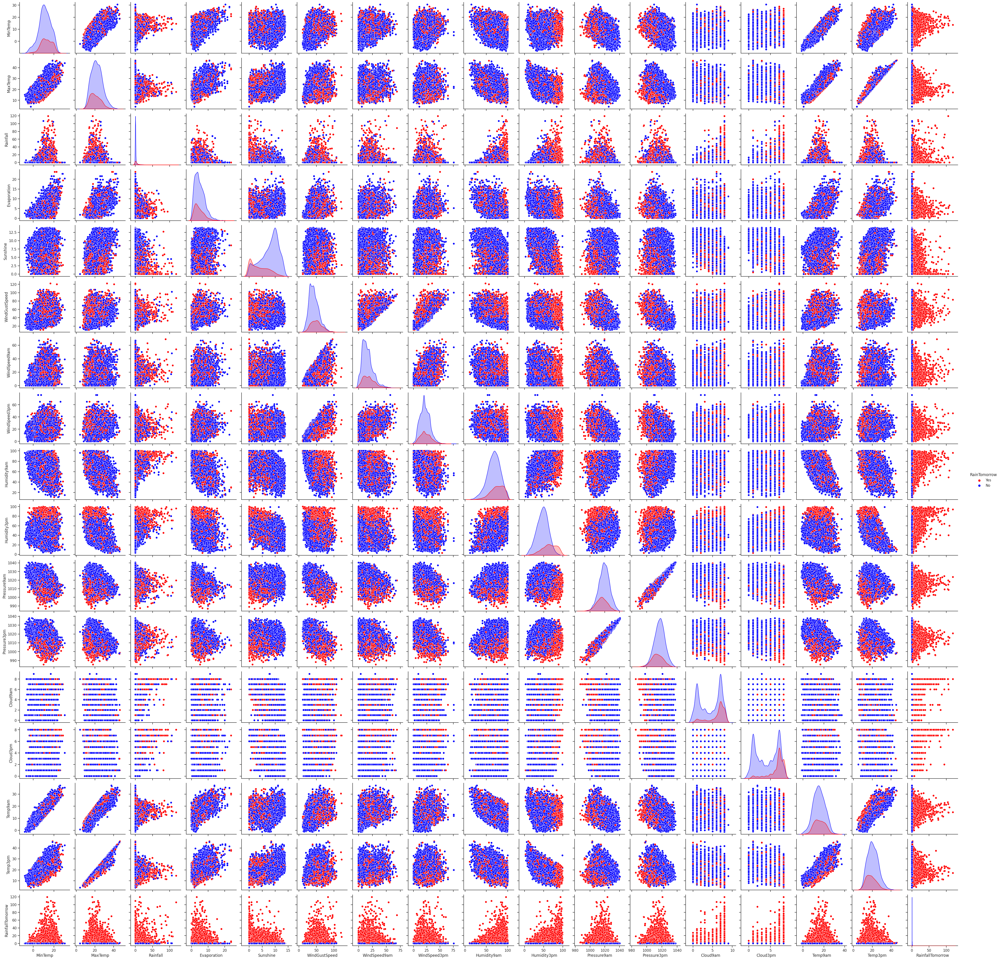

In [417]:
# Seleccionar las columnas numéricas
numeric_columns = weatherAUS_df.select_dtypes(include=['float64'])

# Agregar la columna 'RainTomorrow' al DataFrame de columnas numéricas
numeric_columns['RainTomorrow'] = weatherAUS_df['RainTomorrow']

# Crear el pairplot
sns.set(style="ticks")
sns.pairplot(numeric_columns, diag_kind='kde', hue='RainTomorrow', palette={"Yes": "red", "No": "blue"})
plt.show()

Se observan pares de variables altamente correlacionadas, que luego deberán ser analizadas para evitar la multicolinealidad.

#### 1.7.2 - Matriz de correlación

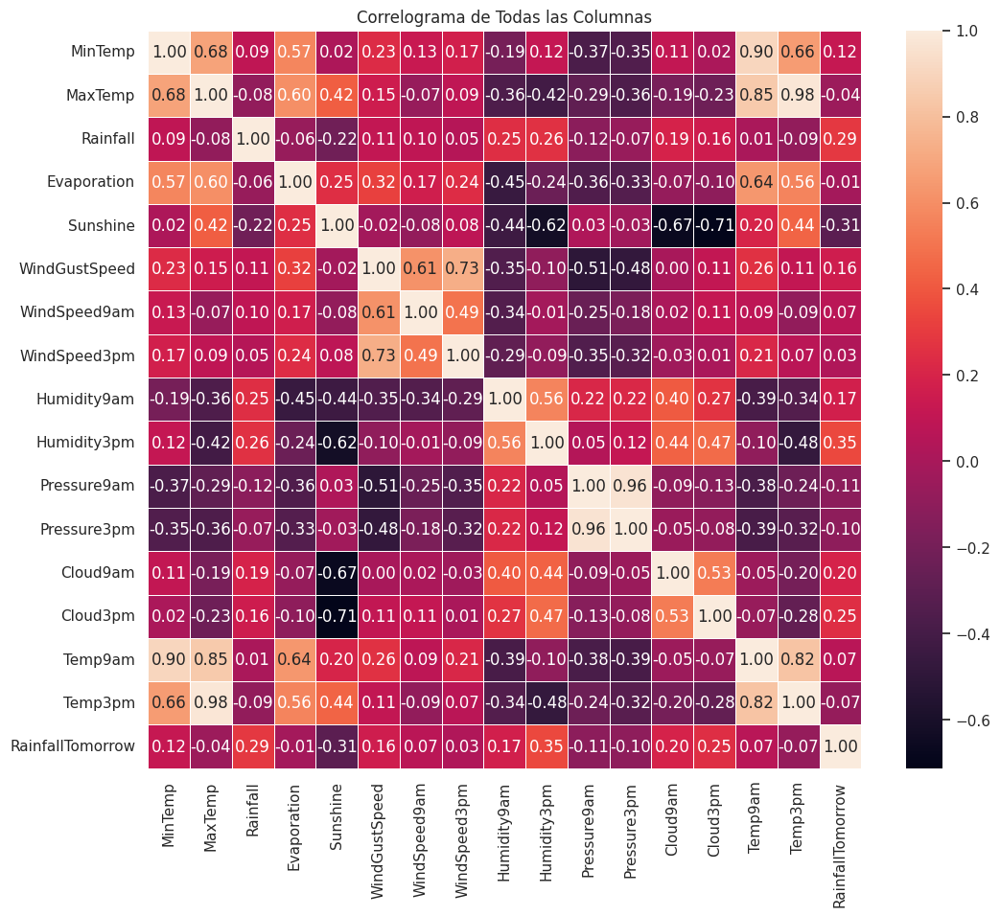

In [412]:
# Calcular la matriz de correlación
correlation_matrix = weatherAUS_df.corr()

# Crear un mapa de calor (correlograma)
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, cmap='rocket', annot=True, fmt=".2f", linewidths=0.5)
plt.title('Correlograma de Todas las Columnas')
plt.show()

Se realiza la matriz de correlación ya que permite ver de forma rápida si existe alguna relación lineal entre las variables. Un valor de 1 indica una relación lineal positiva perfecta, un valor de -1 indica una relación lineal negativa perfecta y un valor de 0 indica que no hay relación lineal entre las variables. Esto facilita la identificación y comparación de las relaciones más fuertes y débiles entre pares de variables en un conjunto de datos.

#### 1.7.3 - Graficos de dispersión de variables altamente correlacionadas (>0.6)
Se grafican scatterplots de variables correlacionadas con el fin de visualizar mejor la distribución de los datos en los ejes.

In [413]:
# Calcular la matriz de correlación
correlation_matrix = weatherAUS_df.corr(numeric_only=True)

# Definir el umbral de correlación
umbral = 0.65

# Encontrar pares de columnas con correlaciones fuera del umbral
high_corr_pairs = []

for i in range(len(correlation_matrix.columns)):
    for j in range(i+1, len(correlation_matrix.columns)):
        if abs(correlation_matrix.iloc[i, j]) >= umbral:
            high_corr_pairs.append((correlation_matrix.columns[i], correlation_matrix.columns[j], correlation_matrix.iloc[i, j]))

# Imprimir pares de columnas y sus correlaciones, y crear el diccionario
dict_alta_correlacion = {}

for col1, col2, corr in high_corr_pairs:
    print(f"{col1} - {col2}: {corr}")
    dict_alta_correlacion[(col1, col2)] = corr

MinTemp - MaxTemp: 0.6819586972964039
MinTemp - Temp9am: 0.9047258001426239
MinTemp - Temp3pm: 0.6553322955403232
MaxTemp - Temp9am: 0.851056003914405
MaxTemp - Temp3pm: 0.9769998586211556
Sunshine - Cloud9am: -0.6684332865559546
Sunshine - Cloud3pm: -0.7126793122256663
WindGustSpeed - WindSpeed3pm: 0.7303747216201067
Pressure9am - Pressure3pm: 0.9599908564377785
Temp9am - Temp3pm: 0.819626868399499


<Figure size 1200x800 with 0 Axes>

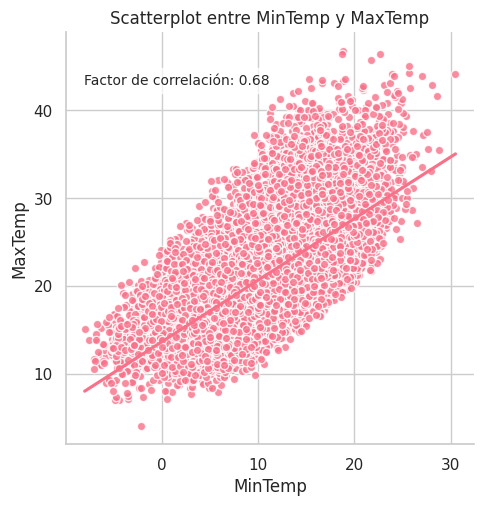

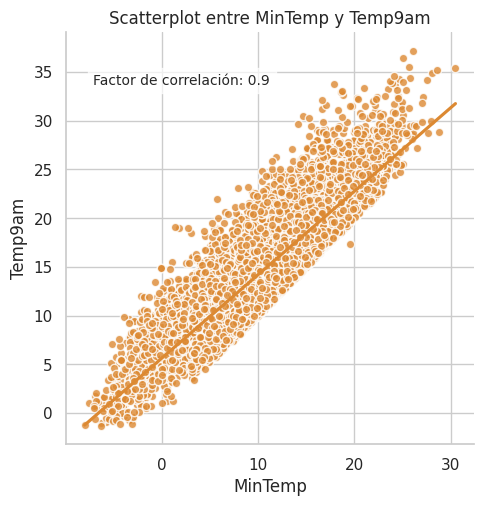

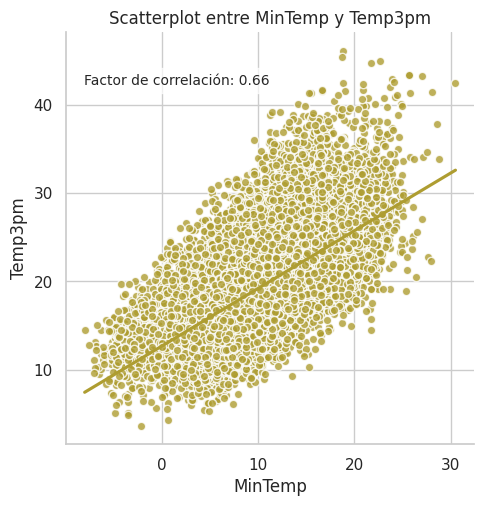

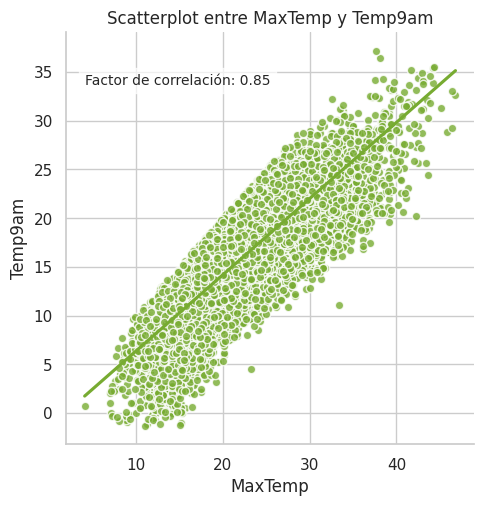

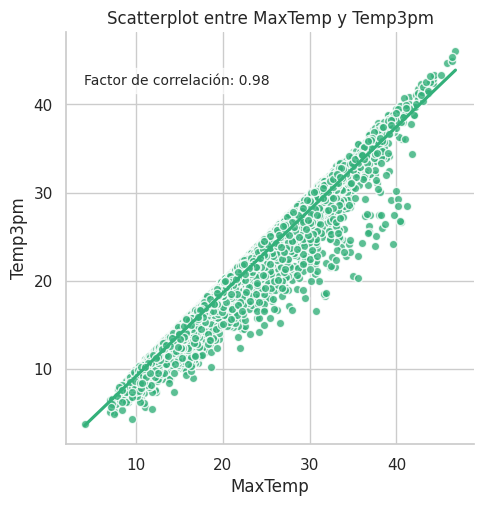

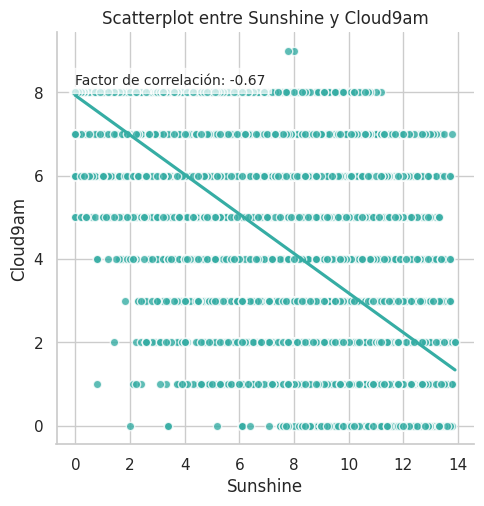

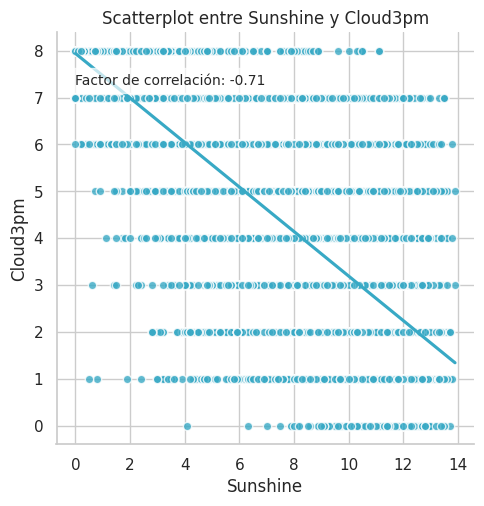

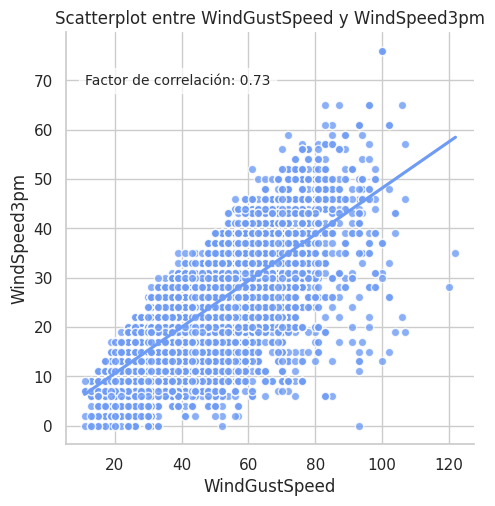

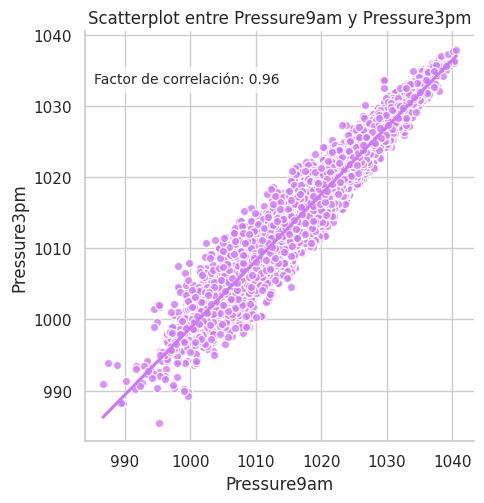

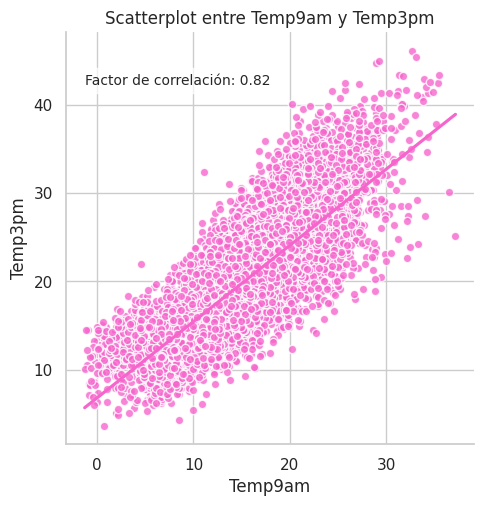

In [414]:
# Crea una figura para los gráficos
plt.figure(figsize=(12, 8))

# Itera a través de los pares de alta correlación
for i, (col1, col2, corr) in enumerate(high_corr_pairs):
    # Crea un gráfico de dispersión con regresión lineal
    sns.lmplot(data=weatherAUS_df, x=col1, y=col2, ci=None,
               scatter_kws={"color": sns.color_palette("husl", n_colors=len(high_corr_pairs))[i],
                            "edgecolor": "white"},
               line_kws={"color": sns.color_palette("husl", n_colors=len(high_corr_pairs))[i]})
    plt.title(f'Scatterplot entre {col1} y {col2}')
    plt.text(0.5, 0.9, f'Factor de correlación: {round(corr, 2)}', horizontalalignment='right', verticalalignment='top', transform=plt.gca().transAxes, fontsize=10, bbox=dict(facecolor='white', alpha=0.7))

# Muestra los gráficos
plt.show()

Al realizar los scatterplots se reconoce más claramente que algunas variables explicativas tienen un comportamiento lineal casi perfecto, mientras otras tienen mayor dispersión o es la distribución de los puntos hace menos claro imaginar una recta que los represente.

### 1.8 - Variables respuesta

#### 1.8.1 - Balance de Datos
A continuación se muestra la proporción de datos en las cuales la variable objetivo indican que llovió y las que no llovió.

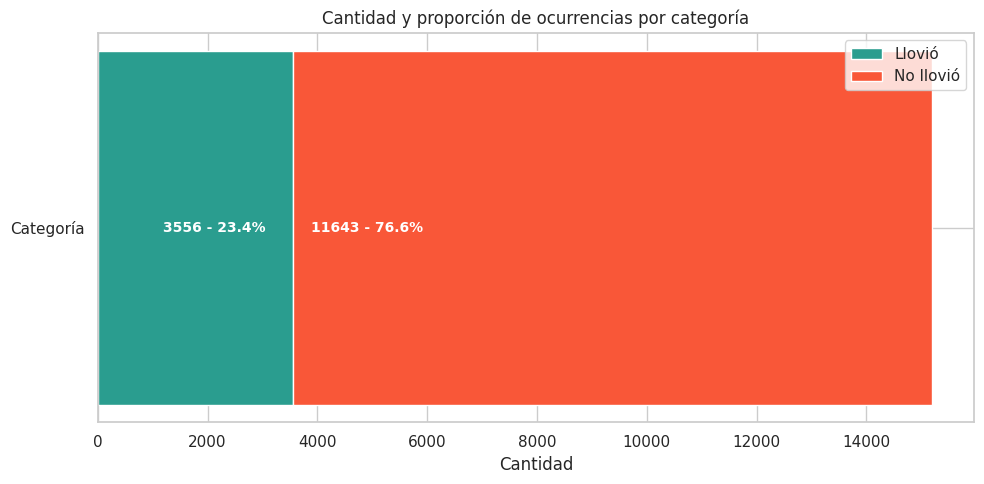

In [415]:
# Datos
rainfall_values = ['Llovió', 'No llovió']
llovio = weatherAUS_df[weatherAUS_df['RainTomorrow'] == 'Yes']['RainTomorrow'].count()
no_llovio = weatherAUS_df[weatherAUS_df['RainTomorrow'] == 'No']['RainTomorrow'].count()
total = llovio + no_llovio
amount = [llovio, no_llovio]
colors = ['#2a9d8f', '#f95738']

# Configuración de la figura
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

# Función para apilar
def apilar_amount(amount, index):
  if index == 0:
    return 0
  else:
    return sum(amount[:index])

for i, value in enumerate(rainfall_values):
   # Crear la barra
    bar = ax.barh('Categoría', amount[i], left=apilar_amount(amount, i), color=colors[i], label=value)

    # Añadir el valor de la barra
    for b in bar:
        width = b.get_width()
        plt.text(width/3, b.get_y() + b.get_height()/2, f'{amount[i]} - {round((amount[i]/total)*100, 2)}%', va='center', ha='left', fontsize=10, color='white', fontweight='bold')
        print()
    ax.set_title('Cantidad y proporción de ocurrencias por categoría')
    ax.set_xlabel('Cantidad')
    ax.legend()
# Mostrar gráfico
plt.tight_layout()
plt.show()

El dataset no está balanceado, teniendo un 76.6% de casos de no lluvia y 23.4% de casos de lluvia.

#### 1.8.2 - Relación de las variables explicativas respecto a la variable respuesta RainTomorrow

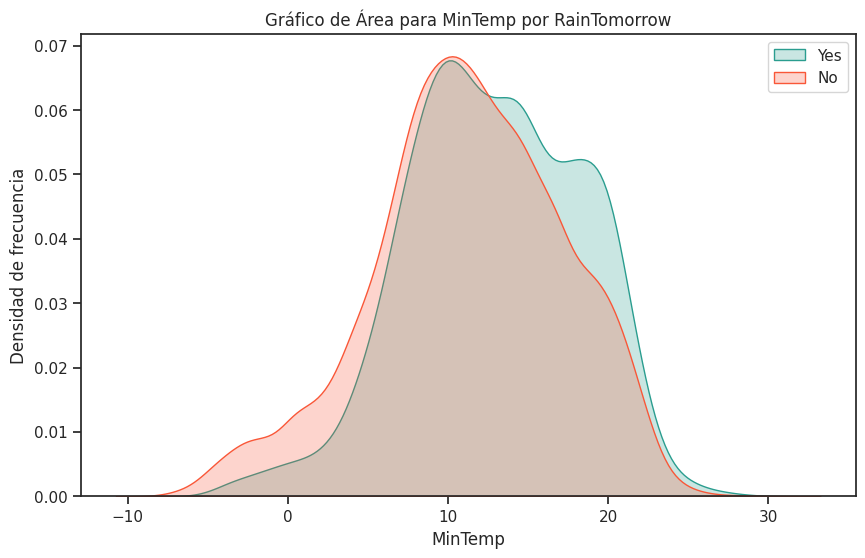

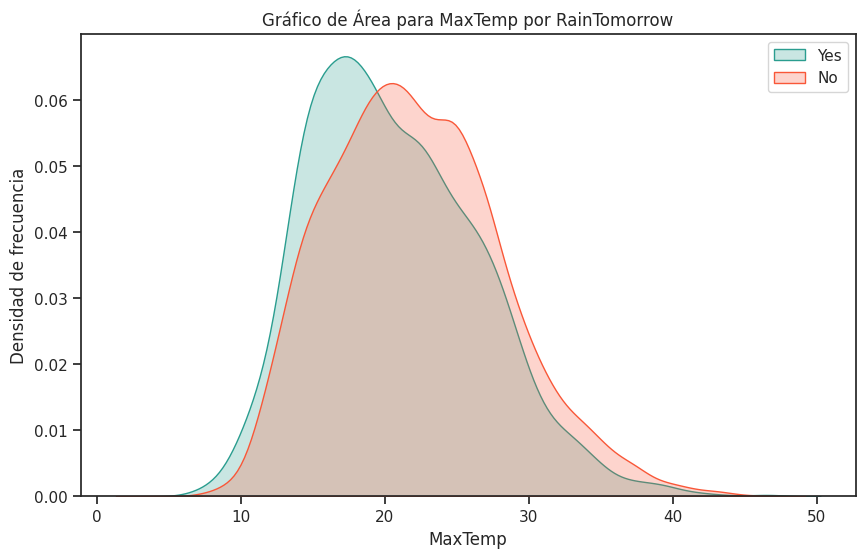

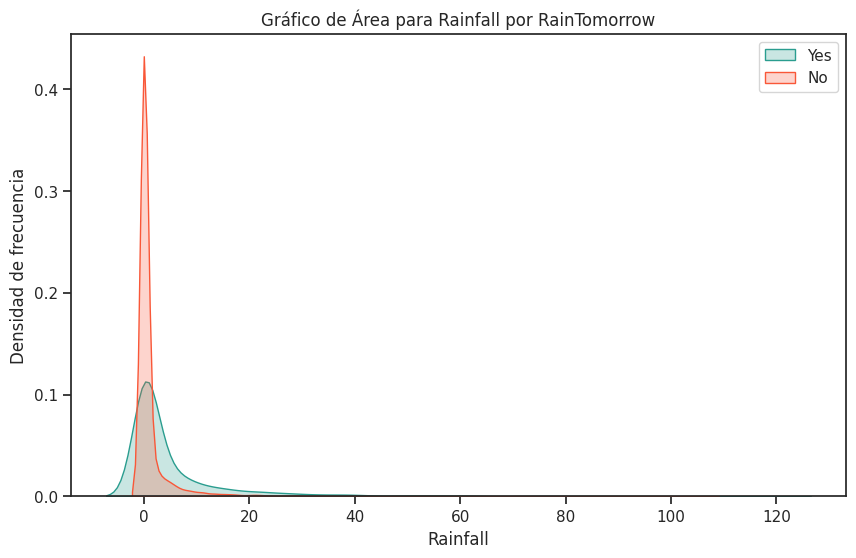

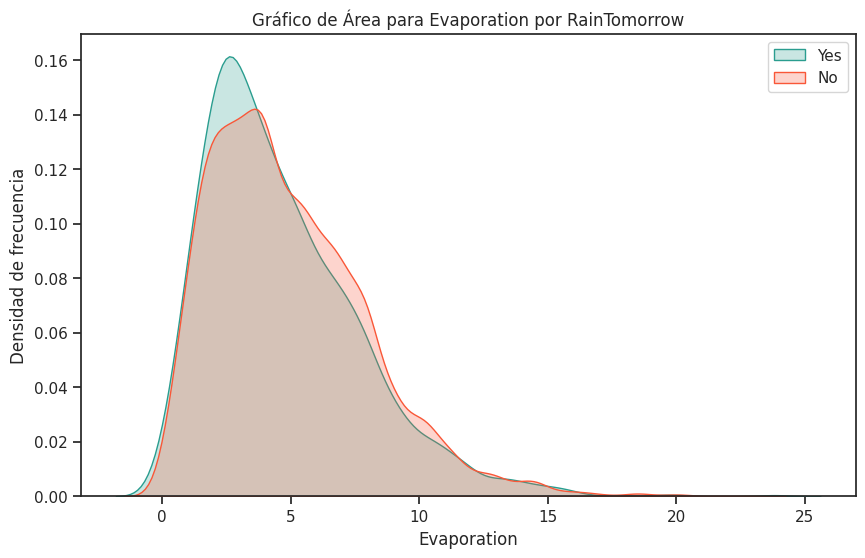

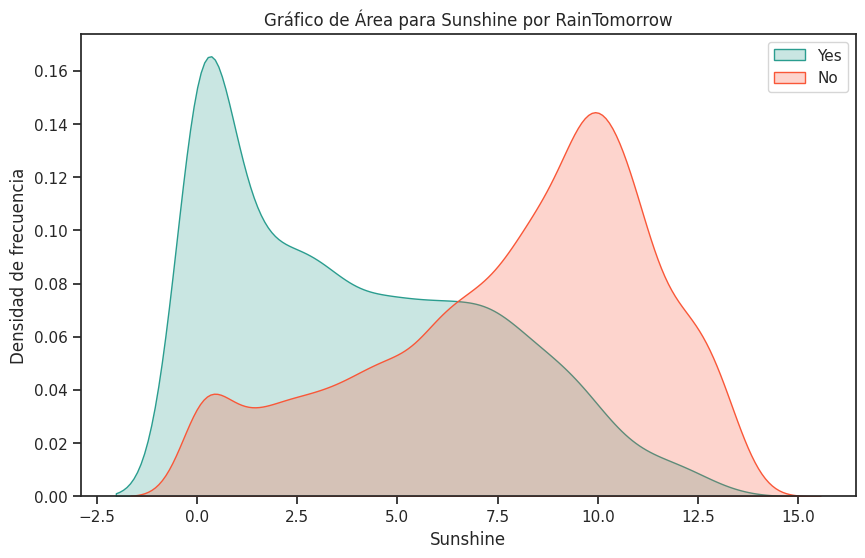

...

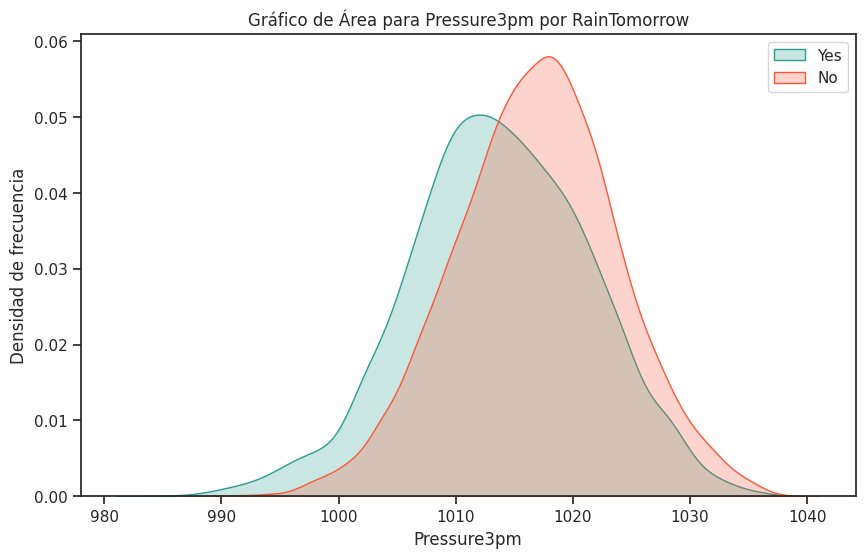

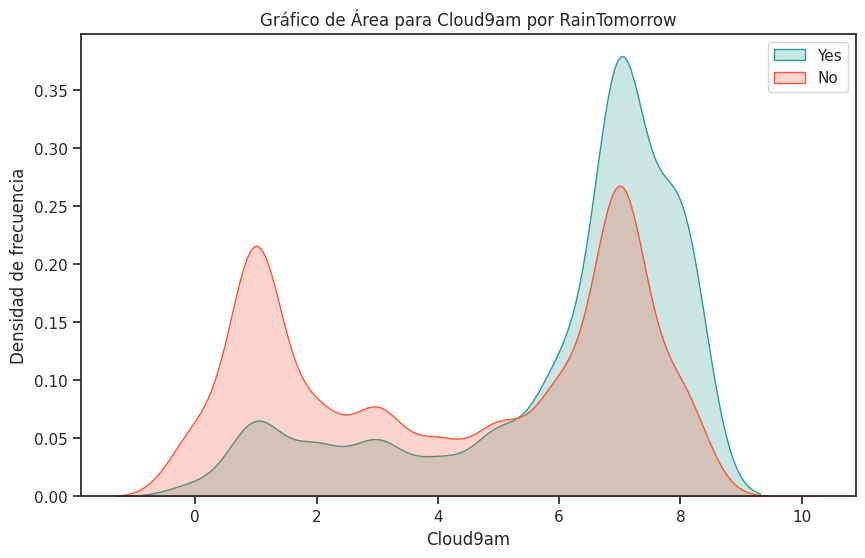

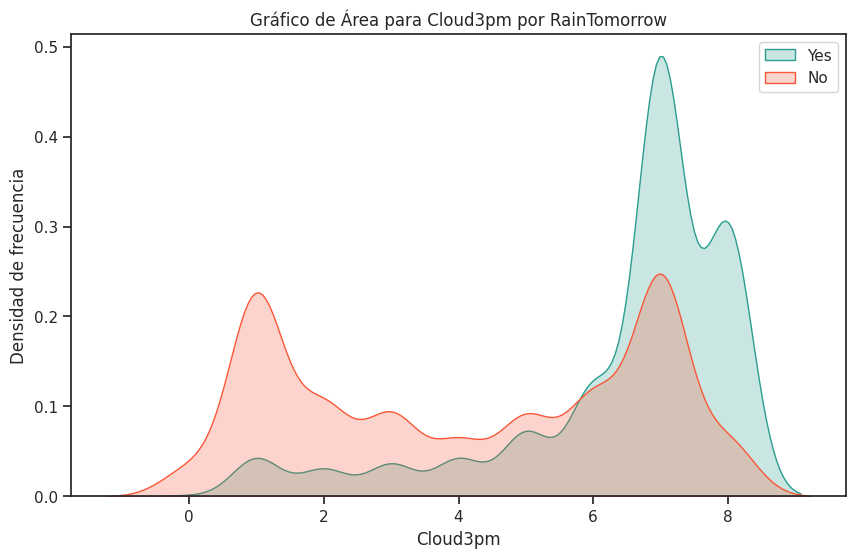

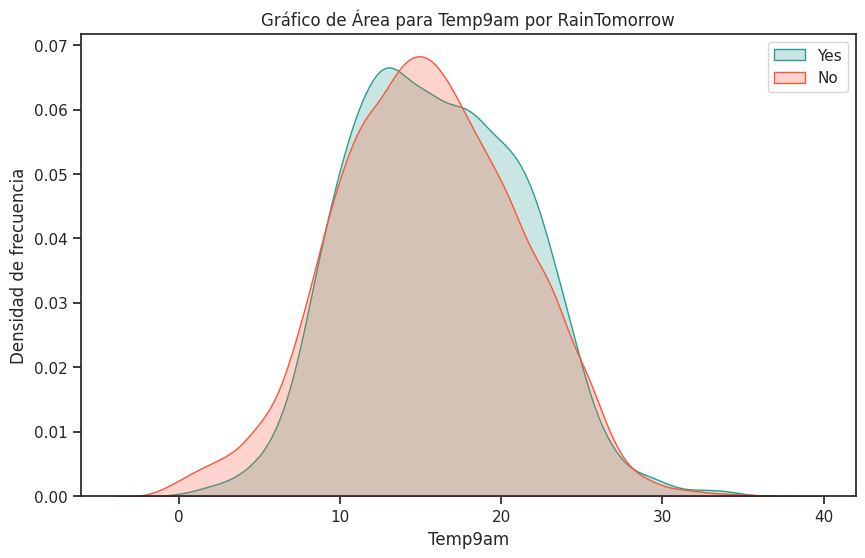

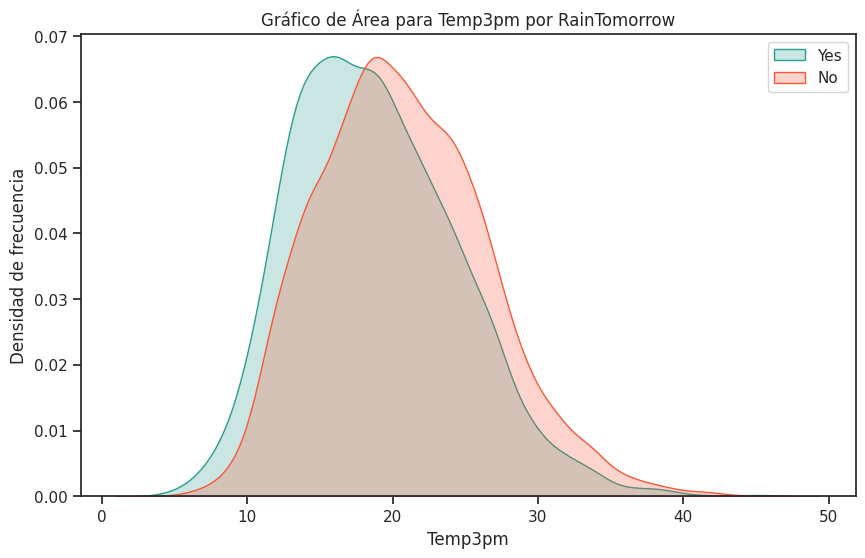

In [418]:
# Crear gráficos de área superpuestos para cada columna numérica
for column in numeric_columns:
    # Omitir la variable 'RainfallTomorrow' y 'RainTomorrow'
    if column == 'RainfallTomorrow' or column == 'RainTomorrow':
        continue

    plt.figure(figsize=(10, 6))

    # Convertir la columna al tipo de datos numérico
    numeric_column = pd.to_numeric(weatherAUS_df[column], errors='coerce')

    # Gráfico de área para "Yes"
    sns.kdeplot(data=numeric_column[weatherAUS_df['RainTomorrow'] == 'Yes'], label='Yes', shade=True, color='#2a9d8f')

    # Gráfico de área para "No"
    sns.kdeplot(data=numeric_column[weatherAUS_df['RainTomorrow'] == 'No'], label='No', shade=True, color='#f95738')

    plt.title(f'Gráfico de Área para {column} por RainTomorrow')
    plt.xlabel(column)
    plt.ylabel('Densidad de frecuencia')
    plt.legend()  # Agregar leyenda

    # Mostrar el gráfico
    plt.show()


Se observa que no hay una variable que permita distinguir claramente entre si llueve o no. Los gráficos para ambas opciones mayormente se enciman y comparten los valores del eje x.

#### 1.8.3 - Distribución de RainfallTomorrow

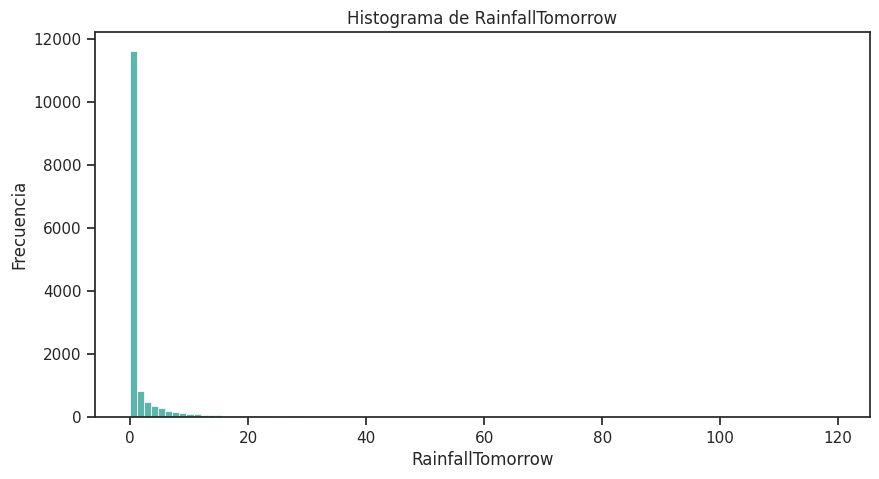

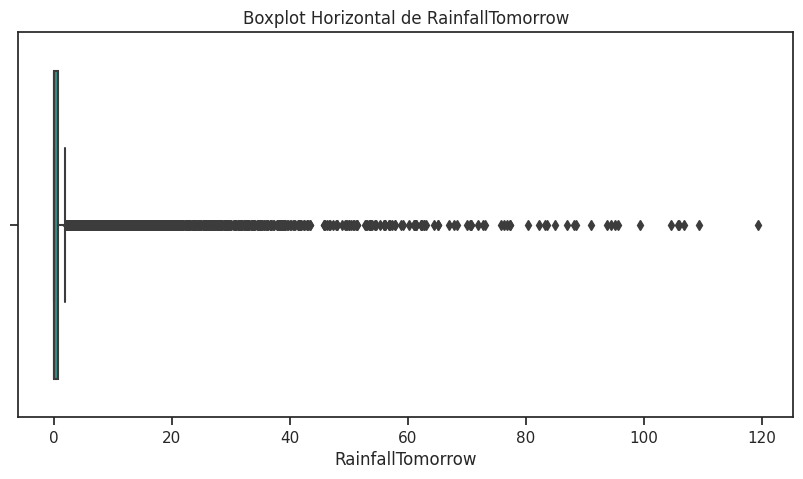

In [419]:
# Crear un histograma para la columna 'RainfallTomorrow'
plt.figure(figsize=(10, 5))
sns.histplot(data=weatherAUS_df, x='RainfallTomorrow', bins=100, color='#2a9d8f')
plt.title('Histograma de RainfallTomorrow')
plt.xlabel('RainfallTomorrow')
plt.ylabel('Frecuencia')

# Mostrar el histograma
plt.show()

# Crear un boxplot horizontal para la columna 'RainfallTomorrow'
plt.figure(figsize=(10, 5))
sns.boxplot(data=weatherAUS_df, x='RainfallTomorrow', color='#2a9d8f', orient='h')
plt.title('Boxplot Horizontal de RainfallTomorrow')
plt.xlabel('RainfallTomorrow')

# Mostrar el boxplot horizontal
plt.show()

El histograma muestra que la gran mayoría de los valores en mm son 0 o están muy cercanos a él. La asimetría en la distribución de los datos puede afectar la capacidad de un modelo de regresión lineal para hacer predicciones precisas. Si existen valores extremos o atípicos en la parte superior de la distribución, pueden tener una influencia desproporcionada en los coeficientes del modelo y aumentar el error cuadrático medio (MSE) del modelo.

#### 1.8.4 - Relación de las variables explicativas respecto a la variable objetivo RainfallTomorrow

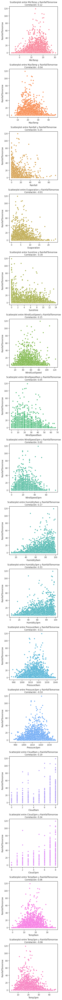

In [420]:
# Selecciona las columnas numéricas
numeric_columns = weatherAUS_df.select_dtypes(include=['float64'])

# Añade la columna 'RainfallTomorrow' al DataFrame de columnas numéricas
numeric_columns['RainfallTomorrow'] = weatherAUS_df['RainfallTomorrow']

# Elimina filas con valores NaN
numeric_columns = numeric_columns.dropna()

# Configura el número de subplots y el tamaño de la figura
num_plots = len(numeric_columns.columns) - 1  # Excluye la columna 'RainfallTomorrow'
fig, axes = plt.subplots(num_plots, 1, figsize=(5, num_plots * 5))

# Genera una paleta de colores con suficientes colores
colors = sns.color_palette("husl", num_plots)

# Crear un diccionario para almacenar las correlaciones
corr_RFT = {}

# Crea scatterplots para cada columna numérica con 'RainfallTomorrow'
for i, column in enumerate(numeric_columns.columns[:-1]):  # Excluye la columna 'RainfallTomorrow'
    ax = axes[i]

    # Calcula el coeficiente de correlación lineal
    corr_coefficient, _ = pearsonr(numeric_columns[column], numeric_columns['RainfallTomorrow'])

    corr_RFT[column] = corr_coefficient  # Guarda la correlación en el diccionario

    sns.scatterplot(data=numeric_columns, x=column, y='RainfallTomorrow', ax=ax, color=colors[i])
    ax.set_title(f'Scatterplot entre {column} y RainfallTomorrow\nCorrelación: {corr_coefficient:.2f}')
    ax.set_xlabel(column)
    ax.set_ylabel('RainfallTomorrow')

# Ajusta el espaciado entre subplots
plt.tight_layout()

# Muestra los scatterplots
plt.show()

Puede observarse que la mayor parte de las variables explicativas están débilmente correlacionadas con la variable objetivo. Cuando esto sucede es probable que un modelo de regresión lineal tenga dificultades para explicar las variaciones en la variable objetivo.

A continuación se muestran los coeficientes de correlación de Pearson entre las variables explicativas numéricas y la varaible objetivo.

#### 1.8.5 - Coeficiente de correlación de Pearson entre variables explicativas numéricas y variable objetivo.

In [421]:
# Imprime el diccionario de correlaciones
print("Correlaciones con RainfallTomorrow:")
for column, corr_coefficient in corr_RFT.items():
    print(f"{column}: {corr_coefficient:.2f}")

Correlaciones con RainfallTomorrow:
MinTemp: 0.12
MaxTemp: -0.04
Rainfall: 0.25
Evaporation: -0.01
Sunshine: -0.30
WindGustSpeed: 0.15
WindSpeed9am: 0.05
WindSpeed3pm: 0.02
Humidity9am: 0.17
Humidity3pm: 0.33
Pressure9am: -0.11
Pressure3pm: -0.10
Cloud9am: 0.19
Cloud3pm: 0.24
Temp9am: 0.06
Temp3pm: -0.06


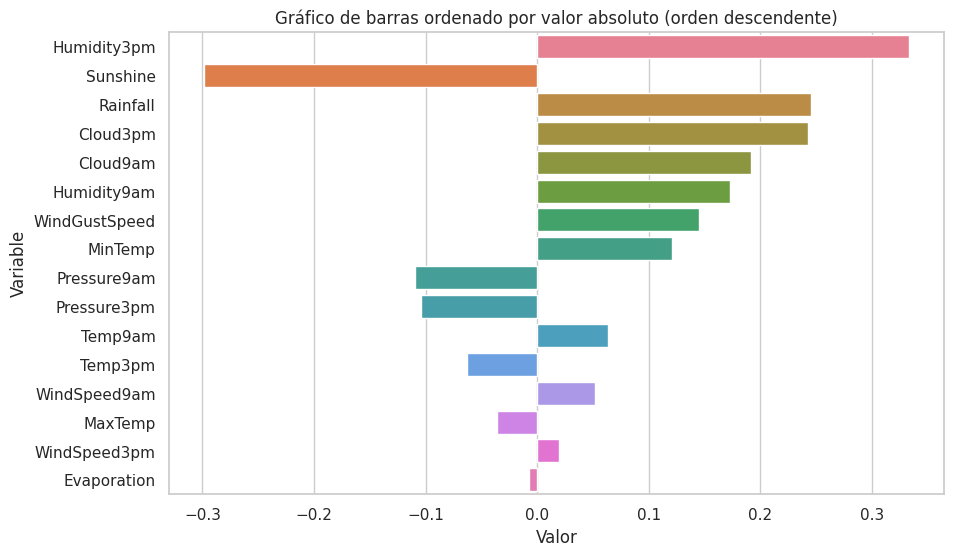

In [422]:
# Ordenar el diccionario por el valor absoluto en orden descendente
sorted_data = dict(sorted(corr_RFT.items(), key=lambda x: abs(x[1]), reverse=True))

# Extraer claves y valores ordenados
keys = list(sorted_data.keys())
values = list(sorted_data.values())

# Crear el gráfico de barras con Seaborn y la paleta de colores "husl"
sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
barplot = sns.barplot(x=values, y=keys, palette="husl")
plt.xlabel('Valor')
plt.ylabel('Variable')
plt.title('Gráfico de barras ordenado por valor absoluto (orden descendente)')
plt.show()

Las variables que mayor correlación lineal poseen con RainfallTomorrow son principalmente Humidity3pm y Sunshine. Para Humidity3pm el valor de RainfallTomorrow aumenta el aumentar la variable y para Sunshine el valor de RainfallTomorrow decrece al acumentar la variable. Aún así, el nivel de correlacipon es bajo en ambas.

## 2 - Procesamiento de datos

### 2.1 - Imputación de Datos

Cantidad de datos faltantes por columna

In [79]:
# Datos faltantes antes
missing_data = weatherAUS_df.isnull().sum()
print("Datos faltantes por columnas: ")
print(missing_data)

Datos faltantes por columnas: 
Date                   0
Location               0
MinTemp               10
MaxTemp                6
Rainfall             163
Evaporation         1694
Sunshine            1939
WindGustDir         1445
WindGustSpeed       1443
WindDir9am           678
WindDir3pm           289
WindSpeed9am         260
WindSpeed3pm         249
Humidity9am           88
Humidity3pm           45
Pressure9am          253
Pressure3pm          245
Cloud9am            2041
Cloud3pm            2282
Temp9am               24
Temp3pm               16
RainToday            163
RainTomorrow           0
RainfallTomorrow       0
dtype: int64


#### 2.1.1 - Modificar valores mayores a 8 en la columna Cloud9am

Cómo indica la descripción de la columna Cloud9am, en base a su unidad de medida (oktas) no puede superar el valor de 8. En el describe inicial se ha detectado que el valor máximo que posee es 9.

Se intuye que esto puede deberse a un error de tipeo al momento de cargar los datos. Aún así no hay seguridad de ello y, otra alternativa podría ser que usaran dicho valor como indicador de que no tienen el dato real. Por ejemplo: para la edad de una persona, si el dato no se obtuvo se podría indicar esto completando el registro con un número negativo, que no tiene sentido para la edad pero puede servir como representación de dato faltante. Esta última opción puede no ser muy viable ya que otros valores no conocidos se registran como NaN.

Se procederá entonces a cambiar a NaN los valores iguales a 9 para la columna Cloud9am y luego se utilizará K-Nearest Neighbors (K-NN) para completar los datos faltantes.

In [155]:
weatherAUS_df[weatherAUS_df['Cloud9am'] == 9]

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,RainfallTomorrow
30767,2009-09-23,Sydney,17.0,21.8,4.4,11.2,8.0,NaN,NaN,W,...,36.0,996.8,997.8,9.0,3.0,17.3,20.9,Yes,No,0.0
47212,2012-05-27,Canberra,0.6,14.5,0.0,NaN,7.8,SW,30.0,NNW,...,41.0,1022.4,1020.7,9.0,NaN,4.4,14.2,No,No,0.0


In [156]:
# Utilizar replace para cambiar el valor 9 por NaN
weatherAUS_df['Cloud9am'] = weatherAUS_df['Cloud9am'].replace(9, np.nan)

In [157]:
weatherAUS_df[weatherAUS_df['Cloud9am'] == 9]

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,RainfallTomorrow


#### 2.1.1 - Imputar columnas numéricas utilizando K-Nearest Neighbors (K-NN)


El método de imputación de KNN (K-Nearest Neighbors) de scikit-learn es una técnica de imputación que se basa en el principio de que los valores faltantes en un conjunto de datos pueden ser estimados utilizando los valores de los vecinos más cercanos en función de la distancia entre las observaciones

La función funciona de la siguiente manera:

1. Para cada valor faltante en el conjunto de datos, se encuentra la distancia entre esa observación y todas las demás observaciones en el conjunto de datos.

2. Se seleccionan las k (parámetro de la función)observaciones más cercanas (vecinos) a la observación con datos faltantes en función de la distancia calculada.

3. Se utiliza la información de los valores de las k observaciones vecinas para estimar el valor faltante. En scikit-learn, el método KNNImputer para imputación de valores faltantes utiliza el promedio ponderado de los k vecinos más cercanos para estimar el valor faltante.

4. El valor estimado se imputa en lugar del valor faltante en el conjunto de datos.

In [158]:
# Obtener columnas numéricas con datos faltantes
columnas_numericas_con_faltantes = list(weatherAUS_df.select_dtypes(include=['float64']).columns[weatherAUS_df.select_dtypes(include=['float64']).isnull().any()])

# Crea una instancia del imputador K-NN con el número deseado de vecinos (neighbors)
knn_imputer = KNNImputer(n_neighbors=5)

# Aplica el imputador a las columnas seleccionadas
weatherAUS_df[columnas_numericas_con_faltantes] = knn_imputer.fit_transform(weatherAUS_df[columnas_numericas_con_faltantes])

# Datos faltantes antes
missing_data = weatherAUS_df.isnull().sum()
print("Datos faltantes por columna luego de la imputación:")
print(missing_data)

Datos faltantes por columna luego de la imputación:
Date                   0
Location               0
MinTemp                0
MaxTemp                0
Rainfall               0
Evaporation            0
Sunshine               0
WindGustDir         1445
WindGustSpeed          0
WindDir9am           678
WindDir3pm           289
WindSpeed9am           0
WindSpeed3pm           0
Humidity9am            0
Humidity3pm            0
Pressure9am            0
Pressure3pm            0
Cloud9am               0
Cloud3pm               0
Temp9am                0
Temp3pm                0
RainToday            163
RainTomorrow           0
RainfallTomorrow       0
dtype: int64


#### 2.1.2 - Imputar datos de distintas horas de un mismo día
WinDir9am, WinDir3pm, son mediciones de la misma magnitud física pero a distintas horas del día. Teniendo en cuenta que no varían demasiado en un mismo día, se tomará como aproximación de que se mantienen constantes.

In [159]:
# Primero, reemplazamos los valores faltantes en 'WindDir9am' con los de 'WindDir3pm'
weatherAUS_df['WindDir9am'].fillna(weatherAUS_df['WindDir3pm'], inplace=True)

# Luego, reemplazamos los valores faltantes en 'WindDir3pm' con los de 'WindDir9am'
weatherAUS_df['WindDir3pm'].fillna(weatherAUS_df['WindDir9am'], inplace=True)

# Datos faltantes antes
missing_data = weatherAUS_df.isnull().sum()
print("Datos faltantes por columna luego de la imputación:")
print(missing_data)

Datos faltantes por columna luego de la imputación:
Date                   0
Location               0
MinTemp                0
MaxTemp                0
Rainfall               0
Evaporation            0
Sunshine               0
WindGustDir         1445
WindGustSpeed          0
WindDir9am           241
WindDir3pm           241
WindSpeed9am           0
WindSpeed3pm           0
Humidity9am            0
Humidity3pm            0
Pressure9am            0
Pressure3pm            0
Cloud9am               0
Cloud3pm               0
Temp9am                0
Temp3pm                0
RainToday            163
RainTomorrow           0
RainfallTomorrow       0
dtype: int64


#### 2.1.3 - Imputar máximos
Según la descripción de las columnas, hay magnitudes que son resumen de otros valores del mismo día.

WindGustDir es la dirección de la ráfaga de viento más fuerte en las 24 horas hasta la medianoche.

Por lo que si se cuentan con los datos en los demás datos de viento, pueden imputarse con un intervalo de certidumbre aceptable.


In [160]:
# Imputación de 'WindGustDir' y 'WindGustSpeed'
for index, row in weatherAUS_df.iterrows():
    if row['WindSpeed9am'] >= row['WindSpeed3pm']:
        weatherAUS_df.at[index, 'WindGustDir'] = row['WindDir9am']
    else:
        weatherAUS_df.at[index, 'WindGustDir'] = row['WindDir3pm']

# Datos faltantes luego de la imputación
missing_data = weatherAUS_df.isnull().sum()
print("Datos faltantes por columna luego de la imputación:")
print(missing_data)

Datos faltantes por columna luego de la imputación:
Date                  0
Location              0
MinTemp               0
MaxTemp               0
Rainfall              0
Evaporation           0
Sunshine              0
WindGustDir         241
WindGustSpeed         0
WindDir9am          241
WindDir3pm          241
WindSpeed9am          0
WindSpeed3pm          0
Humidity9am           0
Humidity3pm           0
Pressure9am           0
Pressure3pm           0
Cloud9am              0
Cloud3pm              0
Temp9am               0
Temp3pm               0
RainToday           163
RainTomorrow          0
RainfallTomorrow      0
dtype: int64


#### 2.1.6 - Imputar datos de RainToday
Ya que no hay datos faltantes en la columna Rainfall, se imputan los datos a RainToday utilizando el umbral para determinar si se considera o no lluvia con esta información.

In [161]:
variables_respuesta_ordenadas = weatherAUS_df[weatherAUS_df['RainToday'] == 'Yes'][['RainToday', 'Rainfall']].sort_values(by='Rainfall')

variables_respuesta_ordenadas

,RainToday,Rainfall
64343,Yes,1.2
31646,Yes,1.2
46551,Yes,1.2
64455,Yes,1.2
68961,Yes,1.2
...,...,...
32715,Yes,105.8
34318,Yes,106.0
35534,Yes,106.8
31634,Yes,109.4


Aquí puede verse que se considera lluvia a partir de 1.2 mm en la columna Rainfall. Luego se procede a imputar de la siguiente manera:

In [162]:
# Imputar los datos
weatherAUS_df['RainToday'] = weatherAUS_df.apply(lambda row: 'Yes' if row['Rainfall'] >= 1.2 else 'No' if pd.isna(row['RainToday']) else row['RainToday'], axis=1)

# Datos faltantes luego de la imputación
missing_data = weatherAUS_df.isnull().sum()
print("Datos faltantes por columna luego de la imputación:")
print(missing_data)

Datos faltantes por columna luego de la imputación:
Date                  0
Location              0
MinTemp               0
MaxTemp               0
Rainfall              0
Evaporation           0
Sunshine              0
WindGustDir         241
WindGustSpeed         0
WindDir9am          241
WindDir3pm          241
WindSpeed9am          0
WindSpeed3pm          0
Humidity9am           0
Humidity3pm           0
Pressure9am           0
Pressure3pm           0
Cloud9am              0
Cloud3pm              0
Temp9am               0
Temp3pm               0
RainToday             0
RainTomorrow          0
RainfallTomorrow      0
dtype: int64


2.1.7 - Datos faltantes luego de la imputación

In [163]:
# Obtener el mayor valor de valores faltantes por columna
max_missing_values = missing_data.max()

# Calcular el porcentaje en relación a la cantidad total de datos
total_data_points = weatherAUS_df.shape[0]
percentage_missing = (max_missing_values / total_data_points) * 100

print(f"El mayor valor de valores faltantes por columna es {max_missing_values}.")
print(f"La cantidad de registros total en el dataframe es {total_data_points }")
print(f"Representa aproximadamente el {percentage_missing:.2f}% de los datos totales.")

El mayor valor de valores faltantes por columna es 241.
La cantidad de registros total en el dataframe es 15199
Representa aproximadamente el 1.59% de los datos totales.


Los datos faltantes luego de las imputaciones representan el 1.59%, que es inferior al 5% aceptable, por lo que se procederá a eliminar los registros restantes con datos faltantes.

### 2.2 - Eliminación de datos que no fueron imputados.

In [164]:
# Elimina todos los registros con datos faltantes
df_copy = weatherAUS_df.dropna().copy()
weatherAUS_models = df_copy

# Datos faltantes luego de la imputación
missing_data = weatherAUS_models.isnull().sum()
print("Datos faltantes por columna luego de la eliminación:")
print(missing_data)

Datos faltantes por columna luego de la eliminación:
Date                0
Location            0
MinTemp             0
MaxTemp             0
Rainfall            0
Evaporation         0
Sunshine            0
WindGustDir         0
WindGustSpeed       0
WindDir9am          0
WindDir3pm          0
WindSpeed9am        0
WindSpeed3pm        0
Humidity9am         0
Humidity3pm         0
Pressure9am         0
Pressure3pm         0
Cloud9am            0
Cloud3pm            0
Temp9am             0
Temp3pm             0
RainToday           0
RainTomorrow        0
RainfallTomorrow    0
dtype: int64


### 2.3 - Codificación de variables categóricas

#### 2.3.1 - Codificar la fecha
La zona de estudio es el sur de Australia, como en todas las geografías, allí hay meses húmedos y secos. Teniendo esto en cuenta se creará una nueva variable llamada "wet_month" y tendrá el valor de 1 si la fecha corresponde a la temporada húmeda (de Mayo a Octubre) y 0 si no lo hace. Luego se eliminará la variable "Date".

In [165]:
# Convertir la columna 'Date' a formato datetime
weatherAUS_models['Date'] = pd.to_datetime(weatherAUS_models['Date'])

# Definir una función para codificar los meses
def codificar_mes(mes):
    if 5 <= mes.month <= 10:
        return 1
    else:
        return 0

# Aplicar la función a la columna 'Date' y crear una nueva columna 'wet_month'
weatherAUS_models['wet_month'] = weatherAUS_models['Date'].apply(codificar_mes)

# Eliminar la columna 'Date' original que ya no se necesita
weatherAUS_models.drop(columns=['Date'], inplace=True)

# Cantidad de características (columnas) y datos (filas) en weatherAUS_models
num_features_LR = len(weatherAUS_models.columns)

print("Para weatherAUS_models:")
print(f"Cantidad de características (LR): {num_features_LR}")

Para weatherAUS_models:
Cantidad de características (LR): 24


#### 2.3.2 - Codificar las demás variables categóricas.

In [166]:
# Columnas que se desea codificar
columns_to_encode = ['WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday','RainTomorrow', 'Location']

# Aplica one-hot encoding con drop_first=True
weatherAUS_models = pd.get_dummies(weatherAUS_models, columns=columns_to_encode, drop_first=True)

# Cantidad de características (columnas) y datos (filas) en weatherAUS_models
num_features = len(weatherAUS_models.columns)

print("Para weatherAUS_models:")
print(f"Cantidad de características: {num_features}")

Para weatherAUS_models:
Cantidad de características: 69


## 3 - Método LinearRegression

### 3.1 - Dataframes para LinearRegression
Eliminamos las columnas que son las clases para problemas de clasificación.

In [167]:
# Crear weatherAUS_LR sin la columna 'RainTomorrow_Yes'
weatherAUS_LR = weatherAUS_models.drop(columns=['RainTomorrow_Yes']).copy()

### 3.2 - Modelos base para la regresión

Los modelos base son modelos simples que se utilizan para establecer un estándar inicial en términos de rendimiento. Los algoritmos de ML desarrollados deben superar las métricas de estos modelos base para considerarse efectivos.

A continuación se presentarán modelos base para regresión con la correspondiente evaluación de rendimiento, que será la referencia a superar en futuros modelos más complejos.

#### 3.2.1 - Modelo base Regresión Lineal Simple

Se utiliza una única característica para realizar la regresión. La característica seleccionada en este caso es Humidity3pm ya que se ha observado en la matriz de correlación que es la que tiene el mayor valor con respecto a la variable objetivo RainfallTomorrow.

In [93]:
# Seleccionar la característica y la variable objetivo
feature = 'Humidity3pm'
target = 'RainfallTomorrow'

# Filtrar filas con valores no nulos en las columnas seleccionadas
weatherAUS_LR_aux = weatherAUS_LR[[feature, target]]

# Dividir el conjunto de datos en conjuntos de entrenamiento y prueba
X_train_base, X_test_base, y_train_base, y_test_base = train_test_split(weatherAUS_LR_aux[[feature]], weatherAUS_LR_aux[target], test_size=0.2, random_state=7)

# Crear y entrenar el modelo de regresión lineal
model_base = LinearRegression()
model_base.fit(X_train_base, y_train_base)

# Realizar predicciones en el conjunto de prueba
y_pred_base = model_base.predict(X_test_base)

# Evaluar el rendimiento del modelo base
mse_base = mean_squared_error(y_test_base, y_pred_base)
rmse_base = np.sqrt(mse_base)

# Número de observaciones
n_base = len(y_test_base)

# Número de características (predictores)
p_base = X_test_base.shape[1]

# Calcular el R2
r2_base = r2_score(y_test_base, y_pred_base)

# Calcular el R2 ajustado
adjusted_r2_base = 1 - (1 - r2_base) * (n_base - 1) / (n_base - p_base - 1)

# Imprimir las métricas en la consola
print(f"R2 Ajustado: {adjusted_r2_base:.4f}")
print(f'Mean Squared Error (MSE_base): {mse_base:.2f}')
print(f'Root Mean Squared Error (RMSE_base): {rmse_base:.2f}')

# Coeficientes del modelo
print(f'Coeficiente (pendiente): {model_base.coef_[0]:.2f}')
print(f'Intercepto: {model_base.intercept_:.2f}')

R2 Ajustado: 0.1245
Mean Squared Error (MSE_base): 51.22
Root Mean Squared Error (RMSE_base): 7.16
Coeficiente (pendiente): 0.14
Intercepto: -5.14


#### 3.2.2 - Predicción de la Media

In [94]:
train_df, test_df = train_test_split(weatherAUS_LR_aux, test_size=0.2, random_state=42)

# Calcular la media de la variable objetivo
media_valor_objetivo = train_df[target].mean()

# Crear una serie con la media repetida para la longitud del conjunto de datos
prediccion_media = pd.Series([media_valor_objetivo] * len(test_df))

# Evaluar el rendimiento del modelo base de predicción de la media
mse_media = mean_squared_error(test_df[target], prediccion_media)
rmse_media = np.sqrt(mse_media)

print(f'Mean Squared Error (MSE) - Predicción de la Media: {mse_media:.2f}')
print(f'Root Mean Squared Error (RMSE) - Predicción de la Media: {rmse_media:.2f}')

Mean Squared Error (MSE) - Predicción de la Media: 68.72
Root Mean Squared Error (RMSE) - Predicción de la Media: 8.29


#### 3.2.3 - Predicción de la Mediana

In [95]:
# Calcular la mediana de la variable objetivo
mediana_valor_objetivo = train_df[target].median()

# Crear una serie con la mediana repetida para la longitud del conjunto de datos
prediccion_mediana = pd.Series([mediana_valor_objetivo] * len(test_df))

# Evaluar el rendimiento del modelo base de predicción de la mediana
mse_mediana = mean_squared_error(test_df[target], prediccion_mediana)
rmse_mediana = np.sqrt(mse_mediana)

print(f'Mean Squared Error (MSE) - Predicción de la Mediana: {mse_mediana:.2f}')
print(f'Root Mean Squared Error (RMSE) - Predicción de la Mediana: {rmse_mediana:.2f}')

Mean Squared Error (MSE) - Predicción de la Mediana: 74.80
Root Mean Squared Error (RMSE) - Predicción de la Mediana: 8.65


Se observa que el modelo base de la regresión lineal simple es el que menor error de predicción presenta en relación a los modelos base de la media y la mediana. Por lo tanto, es el que se utilizará como referencia frente a futuros modelos más complejos.

### 3.2 - División en conjuntos de entrenamiento y de prueba

In [192]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(weatherAUS_LR.drop('RainfallTomorrow', axis=1),
                                                   weatherAUS_LR['RainfallTomorrow'].values.reshape(-1, 1),
                                                   test_size=0.2,
                                                   random_state=7)
X_train_reg = X_train.copy()
X_test_reg = X_test.copy()
y_train_reg = y_train.copy()
y_test_reg = y_test.copy()

### 3.3 - Estandarización

In [169]:
# Estandarizar las características
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

### 3.4 - Regresión

Se utilizará validación cruzada para estimar el rendimiento del modelo.

Se define una función para hallar los parámetros del modelo de regresión resultandte de la validación cruzada.

In [170]:
def hallar_parametros_regresion(X_train_actual, kfold, linear_r):
  # Lista para almacenar los coeficientes de cada iteración
  coefficients = []
  intercepts = []
  scores = []

  # Realizar cross-validation y almacenar coeficientes
  for train_index, test_index in kfold.split(X_train_actual):
      X_train_fold, X_val = X_train_actual[train_index], X_train_actual[test_index]
      y_train_fold, y_val = y_train[train_index], y_train[test_index]

      # Entrenar el modelo en el conjunto de entrenamiento y obtener los coeficientes
      linear_r.fit(X_train_fold, y_train_fold)
      coeficientes_fold = linear_r.coef_
      intercepto_fold = linear_r.intercept_
      pred = linear_r.predict(X_val)
      score = r2_score(y_val, pred)
      # Almacenar los coeficientes en la lista
      coefficients.append(coeficientes_fold)
      intercepts.append(intercepto_fold)
      scores.append(score)

  # Calcular el promedio de los coeficientes
  coeficientes_promedio = np.mean(coefficients, axis=0)
  intercepts_promedio = sum(intercepts) / len(intercepts)
  score_promedio_cv = sum(scores) / len(scores)

  return coeficientes_promedio, intercepts_promedio, score_promedio_cv

In [171]:
def plot_real_vs_predicted(predicted_values):
  # Plot real values vs predicted values
  fig, axs = plt.subplots(ncols=2, figsize=(8, 4))
  PredictionErrorDisplay.from_predictions(
      y_test,
      y_pred=predicted_values,
      kind="actual_vs_predicted",
      subsample=100,
      ax=axs[0],
      random_state=0,
  )
  axs[0].set_title("Valores reales vs predichos")
  PredictionErrorDisplay.from_predictions(
      y_test,
      y_pred=predicted_values,
      kind="residual_vs_predicted",
      subsample=100,
      ax=axs[1],
      random_state=0,
  )
  axs[1].set_title("Residuos vs valores predichos")
  fig.suptitle("Valores reales de test vs valores predichos con parámetros de validación cruzada")
  plt.tight_layout()
  plt.show()

In [172]:
# Inicializar el modelo
lr = LinearRegression(fit_intercept=True)

# Inicializar KFold con 5 folds
kf = KFold(n_splits=5, shuffle=True)

#### 3.4.1 - Realizar la regresión

In [173]:
# Configurar el formato de impresión con 4 cifras significativas
np.set_printoptions(precision=4, suppress=True)

# Imprimir los coeficientes y el intercepto
c_p, i_p, s_p_cv = hallar_parametros_regresion(X_train_scaled, kf, lr)
print("Coeficientes:")
print(c_p[0])
print("\nIntercepto:")
print(f'{i_p[0]:.2f}')
print("\nScore promedio validación cruzada:")
print(f'{s_p_cv:.2f}')

Coeficientes:
[-1.1599  1.0466  1.1259  0.0807 -1.1529  1.9196 -0.0157 -0.7285 -0.1112
  2.5328  2.6906 -2.7685 -0.2892  0.145   0.0389  0.3009 -0.2813  0.3187
  0.2823  0.3003 -0.0713  0.1911  0.2204  0.1179  0.1182  0.3809  0.4393
  0.2581  0.1757  0.228   0.1003  0.1634  0.0047 -0.0778 -0.4668  0.0099
 -0.1122 -0.3825 -0.3178 -0.0948 -0.0184 -0.1309 -0.1623 -0.1468 -0.2877
 -0.2733 -0.0984 -0.193   0.0139 -0.0799  0.0473 -0.0707  0.0362  0.0055
  0.0986 -0.0222 -0.0539  0.1014  0.0794  0.1951  0.1792  0.075   0.1687
 -0.0026 -0.2992  0.4782  0.3034]

Intercepto:
2.28

Score promedio validación cruzada:
0.22


#### 3.4.2 - Grafico de la magnitud de los coeficientes

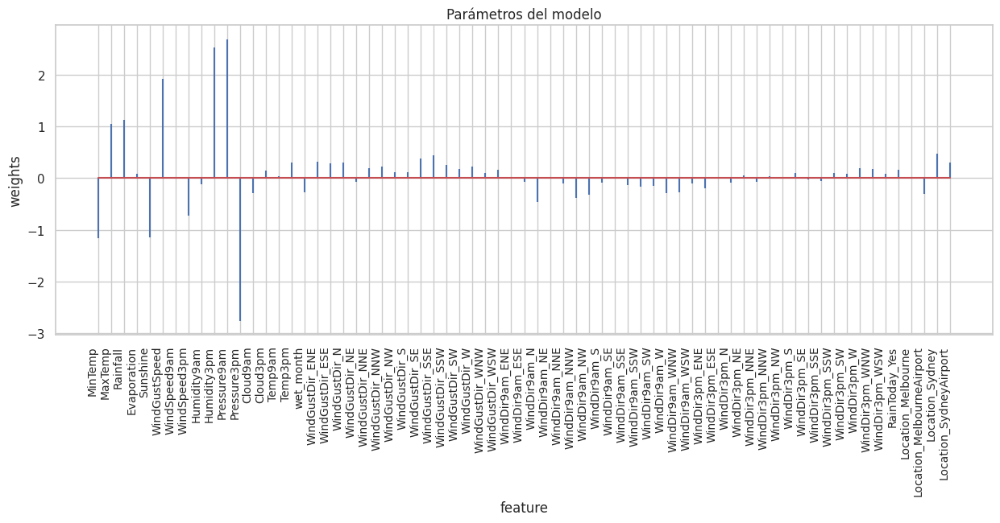

In [102]:
# Coeficientes del modelo
df_coeficientes = pd.DataFrame({'predictor': X_train.columns, 'coef': c_p.flatten()})

# Crear un gráfico de barras para mostrar los coeficientes
fig, ax = plt.subplots(figsize=(15, 5))
ax.stem(df_coeficientes.predictor, df_coeficientes.coef, markerfmt=' ')
plt.xticks(rotation=90, ha='right', size=10)
ax.set_xlabel('feature')
ax.set_ylabel('weights')
ax.set_title('Parámetros del modelo')
plt.show()

#### 3.4.3 - Metricas
A continuación se calculan las métricas de la regresión.

1. **R2 Ajustado**: El coeficiente de determinación ajustado, o R2 ajustado, es una métrica que evalúa la calidad de un modelo de regresión.
Es similar al R2, pero tiene en cuenta el número de características (predictores) en el modelo.
Proporciona una medida de cuánta variabilidad en la variable objetivo (variable dependiente) se explica por el modelo, ajustado por el número de características.
Cuanto más cercano a 1, mejor es el modelo.

2. **Mean Squared Error (MSE)**: El Error Cuadrático Medio (MSE) es una métrica que mide la magnitud promedio de los errores entre las predicciones de un modelo y los valores reales en el conjunto de datos.
Calcula la diferencia cuadrada entre las predicciones y los valores reales para cada punto de datos y luego toma el promedio de esas diferencias al cuadrado.
Cuanto menor sea el MSE, mejor será el ajuste del modelo a los datos. MSE penaliza de manera más severa los errores grandes.

3. **Root Mean Squared Error (RMSE)**: El Error Cuadrático Medio de la Raíz (RMSE) es una métrica relacionada con el MSE, pero se expresa en la misma unidad que la variable objetivo.
Es la raíz cuadrada del MSE y proporciona una medida de dispersión de los errores en la misma escala que la variable objetivo.
Al igual que el MSE, cuanto menor sea el RMSE, mejor será el ajuste del modelo.

In [174]:
def obtener_metricas_y_predicciones(c_prom, i_prom, X_test_scaled_actual, y_test_actual, l_reg):
  modelo_regresion_promedio = l_reg
  modelo_regresion_promedio.coef_ = c_prom
  modelo_regresion_promedio.intercept_ = i_prom

  # Realizar predicciones en el conjunto de prueba
  predicciones_test = modelo_regresion_promedio.predict(X_test_scaled_actual)

  # Número de observaciones
  n = len(y_test_actual)

  # Número de características (predictores)
  p = X_test_scaled_actual.shape[1]

  # Calcular el R2
  r2 = r2_score(y_test_actual, predicciones_test)

  # Calcular el MSE
  mse = mean_squared_error(y_test_actual, predicciones_test)

  # Calcular el RMSE
  rmse = np.sqrt(mse)

  # Calcular el R2 ajustado
  adjusted_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)

  return adjusted_r2, mse, rmse, predicciones_test


In [175]:
adjusted_r2, mse_inicial, rmse, pred_test = obtener_metricas_y_predicciones(c_p, i_p, X_test_scaled, y_test, lr)
print(f"R2 Ajustado: {adjusted_r2:.4f}")
print(f"Mean Squared Error (MSE): {mse_inicial:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")

R2 Ajustado: 0.2368
Mean Squared Error (MSE): 43.6704
Root Mean Squared Error (RMSE): 6.6084


#### 3.4.4 - Gráfico de predicciones sobre el conjunto de prueba vs los valores reales.

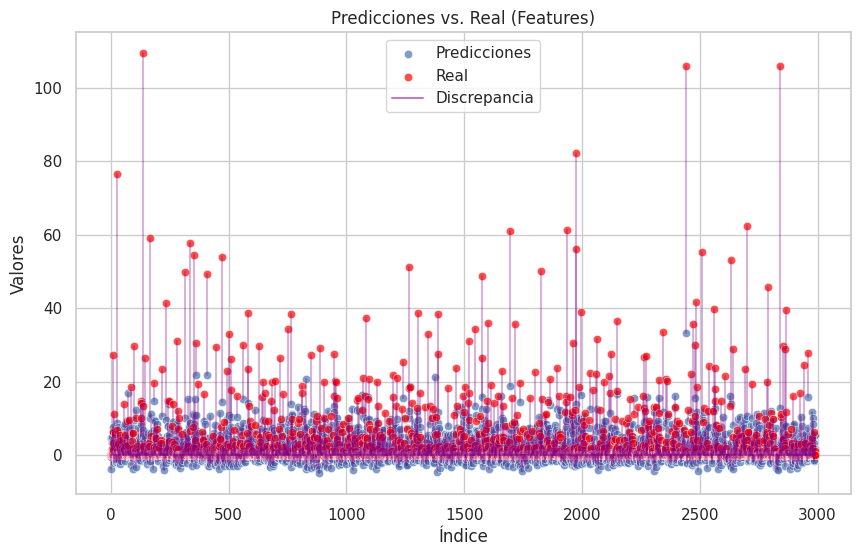

In [105]:
x = np.arange(len(y_test))
y = pred_test.ravel()  # Convierte a un arreglo 1D

plt.figure(figsize=(10, 6))
sns.scatterplot(x=x, y=y, alpha=0.7, label='Predicciones')
sns.scatterplot(x=x, y=y_test.ravel(), alpha=0.7, color='red', label='Real')

# Unir los puntos con una línea púrpura
for i in range(len(x)):
    plt.plot([x[i], x[i]], [y[i], y_test.ravel()[i]], color='purple', alpha=0.3)

plt.title("Predicciones vs. Real (Features)")
plt.xlabel("Índice")
plt.ylabel("Valores")

# Agregar una sola línea púrpura a la leyenda con la etiqueta "Discrepancia"
plt.plot([], [], color='purple', alpha=0.5, label='Discrepancia')

plt.legend()
plt.show()

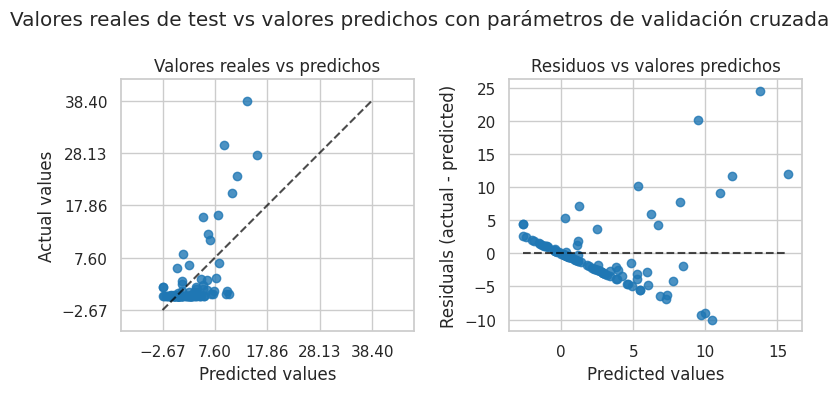

In [106]:
plot_real_vs_predicted(pred_test)

### 3.5 - Otros intentos
Al ver el pobre desempeño del primer intento se hicieron otras pruebas.

#### 3.5.1 - Eliminar outliers en variable objetivo

En el gráfico 3.4.4 puede verse que el modelo es malo para predecir valores de lluvia muy altos. Y  MSE penaliza de manera más severa los errores grandes. Teniendo en cuenta que en el conjunto de test sólo unos 25 valores de 3000 (0,83%) superan los 40 mm, se entrenará un modelo sin los outliers y se evaluará la nueva regresión.


In [107]:
weatherAUS_outliers = weatherAUS_LR[weatherAUS_LR['RainfallTomorrow'] <= 40].copy()


datos_elim_out = round((100-weatherAUS_outliers.shape[0]*100/weatherAUS_df.shape[0]),2)
print('Porcentaje de datos eliminados',datos_elim_out, '%')

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_out, X_test_out, y_train_out, y_test_out = train_test_split(weatherAUS_outliers.drop('RainfallTomorrow', axis=1),
                                             weatherAUS_outliers['RainfallTomorrow'].values.reshape(-1,1),
                                             test_size=0.2,
                                             random_state=42,
                                             )

# Estandarizar las características
scaler = StandardScaler()
X_train_out_scaled=scaler.fit_transform(X_train_out)
X_test_out_scaled=scaler.transform(X_test_out)

# Crear un modelo de regresión lineal
linear_regression_out = LinearRegression(fit_intercept=True)

# Inicializar KFold con 5 folds
kf_out = KFold(n_splits=5, shuffle=True, random_state=42)

Porcentaje de datos eliminados 2.35 %


In [108]:
# Configurar el formato de impresión con 4 cifras significativas
np.set_printoptions(precision=4, suppress=True)

# Imprimir los coeficientes y el intercepto
c_p_out, i_p_out, s_p_cv = hallar_parametros_regresion(X_train_out_scaled, kf_out, linear_regression_out)
print("Coeficientes:")
print(c_p_out[0])
print("\nIntercepto:")
print(f'{i_p_out[0]:.2f}')
print("\nScore promedio validación cruzada:")
print(f'{s_p_cv:.2f}')

Coeficientes:
[-0.0598  0.1549 -0.083  -0.0289  0.1716  0.1077 -0.0173 -0.0062  0.0795
  0.0561 -0.0661  0.0246  0.0091  0.1546 -0.0199 -0.2651 -0.0481 -0.2662
 -0.1475 -0.1896 -0.0662  0.0037  0.0645 -0.0209 -0.1303 -0.071  -0.2407
  0.1609 -0.1486 -0.0507 -0.0401  0.0333  0.024   0.0352  0.1437  0.0944
  0.0174  0.0019  0.1838  0.0482  0.1513  0.1572  0.0929  0.0392  0.0714
  0.1247  0.0188 -0.0168 -0.1413 -0.1761 -0.1492 -0.0767 -0.2912 -0.2632
 -0.2532 -0.2482 -0.141  -0.2381 -0.0948 -0.255  -0.2771 -0.3533 -0.0417
  0.2188  0.1709  0.2927  0.1609]

Intercepto:
2.28

Score promedio validación cruzada:
-0.01


In [109]:
adjusted_r2_out, mse_out, rmse_out, pred_test_out = obtener_metricas_y_predicciones(c_p_out, i_p_out, X_test_out_scaled, y_test_out, linear_regression_out)
# Imprimir las métricas en la consola
print(f"R2 Ajustado: {adjusted_r2_out:.4f}")
print(f"Mean Squared Error (MSE): {mse_out:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse_out:.4f}")

R2 Ajustado: -0.0379
Mean Squared Error (MSE): 22.7484
Root Mean Squared Error (RMSE): 4.7695


Puede observarse que este modelo tiene un R2 ajustado inferior, lo que significa que la capacidad de este modelo para explicar la variabilidad de la variable objetivo es peor, pero erra menos al predecir los valores reales.

#### 3.5.2 - Seleccionar las variables que parecen ser más explicativas.

En el gráfico 3.4.2 puede verse que muchas de los coeficientes son muy bajos por lo que se podría probar dejando sólo los más explicativos.

In [110]:
# Seleccionar variables con mayor parámetro en el primer ajuste
selected_columns = ['Pressure3pm', 'Pressure9am', 'Humidity3pm', 'WindGustSpeed', 'Rainfall', 'MaxTemp', 'MinTemp', 'RainfallTomorrow']
weatherAUS_selected = weatherAUS_LR[selected_columns].copy()

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_selected, X_test_selected, y_train_selected, y_test_selected = train_test_split(weatherAUS_selected.drop('RainfallTomorrow', axis=1),
                                             weatherAUS_selected['RainfallTomorrow'].values.reshape(-1,1),
                                             test_size=0.2,
                                             random_state=7,
                                             )

# Estandarizar las características
scaler = StandardScaler()
X_train_selected_scaled=scaler.fit_transform(X_train_selected)
X_test_selected_scaled=scaler.transform(X_test_selected)

# Crear un modelo de regresión lineal
linear_regression_selected = LinearRegression(fit_intercept=True)

# Inicializar KFold con 5 folds
kf_selected = KFold(n_splits=5, shuffle=True, random_state=42)

In [111]:
# Configurar el formato de impresión con 4 cifras significativas
np.set_printoptions(precision=4, suppress=True)

# Imprimir los coeficientes y el intercepto
c_p_selected, i_p_selected, s_p_cv = hallar_parametros_regresion(X_train_selected_scaled, kf_selected, linear_regression_selected)
print("Coeficientes:")
print(c_p_selected[0])
print("\nIntercepto:")
print(f'{i_p_selected[0]:.2f}')
print("\nScore promedio validación cruzada:")
print(f'{s_p_cv:.2f}')

Coeficientes:
[-2.3521  2.2029  2.9334  1.2526  1.3629  0.9408 -0.4748]

Intercepto:
2.28

Score promedio validación cruzada:
0.20


In [112]:
adjusted_r2_selected, mse_selected, rmse_selected, pred_test_selected = obtener_metricas_y_predicciones(c_p_selected, i_p_selected, X_test_selected_scaled, y_test_selected, linear_regression_selected)
# Imprimir las métricas en la consola
print(f"R2 Ajustado: {adjusted_r2_selected:.4f}")
print(f"Mean Squared Error (MSE): {mse_selected:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse_selected:.4f}")

R2 Ajustado: 0.2169
Mean Squared Error (MSE): 45.7276
Root Mean Squared Error (RMSE): 6.7622


Este modelo es superior en MSE al que excluye los outliers e inferior en R2 ajustado al primero. Por lo que queda descartado.

#### 3.5.3 - Eliminar la dirección del viento.
Se hará otro modelo eliminando las variables de dirección del viento que al codificarlas introducen muchas variables de muy poco peso en los coeficientes.

In [113]:
# Excluir columnas de la dirección del viento
columns_to_exclude = [col for col in weatherAUS_LR.columns if "Dir" in col]
weatherAUS_no_dir = weatherAUS_LR.drop(columns=columns_to_exclude).copy()

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_no_dir, X_test_no_dir, y_train_no_dir, y_test_no_dir = train_test_split(weatherAUS_no_dir.drop('RainfallTomorrow', axis=1),
                                             weatherAUS_no_dir['RainfallTomorrow'].values.reshape(-1,1),
                                             test_size=0.2,
                                             random_state=7,
                                             )

# Estandarizar las características
scaler = StandardScaler()
X_train_no_dir_scaled=scaler.fit_transform(X_train_no_dir)
X_test_no_dir_scaled=scaler.transform(X_test_no_dir)

# Crear un modelo de regresión lineal
linear_regression_no_dir = LinearRegression(fit_intercept=True)
# Inicializar KFold con 5 folds
kf_no_dir = KFold(n_splits=5, shuffle=True, random_state=42)

In [114]:
# Configurar el formato de impresión con 4 cifras significativas
np.set_printoptions(precision=4, suppress=True)

# Imprimir los coeficientes y el intercepto
c_p_no_dir, i_p_no_dir, s_p_cv = hallar_parametros_regresion(X_train_no_dir_scaled, kf_no_dir, linear_regression_no_dir)
print("Coeficientes:")
print(c_p_no_dir[0])
print("\nIntercepto:")
print(f'{i_p_no_dir[0]:.2f}')
print("\nScore promedio validación cruzada:")
print(f'{s_p_cv:.2f}')

Coeficientes:
[-1.0376  0.9485  1.1806  0.139  -1.1444  1.9239 -0.0772 -0.8078 -0.1803
  2.5002  2.0598 -2.0942 -0.2163  0.149  -0.165   0.3557 -0.4144  0.1904
 -0.0389 -0.3317  0.4405  0.2555]

Intercepto:
2.28

Score promedio validación cruzada:
0.22


In [115]:
adjusted_r2_no_dir, mse_no_dir, rmse_no_dir, pred_test_no_dir = obtener_metricas_y_predicciones(c_p_no_dir, i_p_no_dir, X_test_no_dir_scaled, y_test_no_dir, linear_regression_no_dir)
# Imprimir las métricas en la consola
print(f"R2 Ajustado: {adjusted_r2_no_dir:.4f}")
print(f"Mean Squared Error (MSE): {mse_no_dir:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse_no_dir:.4f}")

R2 Ajustado: 0.2435
Mean Squared Error (MSE): 43.9501
Root Mean Squared Error (RMSE): 6.6295


Este modelo ofrece una mejor explicación de la variabilidad de la variable objetivo en comparación con cualquier otro modelo, y tiene un desempeño ligeramente inferior al primer modelo y al modelo sin outliers al predecir los valores reales, lo que se refleja en un MSE un poco más alto.

#### 3.5.3 - Eliminar outliers en variable objetivo y las features de dirección del viento.

Se logró reducir el MSE eliminando los outliers en la variable objetivo y aumentar el R2 ajustado eliminando las features de dirección del viento. Se probará, ahora, combinar ambas medidas.

In [116]:
weatherAUS_comb = weatherAUS_LR[weatherAUS_LR['RainfallTomorrow'] <= 40].copy()

columns_to_exclude = [col for col in weatherAUS_LR.columns if "Dir" in col]

weatherAUS_comb.drop(columns=columns_to_exclude, inplace = True)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_comb, X_test_comb, y_train_comb, y_test_comb = train_test_split(weatherAUS_comb.drop('RainfallTomorrow', axis=1),
                                             weatherAUS_comb['RainfallTomorrow'].values.reshape(-1,1),
                                             test_size=0.2,
                                             random_state=7,
                                             )

# Estandarizar las características
scaler = StandardScaler()
X_train_comb_scaled=scaler.fit_transform(X_train_comb)
X_test_comb_scaled=scaler.transform(X_test_comb)

# Crear un modelo de regresión lineal
linear_regression_comb = LinearRegression(fit_intercept=True)
# Inicializar KFold con 5 folds
kf_comb = KFold(n_splits=15, shuffle=True, random_state=42)

In [117]:
# Configurar el formato de impresión con 4 cifras significativas
np.set_printoptions(precision=4, suppress=True)

# Imprimir los coeficientes y el intercepto
c_p_comb, i_p_comb, s_p_cv = hallar_parametros_regresion(X_train_comb_scaled, kf_comb, linear_regression_comb)
print("Coeficientes:")
print(c_p_comb[0])
print("\nIntercepto:")
print(f'{i_p_comb[0]:.2f}')
print("\nScore promedio validación cruzada:")
print(f'{s_p_cv:.2f}')

Coeficientes:
[-0.1872  0.1629 -0.1285 -0.0629  0.1043 -0.2543  0.2182  0.1155  0.1428
 -0.1422 -0.2959  0.2152  0.0181  0.0881  0.3569 -0.3764 -0.0645 -0.0195
  0.0047  0.0123  0.1097  0.056 ]

Intercepto:
2.28

Score promedio validación cruzada:
-0.00


In [118]:
adjusted_r2_comb, mse_comb, rmse_comb, pred_test_comb = obtener_metricas_y_predicciones(c_p_comb, i_p_comb, X_test_comb_scaled, y_test_comb, linear_regression_comb)
# Imprimir las métricas en la consola
print(f"R2 Ajustado: {adjusted_r2_comb:.4f}")
print(f"Mean Squared Error (MSE): {mse_comb:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse_comb:.4f}")

R2 Ajustado: -0.0309
Mean Squared Error (MSE): 26.6096
Root Mean Squared Error (RMSE): 5.1585


Este resultado muestra que combinar las estrategias no da resultado porque a pesar de haberse reducido el MSE con respecto al primer modelo, el R2 en este caso no aumentó.

### 3.6 - Elección del modelo
Al no lograr un modelo óptimo, dónde R2 ajustado sea máximo y el MSE mínimo, no hay un modelo que sea claramente superior.

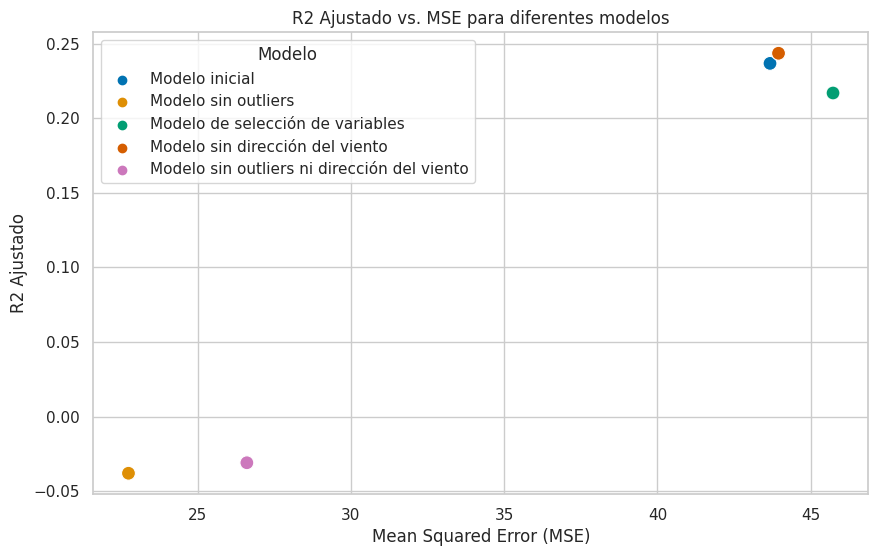

In [119]:
# Valores de R2 Ajustado y MSE para cada modelo
modelos = ['Modelo inicial', 'Modelo sin outliers', 'Modelo de selección de variables', 'Modelo sin dirección del viento', 'Modelo sin outliers ni dirección del viento']
r2_ajustado = [adjusted_r2, adjusted_r2_out, adjusted_r2_selected, adjusted_r2_no_dir, adjusted_r2_comb]
mse = [mse_inicial, mse_out, mse_selected, mse_no_dir, mse_comb]

# Crear un DataFrame con los datos
import pandas as pd
data = pd.DataFrame({'Modelo': modelos, 'R2 Ajustado': r2_ajustado, 'MSE': mse})

# Configurar el estilo de Seaborn
sns.set(style="whitegrid")

# Crear el gráfico utilizando Seaborn
plt.figure(figsize=(10, 6))
sns.scatterplot(data=data, x='MSE', y='R2 Ajustado', hue='Modelo', palette='colorblind', s=100)

# Etiquetas y título
plt.xlabel('Mean Squared Error (MSE)')
plt.ylabel('R2 Ajustado')
plt.title('R2 Ajustado vs. MSE para diferentes modelos')

# Mostrar el gráfico
plt.grid(True)
plt.show()


Ahora resta elegir entre:

1. **Modelo con mayor R2 ajustado**: Es un modelo se ajusta mejor a la variabilidad de los datos en promedio. Ofrece una explicación razonable de la variabilidad en la variable objetivo. A menudo, este modelo se adapta mejor al patrón general de los datos. Sin embargo, cuando comete errores, estos errores pueden ser más significativos, lo que resulta en un MSE más alto. Es decir, puede haber valores atípicos o desviaciones más grandes en sus predicciones cuando se aleja del patrón general.

2. **Modelo con menor R2 ajustado**: Este modelo no se ajusta tan bien a la variabilidad de los datos en promedio.
No logra explicar tan bien la variabilidad en la variable objetivo como el otro modelo.
Puede ser más resistente a valores atípicos o desviaciones extremas, lo que se refleja en un MSE más bajo. A pesar de tener un R2 ajustado más bajo, su capacidad para predecir valores cercanos a la verdad es mejor en promedio.

Pero recordemos que el modelo de menor MSE es un modelo que eliminaba los datos atípicos, por lo que los valores "reales" con los que se compara son, en realidad, ficticios. Adicionalmente, si lo que se desea es predecir si lloverá o no, uno querría acertar usualmente y errar unas pocas aunque sea por mucho. En consecuencia, el modelo elegido es el de mejor R2 ajustado: El que no tiene en cuenta la dirección del viento.

In [193]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(weatherAUS_no_dir.drop('RainfallTomorrow', axis=1),
                                             weatherAUS_no_dir['RainfallTomorrow'].values.reshape(-1,1),
                                             test_size=0.2,
                                             random_state=7,
                                             )

# Estandarizar las características
scaler = StandardScaler()
X_train_scaled=scaler.fit_transform(X_train)
X_test_scaled=scaler.transform(X_test)

# Crear un modelo de regresión lineal
linear_regression = LinearRegression(fit_intercept=True)

# Ajustar el modelo a los datos de entrenamiento
linear_regression.fit(X_train_scaled,y_train)

y_predictions = linear_regression.predict(X_test_scaled)

# Número de observaciones
n = len(y_test)

# Número de características (predictores)
p = X_test_scaled.shape[1]

# Calcular el R2
r2 = r2_score(y_test, y_predictions)

# Calcular el MSE
mse = mean_squared_error(y_test, y_predictions)

# Calcular el RMSE
rmse = np.sqrt(mse)

# Calcular el R2 ajustado
adjusted_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)

# Imprimir las métricas en la consola
print(f"R2 Ajustado: {adjusted_r2:.4f}")
print(f"Mean Squared Error (MSE): {mse:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")

R2 Ajustado: 0.2435
Mean Squared Error (MSE): 43.9498
Root Mean Squared Error (RMSE): 6.6295


## 4 - Gradiente Descendiente

Se probarán ahora, métodos de gradiente descendiente para minimizar la función de error y hallar los parámetros óptimos para la regresión lineal.

### 4.1 - Definir funciones de gradiente descendiente

Se defininen a continuación, las funciones para aplicar los distintos métodos de gradiente descendiente

#### 4.1.1 - Función Gradiente Descendiente

El gradiente descendiente es un algoritmo de optimización utilizado para encontrar los valores óptimos de los parámetros de un modelo.

El objetivo principal del gradiente descendiente es minimizar una función de costo al ajustar iterativamente los parámetros del modelo. Comienza con valores iniciales para los parámetros y se desplaza en la dirección opuesta al gradiente de la función de costo para reducir el error. Este proceso se repite en cada iteración hasta que se alcanza un mínimo o un punto de convergencia.

In [177]:
def gradient_descent(X_train, y_train, X_test, y_test, lr=0.01, epochs=100):
    """
    shapes:
        X_train = nxm
        y_train = nx1
        X_test = pxm
        y_test = px1
        W = mx1
    """
    n = X_train.shape[0]
    m = X_train.shape[1]

    o = X_test.shape[0]

    # Poner columna de unos a las matrices X
    X_train = np.hstack((np.ones((n, 1)), X_train))
    X_test = np.hstack((np.ones((o, 1)), X_test))

    # Inicializar pesos aleatorios
    W = np.random.randn(m+1).reshape(m+1, 1)

    train_errors = []  # Para almacenar el error de entrenamiento en cada época
    test_errors = []   # Para almacenar el error de prueba en cada época

    for i in range(epochs):
        # Calcular predicción y error de entrenamiento
        prediction_train = np.matmul(X_train, W)
        error_train = y_train - prediction_train
        train_mse = np.mean(error_train ** 2)
        train_errors.append(train_mse)

        # Calcular predicción y error de prueba
        prediction_test = np.matmul(X_test, W)
        error_test = y_test - prediction_test
        test_mse = np.mean(error_test ** 2)
        test_errors.append(test_mse)

        # Calcular el gradiente y actualizar pesos
        gradient = -2/n * np.matmul(X_train.T, error_train)  # mx1
        W = W - (lr * gradient)

    # Graficar errores de entrenamiento y prueba
    # Definir una figura
    plt.figure(figsize=(12, 6))
    # Plotear errores de entrenamiento
    plt.plot(train_errors, label='Error de entrenamiento')
    # Plotear errores de prueba
    plt.plot(test_errors, label='Error de test')
    # Poner labels en los ejes
    plt.xlabel('Época')
    plt.ylabel('Error cuadrático medio')
    # Activar la leyenda
    plt.legend()
    # Poner titulo
    plt.title('Error de entrenamiento y prueba vs iteraciones (GD)')
    # Terminar y mostrar gráfico
    plt.show()

    return W, min(test_errors)

#### 4.1.2 - Gradiente Descendiente estocástico

El gradiente descendiente estocástico es una variante del gradiente descendiente que utiliza un solo ejemplo de entrenamiento seleccionado al azar en cada iteración.

A diferencia del GD convencional, que utiliza el conjunto completo de datos en cada iteración, el SGD toma un enfoque estocástico seleccionando un ejemplo aleatorio y actualiza los parámetros según el gradiente de ese ejemplo. Esto puede hacer que el algoritmo sea más rápido y más adecuado para datos masivos, pero también puede generar una convergencia más ruidosa.

In [178]:
def stochastic_gradient_descent(X_train, y_train, X_test, y_test, lr=0.01, epochs=100):

    n = X_train.shape[0]
    m = X_train.shape[1]

    X_train = np.hstack((np.ones((n, 1)), X_train))
    X_test = np.hstack((np.ones((X_test.shape[0], 1)), X_test))

    W = np.random.randn(m + 1).reshape(-1, 1)

    train_errors = []
    test_errors = []

    for i in range(epochs):
        # Permutación aleatoria de los datos
        permutation = np.random.permutation(n)
        X_train = X_train[permutation]
        y_train = y_train[permutation]

        for j in range(n):
            # Obtener una muestra aleatoria de un solo dato para hacer SGD
            x_sample = X_train[j]
            y_sample = y_train[j][0]

            prediction = np.matmul(x_sample, W)
            error = y_sample - prediction
            train_mse = error ** 2
            train_errors.append(train_mse)

            gradient = -2 * error * x_sample.T.reshape(-1, 1)

            W = W - (lr * gradient)

            prediction_test = np.matmul(X_test, W)
            error_test = y_test - prediction_test
            test_mse = np.mean(error_test ** 2)
            test_errors.append(test_mse)

    plt.figure(figsize=(12, 6))
    plt.plot(train_errors, label='Error de entrenamiento')
    plt.plot(test_errors, label='Error de prueba')
    plt.xlabel('Iteración')
    plt.ylabel('Error cuadrático medio')
    plt.legend()
    plt.title('Error de entrenamiento y prueba vs iteraciones (SGD)')
    plt.show()

    return W, min(test_errors)

#### 4.1.3 - Gradiente Descendiente Mini-Batch

El gradiente descendiente en mini-batch es una combinación de los dos métodos anteriores. En lugar de utilizar todo el conjunto de datos o un solo ejemplo, se divide en lotes más pequeños llamados "mini-batches".

El Mini-Batch GD calcula el gradiente y actualiza los parámetros utilizando un mini-batch de ejemplos en cada iteración. Esto permite un equilibrio entre la eficiencia de cómputo del GD y la velocidad del SGD, lo que es útil para conjuntos de datos de tamaño mediano.

In [179]:
def mini_batch_gradient_descent(X_train, y_train, X_test, y_test, lr=0.01, epochs=100, batch_size=500):
    n = X_train.shape[0]
    m = X_train.shape[1]

    X_train = np.hstack((np.ones((n, 1)), X_train))
    X_test = np.hstack((np.ones((X_test.shape[0], 1)), X_test))

    W = np.random.randn(m + 1).reshape(-1, 1)

    train_errors = []
    test_errors = []

    for i in range(epochs):

        # Permutación aleatoria de los datos
        permutation = np.random.permutation(n)
        X_train = X_train[permutation]
        y_train = y_train[permutation]


        for j in range(0, n, batch_size):
            # Obtener un lote (mini-batch) de datos
            x_batch = X_train[j:j+batch_size, :]
            y_batch = y_train[j:j+batch_size].reshape(-1, 1)

            prediction = np.matmul(x_batch, W)
            error = y_batch - prediction
            train_mse = np.mean(error ** 2)
            train_errors.append(train_mse)

            gradient = -2 * np.matmul(x_batch.T, error) / batch_size

            W = W - (lr * gradient)

            prediction_test = np.matmul(X_test, W)
            error_test = y_test - prediction_test
            test_mse = np.mean(error_test ** 2)
            test_errors.append(test_mse)

    plt.figure(figsize=(12, 6))
    plt.plot(train_errors, label='Error de entrenamiento')
    plt.plot(test_errors, label='Error de prueba')
    plt.xlabel('Iteración')
    plt.ylabel('Error cuadrático medio')
    plt.legend()
    plt.title('Error de entrenamiento y prueba vs iteraciones (Mini-Batch GD)')
    plt.show()

    return W, min(test_errors)

### 4.2 - Gradiente descendiente

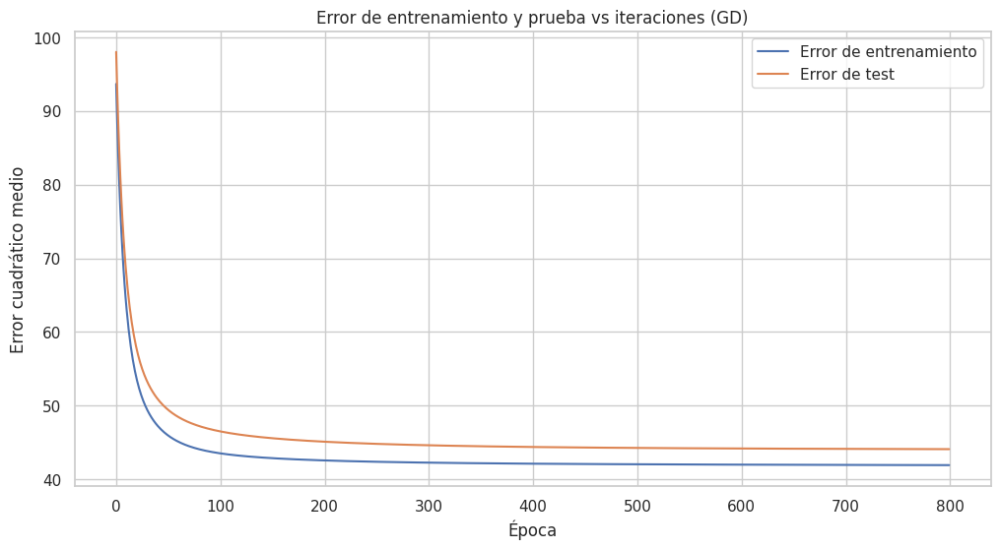

RMSE mínimo: 6.6404 


In [180]:
mse_GD = gradient_descent(X_train_scaled, y_train, X_test_scaled, y_test, lr=0.01, epochs=800)[1]
rmse_GD = np.sqrt(mse_GD)

print(f"RMSE mínimo: {rmse_GD:.4f} ")

El método de Gradiente Descediente logra un error muy parecido al de la función de regresión lineal de scikit-learn.

### 4.3 - Gradiente descendiente estocástico

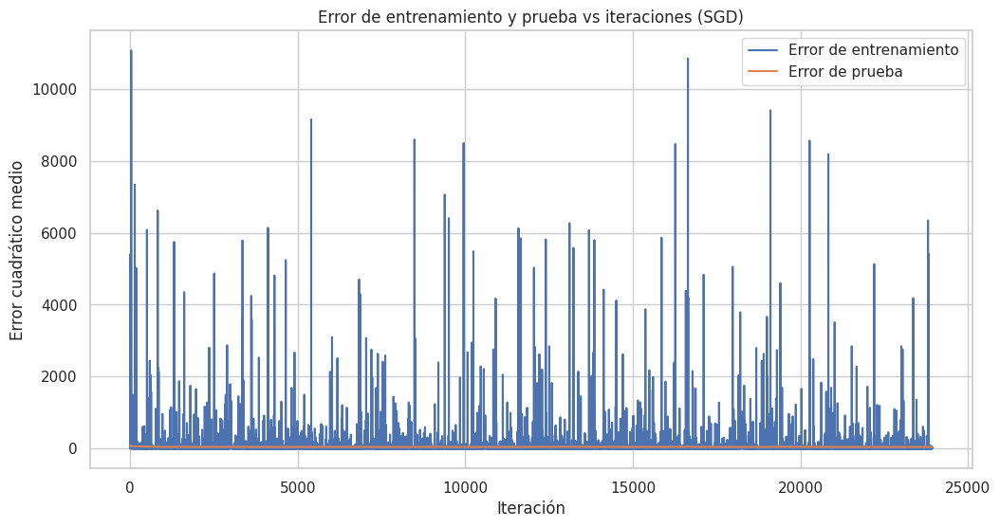

RMSE mínimo: 6.6393 


In [181]:
mse_GDS = stochastic_gradient_descent(X_train_scaled, y_train, X_test_scaled, y_test, epochs=2, lr=0.001)[1]
rmse_GDS = np.sqrt(mse_GDS)

print(f"RMSE mínimo: {rmse_GDS:.4f} ")

El método estocástico, realiza muchísimas más iteraciones pero con un learning rate inferior logra hallar unos valores para los parámetros que predicen de mejor manera los valores del conjunto de prueba.

### 4.4 - Gradiente descendiente Mini-batch

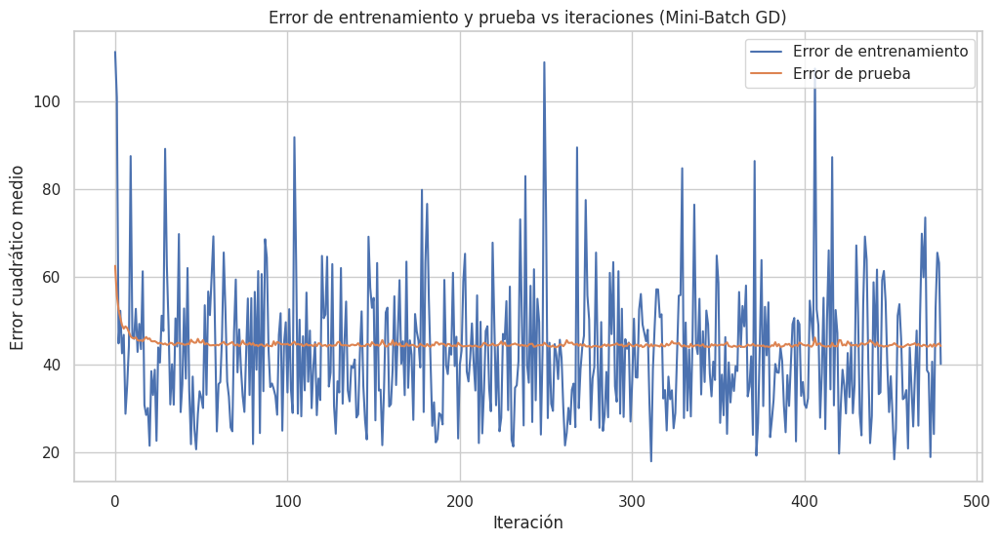

RMSE mínimo: 6.6184 


In [182]:
mse_GDMB = mini_batch_gradient_descent(X_train_scaled, y_train, X_test_scaled, y_test, epochs=20, lr=0.1)[1]
rmse_GDMB = np.sqrt(mse_GDMB)

print(f"RMSE mínimo: {rmse_GDMB:.4f} ")

El Gradiente Descendiente combina lo mejor de los dos mundos alcanzando en pocas iteraciones un error con respecto al conjunto de prueba menor incluso que el de la función de Scikit-Learn.

## 5 - Regularización
La regularización en un modelo de regresión lineal es una técnica utilizada para prevenir el sobreajuste (overfitting) del modelo, es decir, que el modelo se ajuste demasiado a los datos de entrenamiento y no generaliza bien a nuevos datos. Se logra al agregar un término adicional a la función de costo o pérdida del modelo.

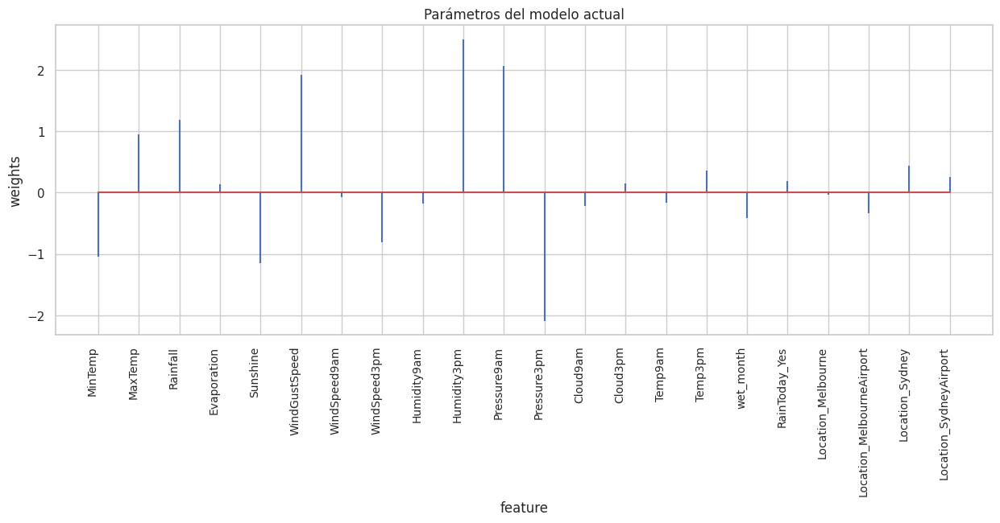

In [183]:
# Coeficientes del modelo actual
df_coeficientes = pd.DataFrame({'predictor': X_train.columns, 'coef': linear_regression.coef_.flatten()})

fig, ax = plt.subplots(figsize=(15, 5))
ax.stem(df_coeficientes.predictor, df_coeficientes.coef, markerfmt=' ')
plt.xticks(rotation=90, ha='right', size=10)
ax.set_xlabel('feature')
ax.set_ylabel('weights')
ax.set_title('Parámetros del modelo actual')
plt.show()

### 5.1 - Regresión Ridge (Regularización L2)
En la regresión Ridge, se agrega un término de penalización a la función de costo que es proporcional al cuadrado de los coeficientes. Esto significa que los coeficientes de la regresión son forzados a mantenerse pequeños, lo que reduce la magnitud de los coeficientes y, por lo tanto, la flexibilidad del modelo. Esto ayuda a prevenir el sobreajuste.


#### 5.1.1 - Creación y entrenamiento del modelo
 Scikit-Learn usa Cross Validation para encontrar el valor óptimo de alpha.


In [194]:
# Creación y entrenamiento del modelo.
modelo = make_pipeline(StandardScaler(),
                        RidgeCV(
                           alphas          = np.logspace(0, 7, 200),
                           fit_intercept   = True,
                           store_cv_values = True
                        )
         )

_ = modelo.fit(X_train, y_train)

#### 5.1.2 - Evolución de los parámentros en función de alfa

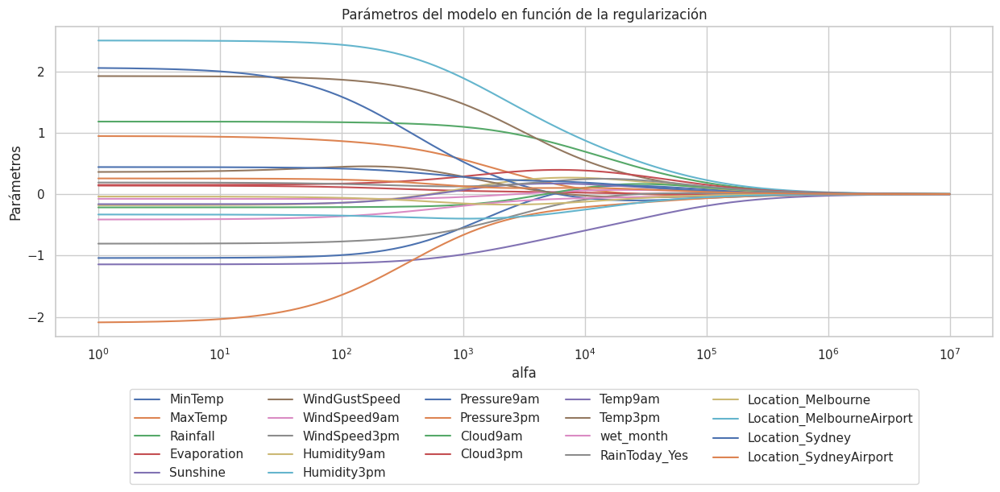

In [195]:
# Evolución de los parámetros en función de alpha
alphas = modelo.steps[1][1].alphas
coefs = []

for alpha in alphas:
    modelo_aux = make_pipeline(StandardScaler(), Ridge(alpha=alpha))
    modelo_aux.fit(X_train, y_train)
    coefs.append(modelo_aux.steps[1][1].coef_.flatten())

fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(alphas, coefs, label=X_train.columns)
ax.set_xscale('log')
ax.set_xlabel('alfa')
ax.set_ylabel('Parámetros')
ax.set_title('Parámetros del modelo en función de la regularización')
plt.axis('tight')

# Configurar la leyenda
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=5)
for handle in legend.legendHandles:
    handle.set_linewidth(1.5)

plt.show()

En este gráfico puede verse como el valor de los parámetros del modelo van tendiendo a cero a medida que el factor de proporcionalidad del término de penalización (alfa) aumenta.

#### 5.1.3 - Hallar el alfa óptimo
Se propone encontrar la constante de proporcionalidad alfa, para el término de penalización de Ridge para minimizar la función de error.

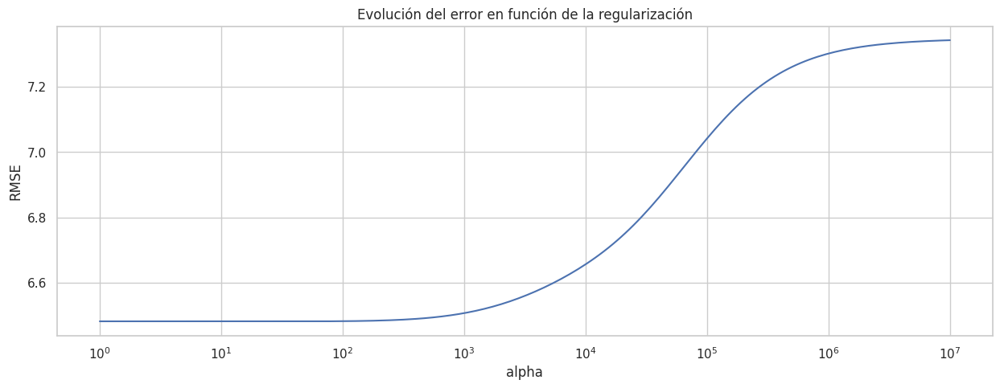

Mejor valor de alpha encontrado: 30.02


In [196]:
# Evolución del error de validación cruzada en función de alpha

# modelo.cv_values almacena el MSE de CV para cada valor de alpha.
mod = modelo.steps[1][1]
mse_cv = mod.cv_values_.reshape((-1, 200)).mean(axis=0)

# Se aplica la raíz cuadrada para pasar de mse a rmse
rmse_cv = np.sqrt(mse_cv)

# Se identifica el mejor
min_rmse = np.min(rmse_cv)
optimo = mod.alphas[np.argmin(rmse_cv)]

fig, ax = plt.subplots(figsize=(15,5))
ax.plot(mod.alphas, rmse_cv)
ax.set_xscale('log')
ax.set_title('Evolución del error en función de la regularización')
ax.set_xlabel('alpha')
ax.set_ylabel('RMSE')
plt.show()

# Mejor valor alpha encontrado
print(f"Mejor valor de alpha encontrado: {mod.alpha_:.2f}")

En este gráfico puede observarse la evolución de la función de error RMSE en función de alfa. El alfa óptimo es el que minimice a esta función, en este caso: ~30.02

#### 5.1.4 - Métricas de Ridge

In [197]:
# Predicciones test
y_pred = modelo.predict(X_test)

# Error de test del modelo
rmse_ridge = mean_squared_error(y_test,
                y_pred,
                squared = False
             )
# R2
r2_ridge = metrics.r2_score(y_test, y_pred)

# Número de observaciones
n = len(y_test)

# Número de características (predictores)
p = X_test_scaled.shape[1]

# Calcular el R2 ajustado
adjusted_r2_ridge = 1 - (1 - r2_ridge) * (n - 1) / (n - p - 1)

print(f"El R2 ajustado de la regresión ridge es: {adjusted_r2_ridge:.4}")
print(f"El error (rmse) de test es: {rmse_ridge:.4f}")

El R2 ajustado de la regresión ridge es: 0.2435
El error (rmse) de test es: 6.6297




> Dado que inicialmente se han planteado las regularizaciones en base al mejor modelo hallado de regresión según su R2 ajustado, que era el modelo sin las direcciones del viento. Se realizará a continuación, una inspección de las métricas para Ridge utilizando todas las variables del dataset con la intención de conocer si para el modelo de regresión lineal sería mejor utilizar todas las variables, utilizar todas menos las direcciones del viento o es lo mismo.



In [198]:
# Creación y entrenamiento del modelo.
modelo_con_dir = make_pipeline(StandardScaler(),
                        RidgeCV(
                           alphas          = np.logspace(0, 7, 200),
                           fit_intercept   = True,
                           store_cv_values = True
                        )
         )

_ = modelo_con_dir.fit(X_train_reg, y_train_reg)

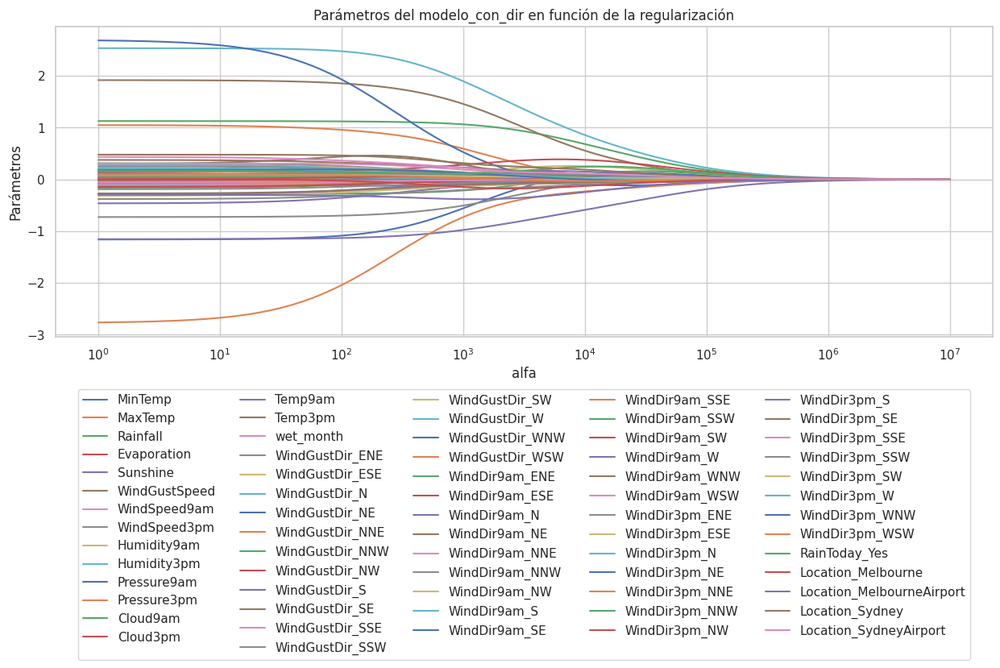

In [199]:
# Evolución de los parámetros en función de alpha
alphas = modelo_con_dir.steps[1][1].alphas
coefs = []

for alpha in alphas:
    modelo_con_dir_aux = make_pipeline(StandardScaler(), Ridge(alpha=alpha))
    modelo_con_dir_aux.fit(X_train_reg, y_train_reg)
    coefs.append(modelo_con_dir_aux.steps[1][1].coef_.flatten())

fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(alphas, coefs, label=X_train_reg.columns)
ax.set_xscale('log')
ax.set_xlabel('alfa')
ax.set_ylabel('Parámetros')
ax.set_title('Parámetros del modelo_con_dir en función de la regularización')
plt.axis('tight')

# Configurar la leyenda
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=5)
for handle in legend.legendHandles:
    handle.set_linewidth(1.5)

plt.show()

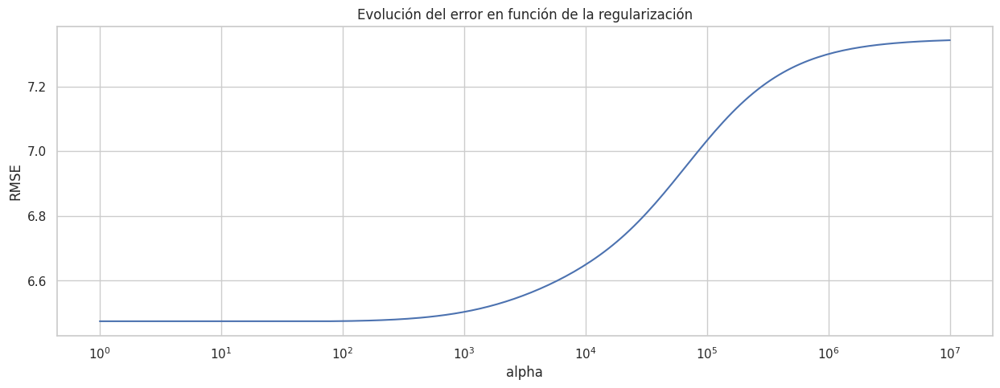

Mejor valor de alpha encontrado: 32.55


In [200]:
# Evolución del error de validación cruzada en función de alpha

# modelo_con_dir.cv_values almacena el MSE de CV para cada valor de alpha.
mod = modelo_con_dir.steps[1][1]
mse_cv_con_dir = mod.cv_values_.reshape((-1, 200)).mean(axis=0)

# Se aplica la raíz cuadrada para pasar de mse a rmse
rmse_cv_con_dir = np.sqrt(mse_cv_con_dir)

# Se identifica el mejor
min_rmse = np.min(rmse_cv_con_dir)
optimo = mod.alphas[np.argmin(rmse_cv_con_dir)]

fig, ax = plt.subplots(figsize=(15,5))
ax.plot(mod.alphas, rmse_cv_con_dir)
ax.set_xscale('log')
ax.set_title('Evolución del error en función de la regularización')
ax.set_xlabel('alpha')
ax.set_ylabel('RMSE')
plt.show()

# Mejor valor alpha encontrado
print(f"Mejor valor de alpha encontrado: {mod.alpha_:.2f}")

In [201]:
# Predicciones test
y_pred = modelo_con_dir.predict(X_test_reg)

# Error de test del modelo_con_dir
rmse_ridge_con_dir = mean_squared_error(y_test_reg,
                y_pred,
                squared = False
             )
# R2
r2_ridge = metrics.r2_score(y_test_reg, y_pred)

# Número de observaciones
n = len(y_test_reg)

# Número de características (predictores)
p = X_test_reg.shape[1]

# Calcular el R2 ajustado
adjusted_r2_ridge = 1 - (1 - r2_ridge) * (n - 1) / (n - p - 1)

print(f"El R2 ajustado de la regresión ridge es: {adjusted_r2_ridge:.4}")
print(f"El error (rmse) de test es: {rmse_ridge_con_dir:.4f}")

El R2 ajustado de la regresión ridge es: 0.2366
El error (rmse) de test es: 6.6090


Se observa que las variables que representan las direcciones del viento, comienzan muy cerca del cero y tienden rápipdamente a él. Además, el R2 ajustado obtenido es menor al observado para la regularización ridge sin las variables de dirección del viento. Si bien el error es ligeramente menor en el caso actual que en la implementación de Ridge sin las direcciones del viento, el enfoque que se tiene es elegir un modelo que me permita acertar la mayor cantidad de veces, aunque las veces que no acierte lo haga con un margen mayor de error.

Es así, que se continuará utilizando el modelo sin las direcciones del viento.

### 5.2 - Regresión Lasso (Regularización L1)

En la regresión Lasso, se agrega un término de penalización a la función de costo que es proporcional al valor absoluto de los coeficientes. La característica distintiva de Lasso es que puede conducir a la eliminación de ciertos coeficientes al hacer que sean exactamente cero. Esto no solo previene el sobreajuste, sino que también realiza la selección de características, lo que significa que algunas características se excluyen automáticamente del modelo.

#### 5.2.1 - Creación y entrenamiento del modelo

In [202]:
modelo = make_pipeline(StandardScaler(),
                        LassoCV(
                           alphas=np.logspace(-3, 1, 200),
                           cv=10
                        )
         )

_ = modelo.fit(X_train, y_train)

#### 5.2.2 - Evolución de los parámentros en función de alfa

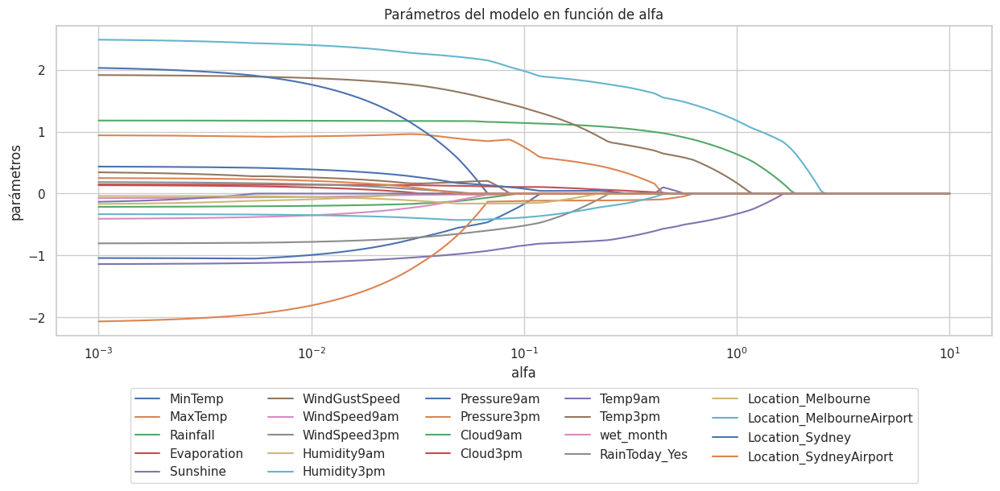

In [203]:
# Evolución de los parámetros en función de alpha
mod = modelo.steps[1][1]

alphas = mod.alphas_
coefs = []

for alpha in alphas:
    modelo_aux = make_pipeline(StandardScaler(), Lasso(alpha=alpha))
    modelo_aux.fit(X_train, y_train)
    coefs.append(modelo_aux.steps[1][1].coef_.flatten())

fig, ax = plt.subplots(figsize=(15,5))
ax.plot(alphas, coefs, label=X_train.columns)
ax.set_xscale('log')
ax.set_xlabel('alfa')
ax.set_ylabel('parámetros')
ax.set_title('Parámetros del modelo en función de alfa')

# Configurar la leyenda
legend = ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=5)
for handle in legend.legendHandles:
    handle.set_linewidth(1.5)

plt.show()

En el gráfico se observa cómo la regresión Lasso es mucho más agresiva para eliminar coeficientes, quedando algunos en el camino muy temprano, a diferencia de Ridge dónde todos se anulaban para valores de alfa muy próximos.

#### 5.2.3 - Gráfico de la cantidad de variables incluidas en el modelo en función de alfa

Text(0.5, 1.0, 'Features incluidas en función de la regularización')

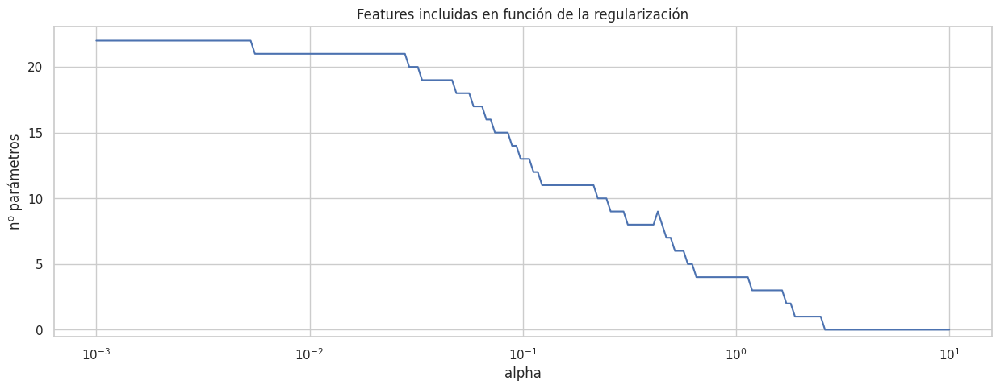

In [204]:
# Número de features incluidas (parámetros !=0) en función de alpha
alphas = mod.alphas_
n_predictores = []

for alpha in alphas:
    modelo_aux = make_pipeline(StandardScaler(), Lasso(alpha=alpha))
    modelo_aux.fit(X_train, y_train)
    coef_no_cero = np.sum(modelo_aux.steps[1][1].coef_.flatten() != 0)
    n_predictores.append(coef_no_cero)

fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(alphas, n_predictores)
ax.set_xscale('log')
ax.set_ylim([-0.5,None])
ax.set_xlabel('alpha')
ax.set_ylabel('nº parámetros')
ax.set_title('Features incluidas en función de la regularización')

#### 5.2.4 - Error en función de alfa
Aquí también se busca el alfa que minimice la función de error (RMCE).

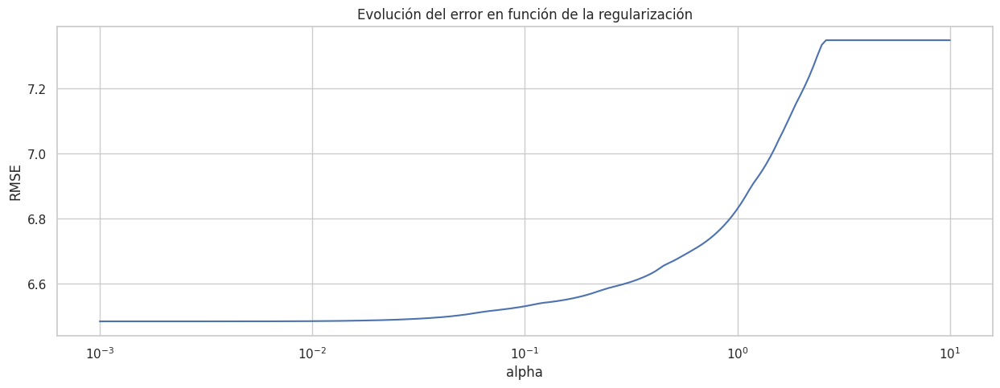

Mejor valor de alpha encontrado: 0.0020


In [205]:
# Evolución del error de validación cruzada en función de alpha
# modelo.mse_path almacena el MSE de CV para cada valor de alpha.
mse_cv = mod.mse_path_.mean(axis=1)

# Se aplica la raíz cuadrada para pasar de mse a rmse
rmse_cv = np.sqrt(mse_cv)

# Se identifica el mejor
min_rmse     = np.min(rmse_cv)
optimo       = mod.alphas_[np.argmin(rmse_cv)]

# Graficar
fig, ax = plt.subplots(figsize=(15,5))
ax.plot(mod.alphas_, rmse_cv)
ax.set_xscale('log')
ax.set_title('Evolución del error en función de la regularización')
ax.set_xlabel('alpha')
ax.set_ylabel('RMSE')
plt.show()

# Mejor valor alpha encontrado
print(f"Mejor valor de alpha encontrado: {mod.alpha_:.4f}")

Para el caso de la regresión Lasso, no se observa un mínimo local para valores significativos de alfa.

In [206]:
# Predicciones de Lasso
y_pred = modelo.predict(X_test)

# Error de test del modelo
rmse_lasso = mean_squared_error(y_test,
                y_pred,
                squared = False
             )
# R2
r2_lasso = metrics.r2_score(y_test, y_pred)

# Número de observaciones
n = len(y_test)

# Número de características (predictores)
p = X_test_scaled.shape[1]

# Calcular el R2 ajustado
adjusted_r2_lasso = 1 - (1 - r2_lasso) * (n - 1) / (n - p - 1)

print(f"El R2 ajustado de la regresión lasso es: {adjusted_r2_lasso:.4}")
print(f"El error (rmse) de test es: {rmse_lasso:.4f}")

El R2 ajustado de la regresión lasso es: 0.2434
El error (rmse) de test es: 6.6300


### 5.3 - ElasticNet

ElasticNet es una técnica de regularización que combina las características de la regresión Ridge (L2 Regularization) y la regresión Lasso (L1 Regularization) en un solo modelo. Fue desarrollada para aprovechar los beneficios de ambas técnicas al mismo tiempo.

En ElasticNet, se agrega un término de penalización tanto para el cuadrado de los coeficientes (como en Ridge) como para el valor absoluto de los coeficientes (como en Lasso) a la función de costo del modelo. La magnitud de la penalización está controlada por dos hiperparámetros: alpha y l1_ratio.

1. Alpha: Es un hiperparámetro que controla la fuerza de la regularización. Un valor más alto de alpha significa una regularización más fuerte. Si alpha es igual a cero, ElasticNet se convierte en una regresión lineal estándar sin regularización.

2. L1_ratio: Es un hiperparámetro que controla la proporción de la penalización L1 (como en Lasso) en comparación con la penalización L2 (como en Ridge). Si l1_ratio es igual a 1, ElasticNet se comporta como Lasso; si es igual a 0, se comporta como Ridge. Valores intermedios representan combinaciones de ambas regularizaciones.

#### 5.3.1 - Creación y entrenamiento del modelo

In [207]:
modelo = make_pipeline(StandardScaler(),
                        ElasticNetCV(
                              l1_ratio        = [0, 0.1, 0.5, 0.7, 0.9, 0.95, 0.99],
                              alphas          = np.logspace(-10, 10, 200),
                              cv              = 10
                           )
         )

_ = modelo.fit(X_train, y_train)

mod = modelo.steps[1][1]

#### 5.3.2 - Evolución del error de cross validation en función de l1_ratio

El propósito de este gráfico es intentar determinar un valor óptimo de l1_ratio que minimice la función de error.

Mejor valor de alpha encontrado: 0.0034
Mejor valor de l1_ratio encontrado: 0.0


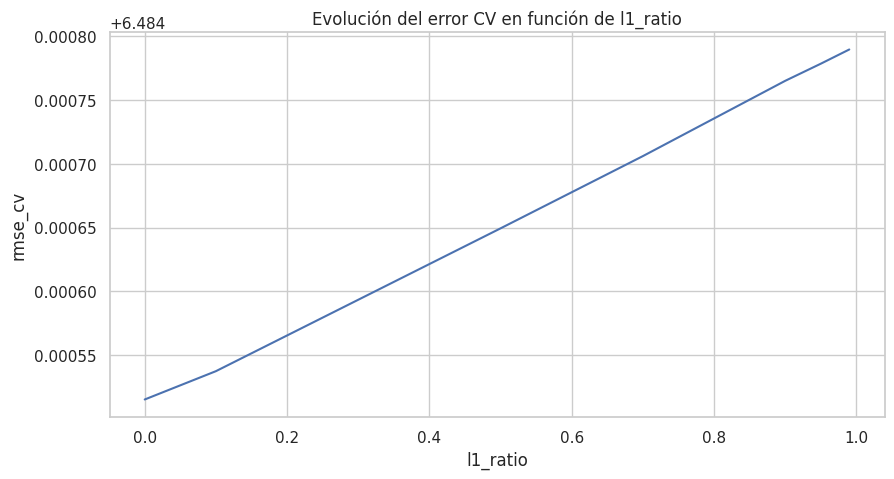

In [208]:
# Error medio de las 10 particiones por cada valor de alpha y l1_ratio
mean_error_cv = mod.mse_path_.mean(axis =2)

# El resultado es un array de dimensiones (n_l1_ratio, n_alpha) se convierte en un dataframe
df_resultados_cv = pd.DataFrame(
                        data   = mean_error_cv.flatten(),
                        index  = pd.MultiIndex.from_product(
                                    iterables = [mod.l1_ratio, mod.alphas_],
                                    names     = ['l1_ratio', 'mod.alphas_']
                                 ),
                        columns = ["mse_cv"]
                    )

df_resultados_cv['rmse_cv'] = np.sqrt(df_resultados_cv['mse_cv'])
df_resultados_cv = df_resultados_cv.reset_index().sort_values('mse_cv', ascending = True)

# Graficar
fig, ax = plt.subplots(figsize=(10, 5))
df_resultados_cv.groupby('l1_ratio')['rmse_cv'].min().plot(ax = ax)
ax.set_title('Evolución del error CV en función de l1_ratio')
ax.set_xlabel('l1_ratio')
ax.set_ylabel('rmse_cv');

# Mejor valor alpha y l1_ratio_ encontrado
print(f"Mejor valor de alpha encontrado: {mod.alpha_:.4f}")
print(f"Mejor valor de l1_ratio encontrado: {mod.l1_ratio_}")

Nuevamente no se observa un mínimo para valores significativos de l1_ratio. El valor óptimo de l1_ratio hallado fue 0, por lo que lo óptimo es utilizar una regularizarización Ridge pura.

In [209]:
# Predicciones de ElasticNet
y_pred = modelo.predict(X_test)

# Error de test del modelo
rmse_elastic = mean_squared_error(y_test,
                y_pred,
                squared = False
             )
# R2
r2_elastic = metrics.r2_score(y_test, y_pred)

# Número de observaciones
n = len(y_test)

# Número de características (predictores)
p = X_test_scaled.shape[1]

# Calcular el R2 ajustado
adjusted_r2_elastic = 1 - (1 - r2_elastic) * (n - 1) / (n - p - 1)

print(f"El R2 ajustado de la regresión elastic es: {adjusted_r2_elastic:.4}")
print(f"El error (rmse) de test es: {rmse_elastic:.4f}")

El R2 ajustado de la regresión elastic es: 0.2434
El error (rmse) de test es: 6.6298


## 6 - Comparación de modelos


In [210]:
# Crear un diccionario con los datos
data = {
    "Modelo": ["Regresión Lineal", "Gradiente Descendiente", "Gradiente Descendiente Estocástico",
               "Gradiente Descendiente Mini Batch", "Regresión Ridge", "Regresión Lasso", "Regresión ElasticNet"],
    "RMSE": [rmse_no_dir, rmse_GD, rmse_GDS, rmse_GDMB, rmse_ridge, rmse_lasso, rmse_elastic]
}

# Crear un DataFrame a partir del diccionario
df_rmse = pd.DataFrame(data)

#Crear un dataframe para mostrar
df_mostrar = df_rmse.copy()

# Redondear los valores de la columna 'RMSE' a 4 decimales
df_mostrar['RMSE'] = df_mostrar['RMSE'].round(4)

# Mostrar el DataFrame
df_mostrar

,Modelo,RMSE
0,Regresión Lineal,6.6295
1,Gradiente Descendiente,6.6404
2,Gradiente Descendiente Estocástico,6.6393
3,Gradiente Descendiente Mini Batch,6.6184
4,Regresión Ridge,6.6297
5,Regresión Lasso,6.6300
6,Regresión ElasticNet,6.6298


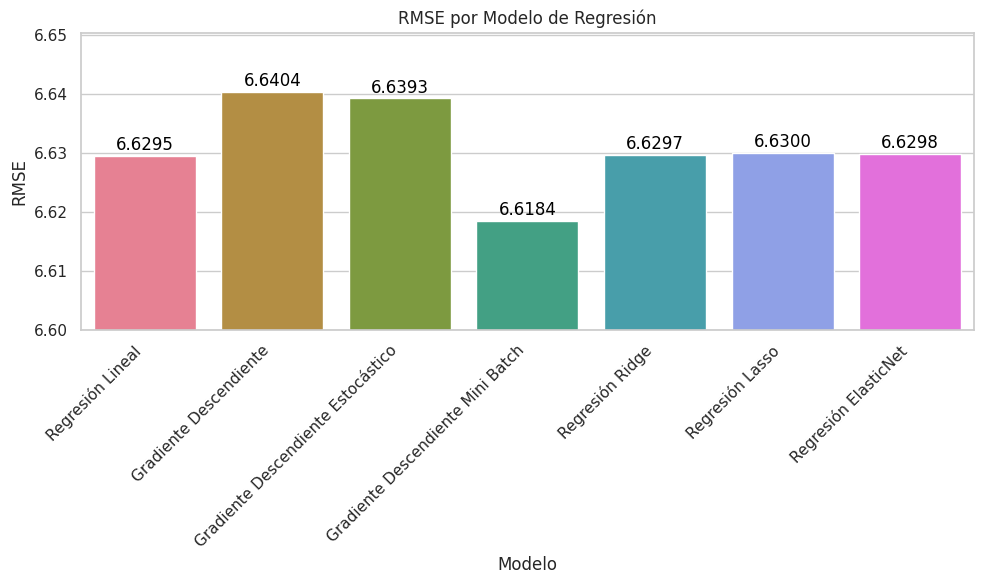

In [211]:
# Crear el gráfico de barras con la paleta 'husl' y etiquetas
plt.figure(figsize=(10, 6))
barplot = sns.barplot(x="Modelo", y="RMSE", data=df_rmse, palette="husl")

# Establecer el límite inferior del eje Y en 6.625
plt.ylim(6.6, max(df_rmse["RMSE"]) + 0.01)

# Agregar etiquetas a las barras
for index, row in df_rmse.iterrows():
    barplot.text(row.name, row.RMSE + 0.001, f'{row.RMSE:.4f}', color='black', ha="center")

plt.xticks(rotation=45, ha='right')
plt.title("RMSE por Modelo de Regresión")
plt.xlabel("Modelo")
plt.ylabel("RMSE")
plt.tight_layout()

# Mostrar el gráfico
plt.show()


## 7 - Redes Neuronales

In [279]:
def build_model(num_layers, num_neurons, activation_function='relu', opt='adam'):
    model = keras.Sequential()
    model.add(keras.layers.Dense(num_neurons, activation=activation_function, input_shape=(X_train_scaled.shape[1],)))

    for _ in range(num_layers - 1):
        model.add(keras.layers.Dense(num_neurons, activation=activation_function))

    model.add(keras.layers.Dense(1))  # Capa de salida sin función de activación para regresión
    model.compile(optimizer=opt, loss='mean_squared_error')
    return model

# Configurar la validación cruzada k-fold
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Probar diferentes configuraciones de capas y neuronas
for num_layers in [1, 2]:
    for num_neurons in [32, 64, 128, 200]:
        print(f'\nConfiguración: Capas={num_layers}, Neuronas por capa={num_neurons}')

        # Almacenar métricas para todas las iteraciones
        mse_scores = []
        r2_scores = []

        # Iterar sobre las particiones y entrenar/evaluar el modelo
        for train_index, val_index in kf.split(X_train_scaled):
            X_train_rn, X_val_rn = X_train_scaled[train_index], X_train_scaled[val_index]
            y_train_rn, y_val_rn = y_train[train_index], y_train[val_index]

            # Construir y entrenar el modelo
            model = build_model(num_layers, num_neurons)
            model.fit(X_train_rn, y_train_rn, epochs=50, batch_size=32, verbose=0)

            # Obtener predicciones
            predictions = model.predict(X_val_rn)

            # Calcular MSE
            mse = mean_squared_error(y_val_rn, predictions)
            mse_scores.append(mse)
            # R2
            r2_score_nn = metrics.r2_score(y_val_rn, predictions)

            # Calcular R^2 ajustado
            n = X_val_rn.shape[0]  # número de observaciones
            p = X_val_rn.shape[1]  # número de características
            r2_adj = 1 - (1 - r2_score_nn) * (n - 1) / (n - p - 1)
            r2_scores.append(r2_adj)

        # Imprimir la media de las métricas para todas las iteraciones
        print(f'Media de MSE para la validación cruzada con {num_layers} capas y {num_neurons} neuronas por capa: {np.mean(mse_scores)}')
        print(f'Media de R^2 ajustado para la validación cruzada con {num_layers} capas y {num_neurons} neuronas por capa: {np.mean(r2_scores)}')



Configuración: Capas=1, Neuronas por capa=32
75/75 [==============================] - 0s 1ms/step
Media de MSE para la validación cruzada con 1 capas y 32 neuronas por capa: 36.4625815516091
Media de R^2 ajustado para la validación cruzada con 1 capas y 32 neuronas por capa: 0.31766201684106565

Configuración: Capas=1, Neuronas por capa=64
75/75 [==============================] - 0s 2ms/step
Media de MSE para la validación cruzada con 1 capas y 64 neuronas por capa: 35.998798889282625
Media de R^2 ajustado para la validación cruzada con 1 capas y 64 neuronas por capa: 0.32588223917472076

Configuración: Capas=1, Neuronas por capa=128
75/75 [==============================] - 0s 1ms/step
Media de MSE para la validación cruzada con 1 capas y 128 neuronas por capa: 36.09568506698177
Media de R^2 ajustado para la validación cruzada con 1 capas y 128 neuronas por capa: 0.32431104159718344

Configuración: Capas=1, Neuronas por capa=200
75/75 [==============================] - 0s 1ms/step
Med

Puede observarse que a medida que aumenta el número de capas, el R2 ajustado y el MSE desmejoran. Al aumentar el número de neuronas en redes neuronales con mayor cantidad de capas, el rendimiento del modelo, disminuye más abruptamente. Se entiende que se ha generado overfitting sobre los datos de entrenamiento.

En esta ocasión, dado que los fines de este proyecto son didácticos, se ha utilizado validación cruzada con KFold. Sin embargo, en otras circunstancias, no sería lo más conveniente, dado que el consumo de recursos computacionales y tiempo es elevado, haciendo su uso poco viable.

## 8 - Tuning de hiperparámetros de la red neuronal

Anteriormente se ha encontrado que el mejor rendimiento se obtenía configurando los hiperparámetros de la red neuronal en 1 capa y 128 neuronas. Se realizará ahora un tuning de hiperparámetros rondando ésos valores para conocer si se puede mejorar un poco más el rendimiento.

In [281]:
# Define la función objetivo que Optuna tratará de maximizar
def objective(trial):
    # Define los parámetros a optimizar
    num_layers = trial.suggest_int('num_layers', 1, 1)
    num_neurons = trial.suggest_int('num_neurons', 32, 160, 32)

    # Construir el modelo
    model = keras.Sequential()
    model.add(keras.layers.Dense(num_neurons, activation='relu', input_shape=(X_train_scaled.shape[1],)))

    for _ in range(num_layers - 1):
        model.add(keras.layers.Dense(num_neurons, activation='relu'))

    model.add(keras.layers.Dense(1))  # Capa de salida sin función de activación para regresión
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Entrenar el modelo
    model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, verbose=0)

    # Evaluar el modelo en el conjunto de validación
    val_predictions = model.predict(X_test_scaled)

    # Calcular MSE
    mse = mean_squared_error(y_test, val_predictions)
    # R2
    val_r2 = r2_score(y_test, val_predictions)

    # Calcular R^2 ajustado
    n = X_test_scaled.shape[0]  # número de observaciones
    p = X_test_scaled.shape[1]  # número de características
    r2_adj = 1 - (1 - val_r2) * (n - 1) / (n - p - 1)
    print(f'R2 ajustado: {r2_adj}')
    print(f'MSE: {mse}')

    return r2_adj

# Configurar el estudio de Optuna con enfoque bayesiano
study = optuna.create_study(direction='maximize', sampler=optuna.samplers.TPESampler())
study.optimize(objective, n_trials=10)

[I 2023-12-07 01:34:05,486] A new study created in memory with name: no-name-f485606f-5c05-4803-a280-1f2bfba2b238


94/94 [==============================] - 0s 2ms/step
R2 ajustado: 0.364670447900612
MSE: 36.91128753932501


[I 2023-12-07 01:34:47,474] Trial 0 finished with value: 0.364670447900612 and parameters: {'num_layers': 1, 'num_neurons': 128}. Best is trial 0 with value: 0.364670447900612.


94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 01:35:18,293] Trial 1 finished with value: 0.37272593352120553 and parameters: {'num_layers': 1, 'num_neurons': 160}. Best is trial 1 with value: 0.37272593352120553.


R2 ajustado: 0.37272593352120553
MSE: 36.44328106138281
94/94 [==============================] - 0s 1ms/step


[I 2023-12-07 01:36:00,240] Trial 2 finished with value: 0.37085679560095375 and parameters: {'num_layers': 1, 'num_neurons': 32}. Best is trial 1 with value: 0.37272593352120553.


R2 ajustado: 0.37085679560095375
MSE: 36.55187397508735
94/94 [==============================] - 0s 1ms/step


[I 2023-12-07 01:36:29,627] Trial 3 finished with value: 0.3756546046395147 and parameters: {'num_layers': 1, 'num_neurons': 128}. Best is trial 3 with value: 0.3756546046395147.


R2 ajustado: 0.3756546046395147
MSE: 36.2731315359927
94/94 [==============================] - 0s 1ms/step


[I 2023-12-07 01:36:59,737] Trial 4 finished with value: 0.37113196692032935 and parameters: {'num_layers': 1, 'num_neurons': 128}. Best is trial 3 with value: 0.3756546046395147.


R2 ajustado: 0.37113196692032935
MSE: 36.535887110225666
94/94 [==============================] - 0s 2ms/step
R2 ajustado: 0.37065192724264107

[I 2023-12-07 01:37:41,708] Trial 5 finished with value: 0.37065192724264107 and parameters: {'num_layers': 1, 'num_neurons': 96}. Best is trial 3 with value: 0.3756546046395147.



MSE: 36.563776388341076
94/94 [==============================] - 0s 1ms/step


[I 2023-12-07 01:38:23,897] Trial 6 finished with value: 0.37620226553913205 and parameters: {'num_layers': 1, 'num_neurons': 96}. Best is trial 6 with value: 0.37620226553913205.


R2 ajustado: 0.37620226553913205
MSE: 36.24131360957479
94/94 [==============================] - 0s 1ms/step


[I 2023-12-07 01:38:53,388] Trial 7 finished with value: 0.3601739261285507 and parameters: {'num_layers': 1, 'num_neurons': 128}. Best is trial 6 with value: 0.37620226553913205.


R2 ajustado: 0.3601739261285507
MSE: 37.172525832911305
94/94 [==============================] - 0s 1ms/step
R2 ajustado: 0.3709493739881078

[I 2023-12-07 01:39:35,328] Trial 8 finished with value: 0.3709493739881078 and parameters: {'num_layers': 1, 'num_neurons': 160}. Best is trial 6 with value: 0.37620226553913205.



MSE: 36.54649536888703
94/94 [==============================] - 0s 1ms/step


[I 2023-12-07 01:40:04,514] Trial 9 finished with value: 0.3755274591595108 and parameters: {'num_layers': 1, 'num_neurons': 96}. Best is trial 6 with value: 0.37620226553913205.


R2 ajustado: 0.3755274591595108
MSE: 36.28051841632314


Mejor combinación de hiperparámetros: {'num_layers': 1, 'num_neurons': 96}
Epoch 1/150
374/374 [==============================] - 1s 2ms/step - loss: 44.8134
Epoch 2/150
374/374 [==============================] - 1s 2ms/step - loss: 40.1299
Epoch 3/150
374/374 [==============================] - 1s 2ms/step - loss: 39.2133
Epoch 4/150
374/374 [==============================] - 1s 2ms/step - loss: 38.4667
Epoch 5/150
374/374 [==============================] - 1s 2ms/step - loss: 38.0747
Epoch 6/150
374/374 [==============================] - 1s 3ms/step - loss: 37.5667
Epoch 7/150
374/374 [==============================] - 1s 3ms/step - loss: 37.2177
Epoch 8/150
374/374 [==============================] - 1s 3ms/step - loss: 36.8553
Epoch 9/150
374/374 [==============================] - 1s 3ms/step - loss: 36.5760
Epoch 10/150
374/374 [==============================] - 1s 2ms/step - loss: 36.2770
Epoch 11/150
374/374 [==============================] - 1s 2ms/step - loss: 36.0388
Epoch 12/1

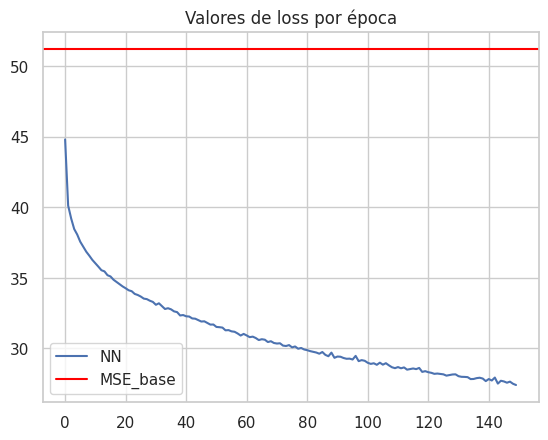

In [299]:
# Obtener los mejores hiperparámetros
best_params = study.best_params
print(f'Mejor combinación de hiperparámetros: {best_params}')

# Entrenar el modelo final con los mejores hiperparámetros
best_model = build_model(num_layers=best_params['num_layers'], num_neurons=best_params['num_neurons'])
loss_history = best_model.fit(X_train_scaled, y_train, epochs=150, batch_size=32, verbose=1)
print("n° de parámetros:", best_model.count_params())

# Evaluar el modelo final en el conjunto de prueba
test_predictions = best_model.predict(X_test_scaled)
test_r2 = r2_score(y_test, test_predictions)
mse_test = mean_squared_error(y_test, test_predictions)
print(f'R^2 en conjunto de prueba con mejores hiperparámetros: {test_r2}')
print(f'MSE en conjunto de prueba con mejores hiperparámetros: {mse_test}')

# Ploteo del loss
plt.plot(loss_history.history['loss'], label='NN')
plt.axhline(mse_base, color='red', label='MSE_base',linestyle = '-')
plt.legend()
plt.title('Valores de loss por época')
plt.show()

## 9 - Explicabilidad SHAP

### 9.1 - Explicabilidad SHAP para Regresión Lineal

#### 9.1.1 - Diagrama de barras global
Se crea un gráfico de importancia de entidad global, en el que la importancia global de cada entidad se toma como el valor absoluto medio de esa entidad en todas las muestras dadas.

In [407]:
# Crear un modelo de regresión lineal
linear_reg = LinearRegression(fit_intercept=True)
# Ajustar el modelo a los datos de entrenamiento
linear_reg.fit(X_train_scaled,y_train)
# Crear el explainer con feature_names
feature_names= X_train.columns.tolist()
explainer = shap.Explainer(linear_reg, X_test_scaled, feature_names=feature_names)

# Calcular los valores SHAP
shap_values = explainer.shap_values(X_test_scaled)

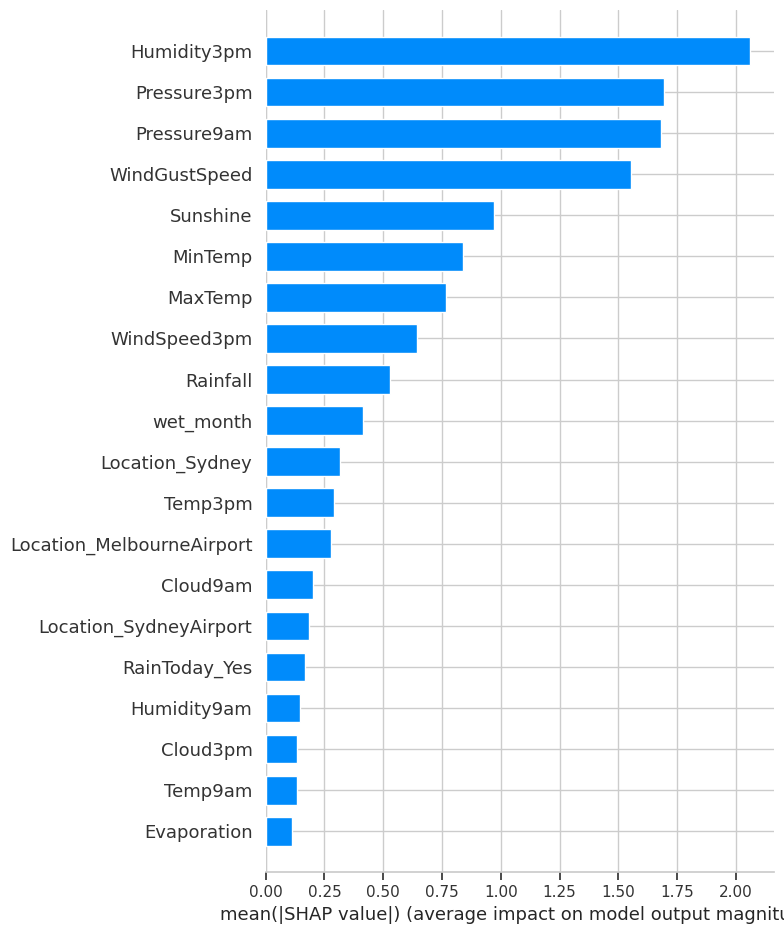

In [408]:
# Graficar los valores SHAP con nombres de características
shap.summary_plot(shap_values, X_test_scaled, feature_names=feature_names, plot_type="bar")
plt.show()

Se observa que para el modelo de regresión lineal entrenado, las variables que mayor influencia tienen en promedio a la hora de realizar predicciones son las de  humedad, Presión (ambas) y velocidad del viento.

A partir de allí, las demás variables tienen contribuciones menos significativas.

Se destaca también, que Humidity3pm se halló como la variable con mayor correlación lineal con la variable objetivo RainfallTomorrow.

#### 9.1.2 - Gráfico de Enjambre de Abejas
El gráfico de enjambre de abejas está diseñado para mostrar un resumen denso en información de cómo las features principales de un dataset afectan a la salida del modelo. En cada caso, la explicación dada está representada por un solo punto en cada característica de la imagen. La posición x del punto está determinada por el valor SHAP de esa feature, y los puntos se "apilan" a lo largo de la fila de cada feature para mostrar la densidad. El color se utiliza para mostrar el valor original de una feature.

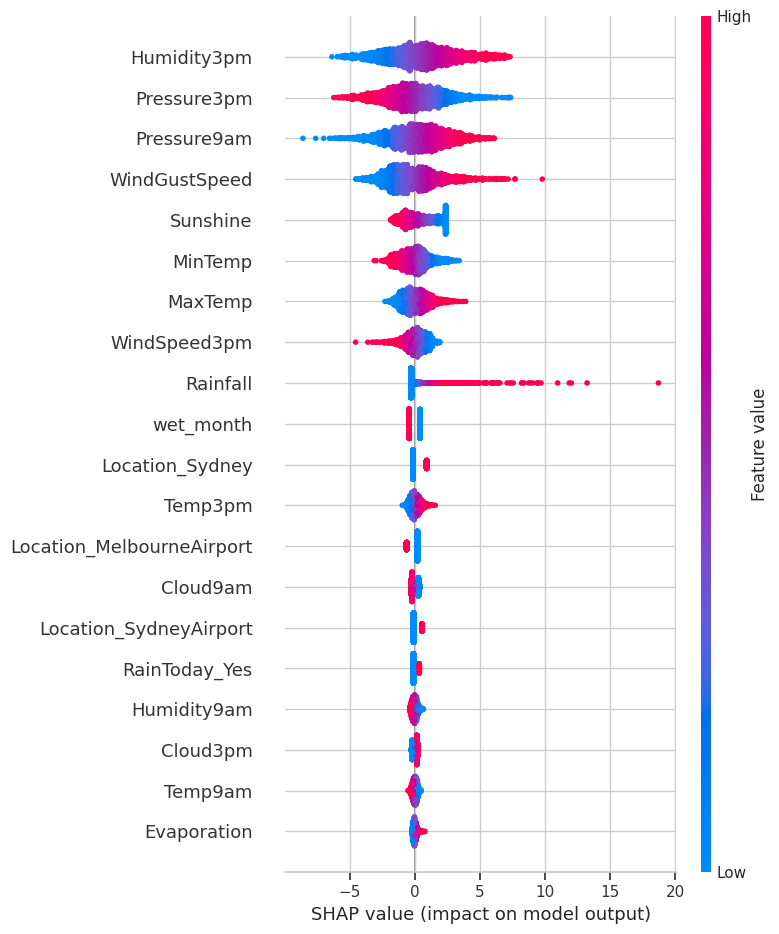

In [409]:
# Graficar los valores SHAP con nombres de características
shap.summary_plot(shap_values, X_test_scaled, feature_names=feature_names)
plt.show()

Observando en más detalle, se encuentra que para humedad y velocidad del viento, mientras mayores sean los valores de las variables en las filas, los valores de shap son positivos y aumentan y mientras menores sean los valores de las variables, serán negativos los valores de shap y disminuirán.

Para las presiones, aunque ambas aportan la mayor contribución a la explicabilidad, mientras la presion para las 3 pm al tener valores mayores en las filas de datos, tiene una contribución negativa a los valores de SHAP y viceversa, sucede lo contrairo con las presiones a la 9 am, que tienen una contribución positiva mientras mayores sean los valores en las filas y negativa mientras menores sean los valores de la variable en las filas.

En resumen, para el modelo entrenado, las features que más contribuyen al resultado de predecir RainfallTomorrow con un determinado valor son  humidity, Pressure3pm, Pressure9am y WindGustSpeed y cada una de ellas tenderá a desplazar el valor positiva o negativamente según lo planteado en los párrafos anteriores.

### 9.2 - Explicabilidad SHAP para Red Neuronal

#### 9.2.1 - Diagrama de barras global


In [302]:
# Crear el explainer con feature_names
feature_names= X_train.columns.tolist()
explainer = shap.Explainer(best_model, X_test_scaled, feature_names=feature_names)

# Calcular los valores SHAP
shap_values = explainer.shap_values(X_test_scaled)


PermutationExplainer explainer: 2993it [01:16, 33.73it/s]                          


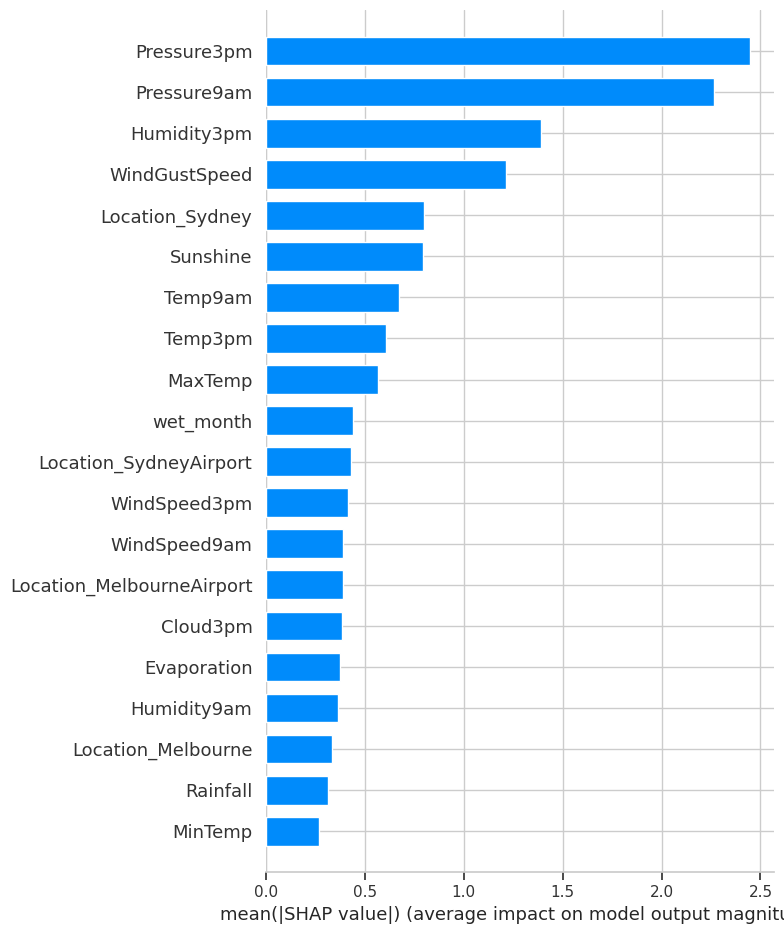

In [306]:
# Graficar los valores SHAP con nombres de características
shap.summary_plot(shap_values, X_test_scaled, feature_names=feature_names, plot_type="bar")
plt.show()

Se observa que para el modelo de red neuronal entrenado, las variables que mayor influencia tienen en promedio a la hora de realizar predicciones son las de Presión (ambas), humedad y velocidad del viento.

La presión se ha posicionado en este caso por encima de la humedad, a diferencia de la regresión lineal anterior. La red neuronal parece haber aprendido que la presión tiene mayor importancia. Esto se ve acertado al momento de realizar las predicciones, ya que son mejores con la red neuronal que con la regresión lineal.

#### 9.2.2 - Gráfico de Enjambre de Abejas


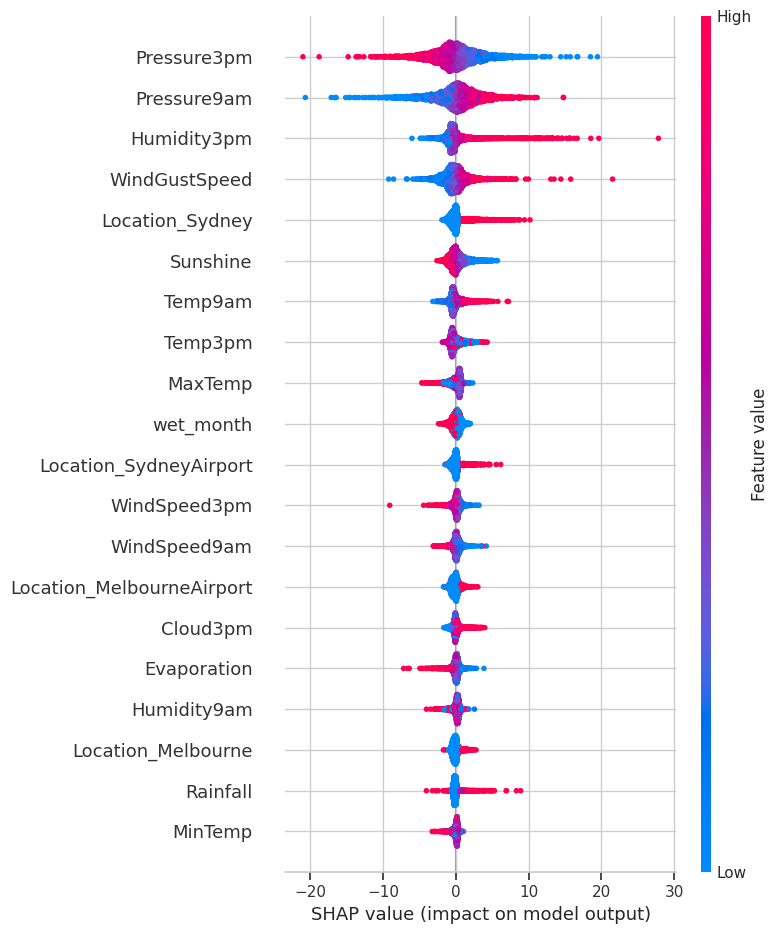

In [304]:
# Graficar los valores SHAP con nombres de características
shap.summary_plot(shap_values, X_test_scaled, feature_names=feature_names)
plt.show()

Observando en más detalle, se encuentra que las presiones, aunque ambas aportan la mayor contribución a la explicabilidad, mientras la presion para las 3 pm al tener valores mayores en las filas de datos, tiene una contribución negativa a los valores de SHAP y viceversa, sucede lo contrairo con las presiones a la 9 am, que tienen una contribución positiva mientras mayores sean los valores en las filas y negativa mientras menores sean los valores de la variable en las filas.

Para humedad y velocidad del viento, mientras mayores sean los valores de las variables en las filas, los valores de shap son positivos y aumentan y mientras menores sean los valores de las variables, serán negativos los valores de shap y disminuirán.

En resumen, para el modelo entrenado, las features que más contribuyen al resultado de predecir RainfallTomorrow con un determinado valor son Pressure3pm, Pressure9am, humidity y WindGustSpeed y cada una de ellas tenderá a desplazar el valor positiva o negativamente según lo planteado en los párrafos anteriores.

---
# Trabajo Práctico parte 2

## 1 - Crear el dataset para clasificación

In [307]:
# Crear weatherAUS_LogR sin la columna 'RainfallTomorrow'
weatherAUS_LogR = weatherAUS_models.drop(columns=['RainfallTomorrow'])

# Excluir columnas de la dirección del viento
columns_to_exclude = [col for col in weatherAUS_LogR.columns if "Dir" in col]
weatherAUS_LogR.drop(columns=columns_to_exclude, inplace = True)

## 2 - Separar conjuntos de Entrenamiento y de Prueba


In [308]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_logr, X_test_logr, y_train_logr, y_test_logr = train_test_split(weatherAUS_LogR.drop('RainTomorrow_Yes', axis=1),
                                                   weatherAUS_LogR['RainTomorrow_Yes'].values.reshape(-1, 1),
                                                   test_size=0.2,
                                                   random_state=7)

In [309]:
# Estandarizar las características
scaler = StandardScaler()
X_train_scaled_lr = scaler.fit_transform(X_train_logr)
X_test_scaled_lr = scaler.transform(X_test_logr)

## 3 - Modelos base para la clasificación

### 2.1 - Clasificación basada en la mayoría

En este enfoque, se clasifican todos los ejemplos en la clase mayoritaria, que es la clase que ocurre con más frecuencia en la columna 'RainTomorrow'.

Precisión del Modelo Base (Clasificación Mayoritaria) en el Conjunto de Prueba: 75.94%
Exactitud (Accuracy): 0.759
Precisión (Precision): 0.000
Recall (Sensibilidad): 0.000
Puntaje F1 (F1 Score): 0.000


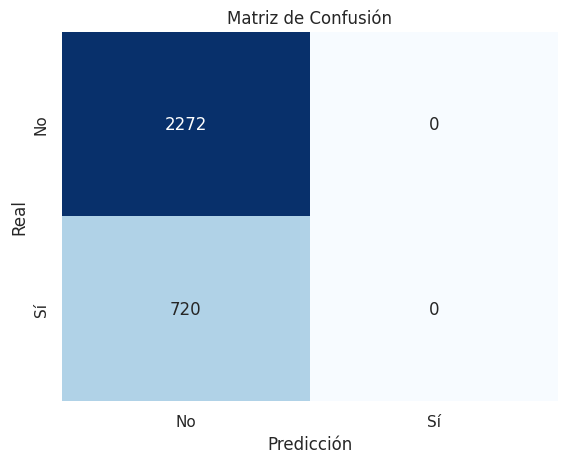

In [310]:
# Modelo de Clasificación Basada en la Mayoría
df_train = pd.DataFrame(y_train_logr.copy(), columns = ['RainTomorrow_Yes'])
clase_mayoritaria = df_train['RainTomorrow_Yes'].mode().iloc[0]
df_test = pd.DataFrame(y_test_logr.copy(), columns = ['RainTomorrow_Yes'])
df_test['Prediccion_Mayoritaria'] = clase_mayoritaria

# Evaluar la precisión del modelo base de clasificación basada en la mayoría en el conjunto de prueba
precision_mayoritaria = accuracy_score(df_test['RainTomorrow_Yes'], df_test['Prediccion_Mayoritaria'])
print(f'Precisión del Modelo Base (Clasificación Mayoritaria) en el Conjunto de Prueba: {precision_mayoritaria:.2%}')
# Evaluar la precisión del modelo base
accuracy = accuracy_score(df_test['RainTomorrow_Yes'], df_test['Prediccion_Mayoritaria'])
precision = precision_score(df_test['RainTomorrow_Yes'], df_test['Prediccion_Mayoritaria'])
recall = recall_score(df_test['RainTomorrow_Yes'], df_test['Prediccion_Mayoritaria'])
f1 = f1_score(df_test['RainTomorrow_Yes'], df_test['Prediccion_Mayoritaria'])

# Imprime las métricas de evaluación
print(f"Exactitud (Accuracy): {accuracy:.3f}")
print(f"Precisión (Precision): {precision:.3f}")
print(f"Recall (Sensibilidad): {recall:.3f}")
print(f"Puntaje F1 (F1 Score): {f1:.3f}")

# Calcular la matriz de confusión
matriz_confusion = confusion_matrix(df_test['RainTomorrow_Yes'], df_test['Prediccion_Mayoritaria'])

# Visualizar la matriz de confusión con Seaborn
sns.heatmap(matriz_confusion, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No', 'Sí'], yticklabels=['No', 'Sí'])
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.title('Matriz de Confusión')
plt.show()

### 2.2 - Clasificación basada en criterio ingenuo

Se utiliza un criterio simple, como predecir que lloverá mañana si hoy está lloviendo.

Exactitud (Accuracy): 0.737
Precisión (Precision): 0.452
Recall (Sensibilidad): 0.440
Puntaje F1 (F1 Score): 0.446


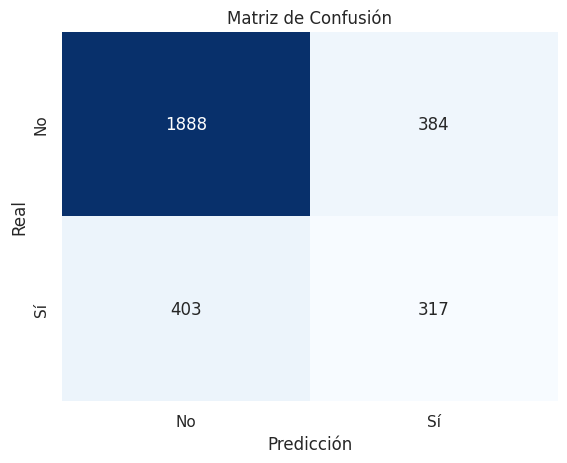

In [311]:
# Modelo de Clasificación criterio ingenuo
df_test = pd.DataFrame(y_test_logr, columns = ['RainTomorrow_Yes'])
df_test_x = pd.DataFrame(X_test_logr, columns = ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm', 'RainfallTomorrow', 'wet_month', 'RainToday_Yes',
       'Location_Melbourne', 'Location_MelbourneAirport',
       'Location_Sydney', 'Location_SydneyAirport'])
df_test['Prediccion_Criterio_Ingenuo'] = (df_test_x['RainToday_Yes'] == 1).astype(int).tolist()

# Evaluar la precisión del modelo base
accuracy = accuracy_score(df_test['RainTomorrow_Yes'], df_test['Prediccion_Criterio_Ingenuo'])
precision = precision_score(df_test['RainTomorrow_Yes'], df_test['Prediccion_Criterio_Ingenuo'])
recall = recall_score(df_test['RainTomorrow_Yes'], df_test['Prediccion_Criterio_Ingenuo'])
f1 = f1_score(df_test['RainTomorrow_Yes'], df_test['Prediccion_Criterio_Ingenuo'])

# Imprime las métricas de evaluación
print(f"Exactitud (Accuracy): {accuracy:.3f}")
print(f"Precisión (Precision): {precision:.3f}")
print(f"Recall (Sensibilidad): {recall:.3f}")
print(f"Puntaje F1 (F1 Score): {f1:.3f}")

# Calcular la matriz de confusión
matriz_confusion = confusion_matrix(df_test['RainTomorrow_Yes'], df_test['Prediccion_Criterio_Ingenuo'])

# Visualizar la matriz de confusión con Seaborn
sns.heatmap(matriz_confusion, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No', 'Sí'], yticklabels=['No', 'Sí'])
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.title('Matriz de Confusión')
plt.show()

### 2.3 - Clasificación basada en series temporales:

Considerando que el modelo base basado en criterio ingenuo tiene menor exactitud que el modelo base basado en la mayoría, pero que tiene un mejor desempeño a la hora de clasificar correctamente cuando si ha llovido se explorará más a fondo la ditribución de las variables objetivo con respecto al tiempo, ya que con el modelo ingenuo, al considerar sencillamente si ha llovido o no el día anterior ha obtenido una mejora en la predicción, por lo que se intuye que ajustando la ventana de días en base a un análisis más detallado se podría mejorar el modelo base para futuras comparaciones con modelos más complejos.

In [312]:
df_aux = weatherAUS_df.dropna().copy()
df_aux['Date'] = pd.to_datetime(df_aux['Date'])

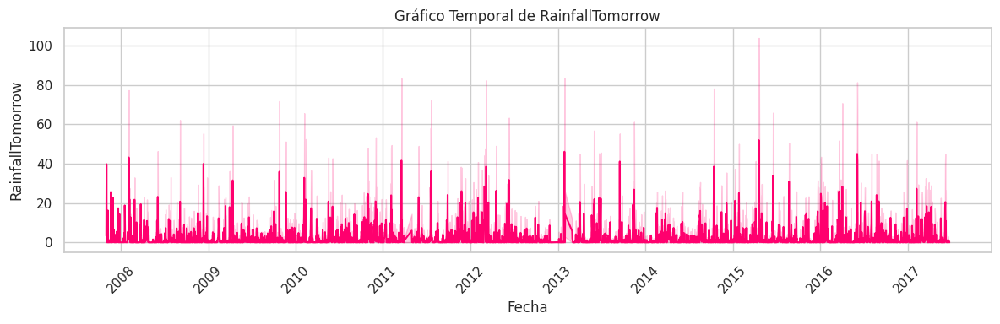

In [313]:
# Crear gráficos temporales para cada columna numérica con colores diferentes

plt.figure(figsize=(12, 4))
sns.lineplot(x='Date', y='RainfallTomorrow', data=df_aux, color='#ff006e')
plt.title('Gráfico Temporal de RainfallTomorrow')
plt.xlabel('Fecha')
plt.ylabel('RainfallTomorrow')
plt.xticks(rotation=45)  # Rotar las etiquetas del eje x para mayor claridad
plt.tight_layout()
plt.show()

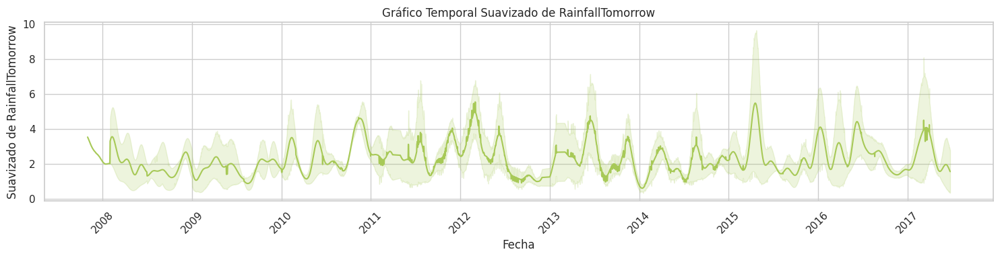

In [314]:
import scipy.signal as signal

# Función para aplicar suavizado de kernel gaussiano a una serie de datos
def smooth_data(data, window_size):
    kernel = signal.gaussian(window_size, std=window_size / 6)
    smoothed = signal.convolve(data, kernel, mode='same') / sum(kernel)
    return smoothed


# Ventana de suavizado
window_size = 100

# Crear gráfico temporal suavizado
plt.figure(figsize=(15, 4))

# Aplicar suavizado de kernel gaussiano a los datos
smoothed_data = smooth_data(df_aux['RainfallTomorrow'], window_size)

sns.lineplot(x='Date', y=smoothed_data, data=df_aux, color='#a7c957')
plt.title(f'Gráfico Temporal Suavizado de RainfallTomorrow')
plt.xlabel('Fecha')
plt.ylabel(f'Suavizado de RainfallTomorrow')
plt.xticks(rotation=45)  # Rotar las etiquetas del eje x para mayor claridad
plt.tight_layout()
plt.show()

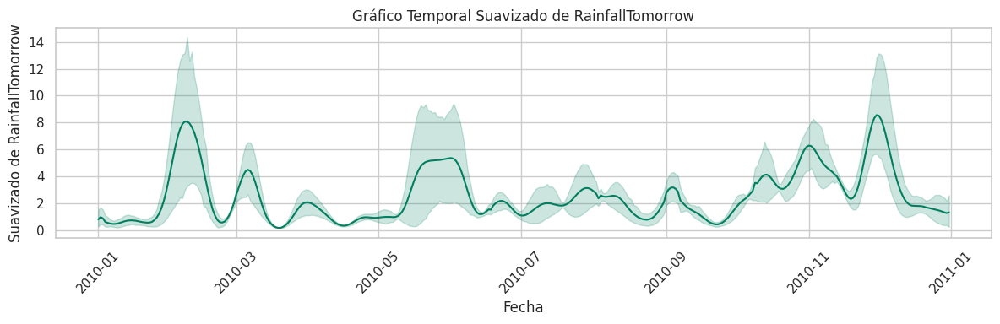

In [315]:
# Ventana de suavizado
window_size = 25

# Crear gráfico temporal suavizado
plt.figure(figsize=(12, 4))

# Aplicar suavizado de kernel gaussiano a los datos
smoothed_data = smooth_data(df_aux[df_aux['Date'].dt.year == 2010]['RainfallTomorrow'], window_size)

sns.lineplot(x='Date', y=smoothed_data, data=df_aux[df_aux['Date'].dt.year == 2010], color='#007f5f')
plt.title(f'Gráfico Temporal Suavizado de RainfallTomorrow')
plt.xlabel('Fecha')
plt.ylabel(f'Suavizado de RainfallTomorrow')
plt.xticks(rotation=45)  # Rotar las etiquetas del eje x para mayor claridad
plt.tight_layout()
plt.show()

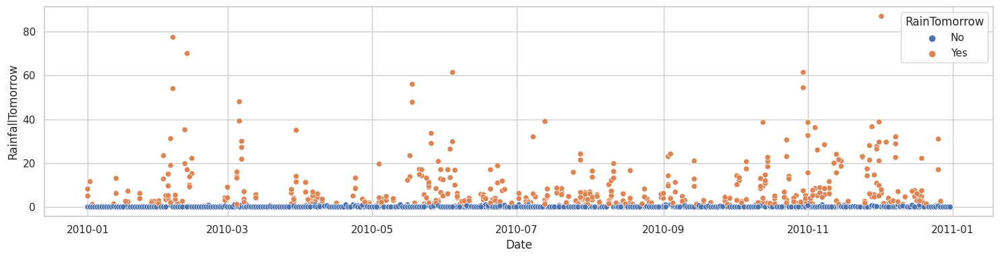

In [316]:
plt.figure(figsize=(15, 4))
sns.scatterplot(x='Date', y='RainfallTomorrow', data=df_aux[df_aux['Date'].dt.year == 2010], hue='RainTomorrow')
plt.tight_layout()
plt.show()

In [317]:
df = weatherAUS_LogR.copy()
df['Date'] = df_aux['Date']
df['Date'] = pd.to_datetime(df['Date'])
df['RainfallTomorrow'] = df_aux['RainfallTomorrow']
df = df.sort_values(by='Date')

# Crear una columna 'Dias_Desde_Cambio' que indica la cantidad de días desde el último cambio en 'RainTomorrow'
df['Dias_desde_cambio'] = (df['RainTomorrow_Yes'] != df['RainTomorrow_Yes'].shift(1)).cumsum()

# Filtrar solo las filas donde hay un cambio en 'RainTomorrow' (de 'No' a 'Yes')
cambios = df[df['RainTomorrow_Yes'] == 1]

# Calcular la cantidad de días desde el último cambio hasta el cambio actual
cambios['Dias_desde_ultimo_cambio'] = cambios['Date'].diff().dt.days

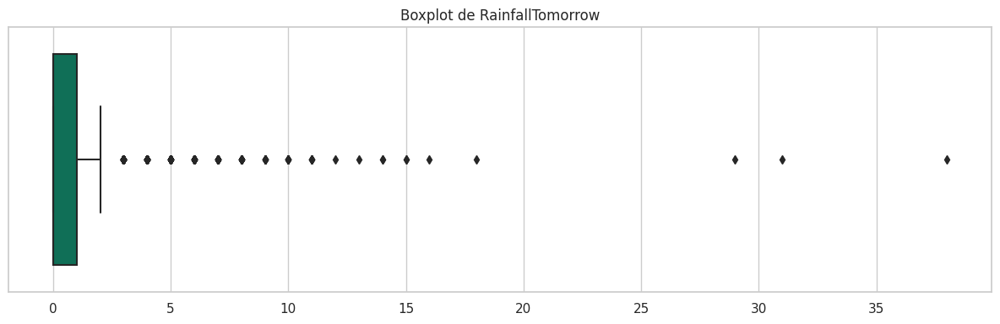

In [318]:
plt.figure(figsize=(12, 4))

# Generar boxplot
sns.boxplot(data=cambios, x='Dias_desde_ultimo_cambio', color='#007f5f', orient='h')
plt.title(f'Boxplot de RainfallTomorrow')
plt.xlabel('')
plt.tight_layout()
plt.show()

In [319]:
# Calcular el promedio de días desde la última lluvia
promedio_dias_desde_ultima_lluvia = cambios['Dias_desde_ultimo_cambio'].mean()
desviacion_dias_desde_ultima_lluvia = cambios['Dias_desde_ultimo_cambio'].std()
cuartil_dias_desde_ultima_lluvia = cambios['Dias_desde_ultimo_cambio'].quantile(0.95)

# Imprimir los resultados
print(cambios[cambios['Date'].dt.year == 2008][['Date', 'RainTomorrow_Yes', 'Dias_desde_ultimo_cambio']].head(10))
print(f"En promedio, se registra lluvia cada {promedio_dias_desde_ultima_lluvia:.2f} días con una desviación estándar de {desviacion_dias_desde_ultima_lluvia:.2f}")
print(f"El valor del cuartil para el 95% indica que se registra lluvia cada {cuartil_dias_desde_ultima_lluvia:.2f}")

            Date  RainTomorrow_Yes  Dias_desde_ultimo_cambio
45645 2008-01-12                 1                      16.0
45649 2008-01-16                 1                       4.0
45651 2008-01-18                 1                       2.0
45652 2008-01-19                 1                       1.0
45663 2008-01-30                 1                      11.0
45664 2008-01-31                 1                       1.0
30167 2008-02-01                 1                       1.0
30168 2008-02-02                 1                       1.0
45667 2008-02-03                 1                       1.0
30169 2008-02-03                 1                       0.0
En promedio, se registra lluvia cada 1.01 días con una desviación estándar de 1.92
El valor del cuartil para el 95% indica que se registra lluvia cada 4.00


Exactitud (Accuracy): 0.666
Precisión (Precision): 0.399
Recall (Sensibilidad): 0.764
Puntaje F1 (F1 Score): 0.524


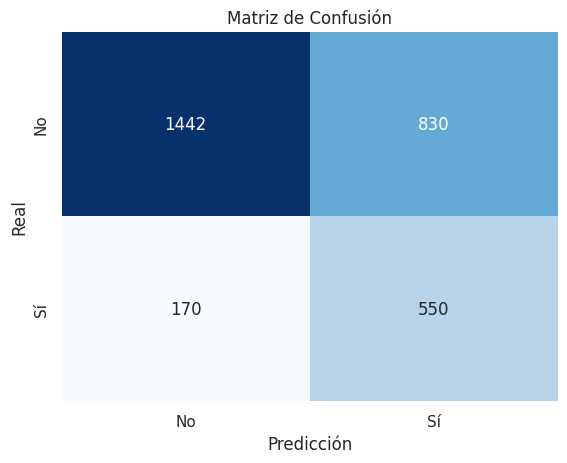

In [320]:
# Seleccionar la variable objetivo y la variable temporal (por ejemplo, 'RainTomorrow_Yes' y 'Date')
target_variable = 'RainfallTomorrow'

# Crear un modelo base de clasificación binaria
def modelo_base_clasificacion_binaria(datos, ventana, y_test):
    # Calcular la tasa de lluvia en la ventana móvil
    datos['Tasa_Lluvia'] = valores_seleccionados.rolling(window=ventana).mean()

    # Aplicar una condición simple: si la tasa de lluvia es mayor que un umbral, predecir lluvia, de lo contrario, no lluvia
    umbral = 1.2

    # Crear una nueva columna basada en la condición
    y_test['Prediccion'] = np.where(datos['Tasa_Lluvia'] >= umbral, 1, 0)


    return datos

# Modelo de Clasificación series temporales
df_test_t = pd.DataFrame(y_test_logr, columns = ['RainTomorrow_Yes'])
df_test_t_x = pd.DataFrame(X_test_logr , columns = ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm', 'RainfallTomorrow', 'wet_month', 'RainToday_Yes',
       'Location_Melbourne', 'Location_MelbourneAirport', 'Location_Sydney',
       'Location_SydneyAirport'])

# Aplicar el modelo base de clasificación binaria
ventana_modelo_base = 4
# Obtener los valores de RainfallTomorrow' en weatherAUS_models para las filas cuyos índices coinciden con df_test_t_x
valores_seleccionados = weatherAUS_models.loc[df_test_t_x.index, 'RainfallTomorrow']
df = modelo_base_clasificacion_binaria(df_test_t_x, ventana_modelo_base, df_test)

# Evaluar la precisión del modelo base
accuracy = accuracy_score(df_test['RainTomorrow_Yes'], df_test['Prediccion'])
precision = precision_score(df_test['RainTomorrow_Yes'], df_test['Prediccion'])
recall = recall_score(df_test['RainTomorrow_Yes'], df_test['Prediccion'])
f1 = f1_score(df_test['RainTomorrow_Yes'], df_test['Prediccion'])

# Imprime las métricas de evaluación
print(f"Exactitud (Accuracy): {accuracy:.3f}")
print(f"Precisión (Precision): {precision:.3f}")
print(f"Recall (Sensibilidad): {recall:.3f}")
print(f"Puntaje F1 (F1 Score): {f1:.3f}")

# Calcular la matriz de confusión
matriz_confusion = confusion_matrix(df_test['RainTomorrow_Yes'], df_test['Prediccion'])

# Visualizar la matriz de confusión con Seaborn
sns.heatmap(matriz_confusion, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No', 'Sí'], yticklabels=['No', 'Sí'])
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.title('Matriz de Confusión')
plt.show()

## 3 - Utilizar SMOTE (Synthetic Minority Over-sampling Technique) para corregir el desbalance de clases
El método SMOTE (Synthetic Minority Over-sampling Technique) es una técnica que genera muestras sintéticas de la clase minoritaria. El proceso es el siguiente:
1. **Selección de una instancia minoritaria**: Para aplicar SMOTE, primero se elige una instancia de la clase minoritaria en el conjunto de datos desequilibrado.

2. **Selección de vecinos cercanos**: Luego, SMOTE selecciona k vecinos cercanos a esta instancia. El valor de k se elige de antemano y se utiliza para determinar cuántas instancias sintéticas se generarán.

3. **Generación de instancias sintéticas**: Para crear una instancia sintética, SMOTE elige uno de los k vecinos cercanos y calcula la diferencia entre la instancia seleccionada inicialmente y el vecino elegido. Luego, multiplica esta diferencia por un número aleatorio entre 0 y 1 y lo suma a la instancia inicial. Esto crea una nueva instancia en el espacio de características que se encuentra a lo largo de la línea que conecta la instancia inicial y el vecino seleccionado.

4. **Repetición del proceso**: Este proceso se repite para cada instancia minoritaria en el conjunto de datos, generando un conjunto de datos equilibrado con un número igual de instancias en ambas clases.

In [321]:
# Contar la cantidad de filas con el valor "1" en la columna "RainTomorrow_Yes"
cantidad_1 = len(weatherAUS_LogR[weatherAUS_LogR['RainTomorrow_Yes'] == 1])

# Contar la cantidad de filas con el valor "0" en la columna "RainTomorrow_Yes"
cantidad_0 = len(weatherAUS_LogR[weatherAUS_LogR['RainTomorrow_Yes'] == 0])

print("Cantidad de filas con 'RainTomorrow_Yes' igual a 1:", cantidad_1)
print("Cantidad de filas con 'RainTomorrow_Yes' igual a 0:", cantidad_0)

Cantidad de filas con 'RainTomorrow_Yes' igual a 1: 3505
Cantidad de filas con 'RainTomorrow_Yes' igual a 0: 11453


Podemos ver que está muy desbalanceado, por lo que debe utilizarse un método de balanceo de clases como asignar pesos diferentes, oversampling o undersampling. Pero primero, se debe los conjuntos de entrenamiento y de prueba.

In [322]:
# Crear una instancia de SMOTE
smote = SMOTE()

# Aplicar SMOTE al conjunto de entrenamiento para aumentar las instancias de la clase minoritaria
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled_lr, y_train_logr)

In [323]:
# Contar la cantidad de 1 y 0 en y_train_resample
count_1 = np.bincount(y_train_resampled)[1]  # Cuenta la cantidad de 1
count_0 = np.bincount(y_train_resampled)[0]  # Cuenta la cantidad de 0

print(f"Cantidad de 1 en y_train_resample: {count_1}")
print(f"Cantidad de 0 en y_train_resample: {count_0}")

Cantidad de 1 en y_train_resample: 9181
Cantidad de 0 en y_train_resample: 9181


Ahora puede verse como el dataset está balanceado

## 4 - Visualizar distribuciónes de características

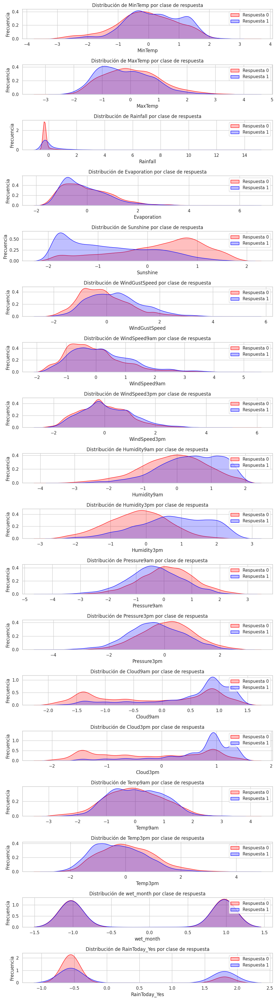

In [324]:
# Crear DataFrames a partir de los arreglos NumPy
X_train_resampled_df = pd.DataFrame(X_train_resampled, columns=X_train_logr.columns)
y_train_resampled_df = pd.DataFrame(y_train_resampled, columns=['Response'])

# Concatenar los DataFrames horizontalmente
data = pd.concat([X_train_resampled_df, y_train_resampled_df], axis=1)

# Eliminar las columnas que contienen 'Location' en el nombre
data = data.loc[:, ~data.columns.str.contains('Location')]

# Obtener las características
features = data.columns[:-1]

# Colores para las áreas (rojo y azul)
colors = ['red', 'blue']

# Crear una figura con subgráficos para cada característica
fig, axes = plt.subplots(nrows=len(features), ncols=1, figsize=(10, 2 * len(features)))

# Iterar a través de las características
for i, feature in enumerate(features):
    # Dividir los datos según la variable respuesta (0 y 1)
    for response_value, color in zip([0, 1], colors):
        subset = data[data['Response'] == response_value]
        sns.kdeplot(data=subset, x=feature, ax=axes[i], fill=True, color=color, label=f'Respuesta {response_value}')

    # Configuraciones del gráfico
    axes[i].set_title(f'Distribución de {feature} por clase de respuesta')
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('Frecuencia')
    axes[i].legend(loc='best')

# Ajustar el espacio entre los subgráficos
plt.tight_layout()

# Mostrar el gráfico
plt.show()


Observando las distribuciones de features según su respuesta se puede notar que muchas de ellas están muy unidas para ambas respuestas y presentan una clarisima distinción exeptuando dos de ellas. Las horas diarias de sol y la humedad a las 3pm son características importantes para distinguir entre clases.

## 5 - Entrenamiento del modelo

In [325]:
logistic_model = LogisticRegression(random_state=42)
logistic_model.fit(X_train_resampled, y_train_resampled)

LogisticRegression(random_state=42)

### 5.1 - Entrenamiento del modelo para distintos folds de validacón y comparación de gráficas de ROC.

In [326]:
logisticr_model = LogisticRegression(random_state=42)

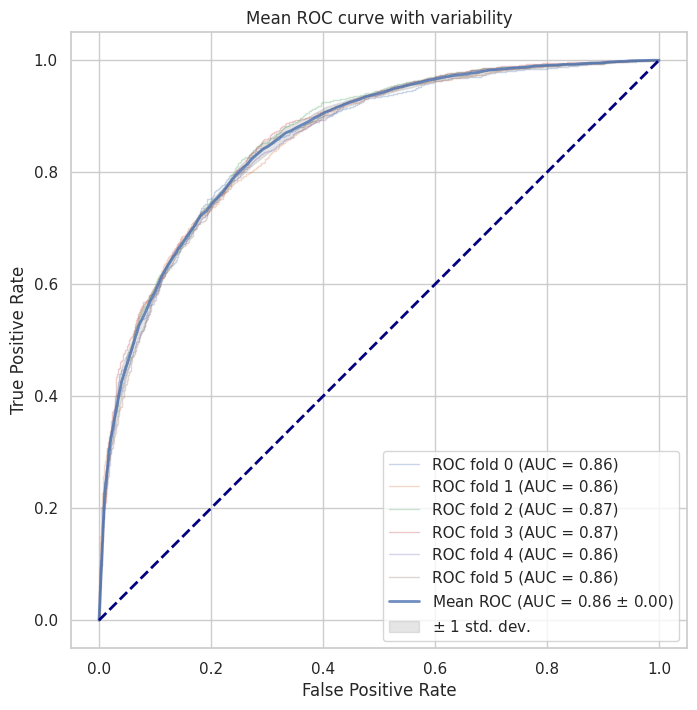

In [327]:
n_splits = 6
cv = StratifiedKFold(n_splits=n_splits)

tprs = []
aucs = []
mean_fpr = np.linspace(0, 1, 100)

fig, ax = plt.subplots(figsize=(15, 8))
for fold, (train, test) in enumerate(cv.split(X_train_resampled, y_train_resampled)):
    dfX_train_resampled = pd.DataFrame(X_train_resampled)
    index_labels = dfX_train_resampled.index
    seriey_train_resampled = pd.Series(y_train_resampled, index=index_labels)
    logisticr_model.fit(dfX_train_resampled.iloc[train] , seriey_train_resampled.iloc[train])
    viz = RocCurveDisplay.from_estimator(
        logisticr_model,
        dfX_train_resampled.iloc[test],
        seriey_train_resampled.iloc[test],
        name=f"ROC fold {fold}",
        alpha=0.3,
        lw=1,
        ax=ax,

    )
    interp_tpr = np.interp(mean_fpr, viz.fpr, viz.tpr)
    interp_tpr[0] = 0.0
    tprs.append(interp_tpr)
    aucs.append(viz.roc_auc)

mean_tpr = np.mean(tprs, axis=0)
mean_tpr[-1] = 1.0
mean_auc = auc(mean_fpr, mean_tpr)
std_auc = np.std(aucs)
ax.plot(
    mean_fpr,
    mean_tpr,
    color="b",
    label=r"Mean ROC (AUC = %0.2f $\pm$ %0.2f)" % (mean_auc, std_auc),
    lw=2,
    alpha=0.8,
)

std_tpr = np.std(tprs, axis=0)
tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
ax.fill_between(
    mean_fpr,
    tprs_lower,
    tprs_upper,
    color="grey",
    alpha=0.2,
    label=r"$\pm$ 1 std. dev.",
)

ax.set(
    xlim=[-0.05, 1.05],
    ylim=[-0.05, 1.05],
    xlabel="False Positive Rate",
    ylabel="True Positive Rate",
    title=f"Mean ROC curve with variability",
)
ax.axis("square")
ax.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
ax.legend(loc="lower right")
plt.show()

Al no utilizar el conjunto de test en la validación cruzada, se tienen sets de validación diferentes en cadaa fold. Se puede destacar, por lo observado en el gráfico, que el rendimiento del modelo es prácticamente igual en cada fold de validación. Da indicio de que las predicciones del modelo para conjuntos de datos que no son conocidos pueden considerarse confiables.

## 6 - Métricas
Las métricas de evaluación son herramientas utilizadas para medir el rendimiento de los modelos de aprendizaje automático. Ayudan a comprender cómo se desempeña un modelo en la tarea para la que fue entrenado.

### 6.1 - Accuracy, Precision, Recall, F1-Score y matriz de confusión.

Exactitud (Accuracy): 0.790
Precisión (Precision): 0.545
Recall (Sensibilidad): 0.769
Puntaje F1 (F1 Score): 0.638


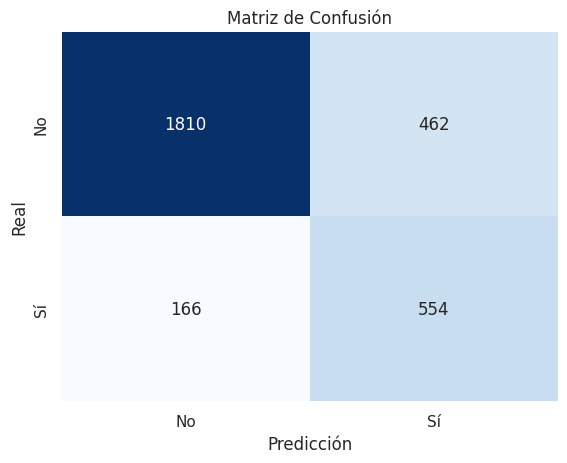

In [328]:
# Realiza las predicciones con tu modelo
y_pred_logr = logistic_model.predict(X_test_scaled_lr)

# Calcula las métricas de evaluación
accuracy = accuracy_score(y_test_logr, y_pred_logr)
precision = precision_score(y_test_logr, y_pred_logr)
recall = recall_score(y_test_logr, y_pred_logr)
f1 = f1_score(y_test_logr, y_pred_logr)
# Calcula la matriz de confusión
conf_matrix = confusion_matrix(y_test_logr, y_pred_logr)

# Imprime las métricas de evaluación
print(f"Exactitud (Accuracy): {accuracy:.3f}")
print(f"Precisión (Precision): {precision:.3f}")
print(f"Recall (Sensibilidad): {recall:.3f}")
print(f"Puntaje F1 (F1 Score): {f1:.3f}")

# Visualizar la matriz de confusión con Seaborn
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No', 'Sí'], yticklabels=['No', 'Sí'])
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.title('Matriz de Confusión')
plt.show()

La exactitud indica que la proporción de predicciones correctas en el conjunto de datos es de 79%.

La precisión se refiere a la proporción de predicciones positivas que fueron correctas. Un valor de 0.533 indica que el 54,4% de las predicciones positivas fueron correctas.

La sensibilidad mide la proporción de verdaderos positivos identificados correctamente en comparación con todos los casos positivos reales. Un valor de 0.775 indica que se capturan el 77,5% de los casos positivos. Dado que la predicción de lluvia puede tener un impacto significativo en la planificación y la toma de decisiones, es importante que el modelo tenga una alta sensibilidad. En este caso, una alta sensibilidad significa que el modelo identificará la mayoría de las instancias en las que lloverá, minimizando los falsos negativos, lo que es crucial para garantizar que las personas estén preparadas si se espera lluvia.

El puntaje F1 es una métrica que combina precisión y recall en un solo número. Un valor de 0.64 es bastante equilibrado y sugiere un buen equilibrio entre precisión y sensibilidad.

En general, el modelo tiene un buen rendimiento. La alta sensibilidad (recall) indica que el modelo es efectivo para identificar la mayoría de los casos positivos (días de lluvia), mientras que la precisión razonable sugiere que las predicciones positivas son en su mayoría correctas. El puntaje F1 de 0.64 indica un equilibrio entre precisión y recall. Con un recall (sensibilidad) de 0.775 y una precisión de 0.544, parece que el modelo tiene una buena capacidad para identificar días de lluvia, pero también emite algunas falsas alarmas.

Pero para evaluar de manera más completa el modelo hay que tener en cuenta la curva ROC (Receiver Operating Characteristic) y el AUC (Area Under the Curve).

### 6.2 - ROC (Receiver Operating Characteristic) y  AUC (Area Under the Curve)
La curva ROC es una representación gráfica que se utiliza para evaluar el rendimiento de un clasificador binario en función de sus umbrales de decisión. La curva muestra la relación entre la tasa de verdaderos positivos (sensibilidad) y la tasa de falsos positivos (1 - especificidad) a medida que se varía el umbral de decisión.

El AUC, o Área Bajo la Curva, es un valor numérico que se calcula a partir de la curva ROC. Representa la medida de rendimiento global de un clasificador binario. Cuanto mayor sea el AUC, mejor será el rendimiento del clasificador.


In [329]:
# Obtengo las probabilidades de predicción del modelo
y_probs = logistic_model.predict_proba(X_test_scaled_lr)[:, 1]

# Calculo la ROC y el AUC
fpr, tpr, thresholds = roc_curve(y_test_logr, y_probs)
roc_auc = auc(fpr, tpr)

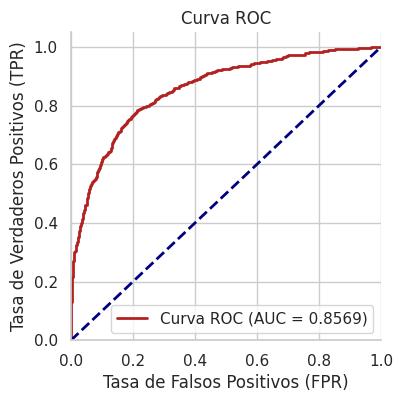

In [330]:
# Grafico la curva ROC
plt.figure(figsize=(4, 4))
sns.set(style="whitegrid")
plt.plot(fpr, tpr, color='firebrick', lw=2, label='Curva ROC (AUC = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos (FPR)')
plt.ylabel('Tasa de Verdaderos Positivos (TPR)')
plt.title('Curva ROC')
plt.legend(loc="lower right")
sns.despine()
plt.show()

In [331]:
print(f"ROC AUC: {roc_auc:.4f}")

ROC AUC: 0.8569


Un AUC de 0.8572 está aceptablemente próximo a 1, lo que significa que el modelo tiene un alto grado de separación entre las dos clases (lluvia y no lluvia) en términos de sus probabilidades predichas. Esto indica que la capacidad del modelo para clasificar correctamente la mayoría de las instancias, lo cual es fundamental en la predicción de lluvia, donde la sensibilidad es una métrica importante.

Se obtiene en todos los folds un rendimiento considerablemente alto. El modelo ha aprendido de los datos a clasificar correctamente días de lluvia y días sin lluvia.

Se esperaba obtener valores elevados para los folds dado el rendimiento observado anteriormente.

## 7 - Tunning de hiperparámetros para la Regresión Logística

Dado que el modelo tiene un rendimiento significativamente elevado, se hará uso de RandomizedSearchCV en lugar de GridSearchCV ya que,  por lo dicho, no se pretende realizar una búsqueda tan exhaustiva que utilice muchos recusros.

In [332]:
def print_dataframe(filtered_cv_results):
    ### Un print bonito de los resultados de cross validation
    for mean_precision, std_precision, mean_recall, std_recall, params in zip(
        filtered_cv_results["mean_test_precision"],
        filtered_cv_results["std_test_precision"],
        filtered_cv_results["mean_test_recall"],
        filtered_cv_results["std_test_recall"],
        filtered_cv_results["params"],
    ):
        print(
            f"precision: {mean_precision:0.3f} (±{std_precision:0.03f}),"
            f" recall: {mean_recall:0.3f} (±{std_recall:0.03f}),"
            f" para {params}"
        )
    print()


def refit_strategy(cv_results):
    """Definir la estrategia para seleccionar el mejor estimador.

    La estrategia definida aquí es filtrar todos los resultados por debajo de un umbral de precisión
    de 0,7, y de los que queden mantener todos los modelos con un una desviación estándar de la mejor en recall.
    Una vez seleccionados estos modelos, se puede seleccionar el modelo más rápido de predecir.

    Parámetros
    ----------
    cv_results: diccionario de ndarrays numpy (masked)
        Resultados del CV devueltos por `RandomizedSearchCV`.

    Returns
    -------
    mejor_índice: int
        El índice del mejor estimador tal como aparece en `cv_results`

    """
    # print the info about the random-search for the different scores
    precision_threshold = 0.7

    cv_results_ = pd.DataFrame(cv_results)

    # Filter-out all results below the threshold
    high_precision_cv_results = cv_results_[
        cv_results_["mean_test_precision"] > precision_threshold
    ]

    high_precision_cv_results = high_precision_cv_results[
        [
            "mean_score_time",
            "mean_test_recall",
            "std_test_recall",
            "mean_test_precision",
            "std_test_precision",
            "rank_test_recall",
            "rank_test_precision",
            "params",
        ]
    ]

    # Select the most performant models in terms of recall
    # (within 1 sigma from the best)
    best_recall_std = high_precision_cv_results["mean_test_recall"].std()
    best_recall = high_precision_cv_results["mean_test_recall"].max()
    best_recall_threshold = best_recall - best_recall_std

    high_recall_cv_results = high_precision_cv_results[
        high_precision_cv_results["mean_test_recall"] > best_recall_threshold
    ]
    print(
        'Modelos con los mejores rendimiientos de precision y recall'
    )
    print_dataframe(high_recall_cv_results)

    # From the best candidates, select the fastest model to predict
    fastest_top_recall_high_precision_index = high_recall_cv_results[
        "mean_score_time"
    ].idxmin()

    print(
        "El siguiente modelo es el más rápdo para realizar predicciones de los \n"
        "anteriores con mejores rendimientos en precision y recall\n"
        "El tiempo utilizado es is:\n\n"
        f"{high_recall_cv_results.loc[fastest_top_recall_high_precision_index]}"
    )

    return fastest_top_recall_high_precision_index

In [333]:
scores = ["precision", "recall"]

tuned_parameters = [
    {"class_weight": [None, 'balanced'], "C": [0.007, 0.01, 0.1, 1, 10, 100], "solver": ['lbfgs', 'liblinear', 'newton-cholesky'], "max_iter": [200, 500, 700, 1000]}
]

random_search = RandomizedSearchCV(
    LogisticRegression(random_state=42), tuned_parameters, scoring=scores, refit=refit_strategy
)
random_search.fit(X_train_resampled, y_train_resampled)

Modelos con los mejores rendimiientos de precision y recall
precision: 0.772 (±0.010), recall: 0.771 (±0.009), para {'solver': 'liblinear', 'max_iter': 700, 'class_weight': 'balanced', 'C': 0.007}

El siguiente modelo es el más rápdo para realizar predicciones de los 
anteriores con mejores rendimientos en precision y recall
El tiempo utilizado es is:

mean_score_time                                                  0.01546
mean_test_recall                                                 0.77105
std_test_recall                                                 0.009302
mean_test_precision                                             0.771669
std_test_precision                                              0.009962
rank_test_recall                                                       1
rank_test_precision                                                   10
params                 {'solver': 'liblinear', 'max_iter': 700, 'clas...
Name: 6, dtype: object


RandomizedSearchCV(estimator=LogisticRegression(random_state=42),
                   param_distributions=[{'C': [0.007, 0.01, 0.1, 1, 10, 100],
                                         'class_weight': [None, 'balanced'],
                                         'max_iter': [200, 500, 700, 1000],
                                         'solver': ['lbfgs', 'liblinear',
                                                    'newton-cholesky']}],
                   refit=<function refit_strategy at 0x7f20b7b88af0>,
                   scoring=['precision', 'recall'])

Existen pocas opciones en combinaciones de hiperparámetros que permiten un destacado rendimiento del modelo. A continuación se seleccionarán los mejores y se observará el rendimiento utilizando los mismos.

Exactitud (Accuracy): 0.785
Precisión (Precision): 0.537
Recall (Sensibilidad): 0.769
Puntaje F1 (F1 Score): 0.632


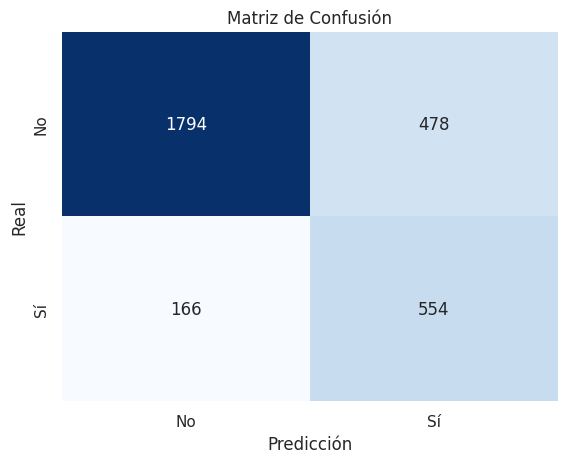

In [335]:
best_random_params = random_search.best_params_
best_random_model = LogisticRegression(**best_random_params, random_state=42)
best_random_model.fit(X_train_resampled, y_train_resampled)

# Realiza las predicciones con tu modelo
y_pred_logr = best_random_model.predict(X_test_scaled_lr)

# Calcula las métricas de evaluación
accuracy = accuracy_score(y_test_logr, y_pred_logr)
precision = precision_score(y_test_logr, y_pred_logr)
recall = recall_score(y_test_logr, y_pred_logr)
f1 = f1_score(y_test_logr, y_pred_logr)

# Imprime las métricas de evaluación
print(f"Exactitud (Accuracy): {accuracy:.3f}")
print(f"Precisión (Precision): {precision:.3f}")
print(f"Recall (Sensibilidad): {recall:.3f}")
print(f"Puntaje F1 (F1 Score): {f1:.3f}")

# Calcular la matriz de confusión
matriz_confusion = confusion_matrix(y_test_logr, y_pred_logr)

# Visualizar la matriz de confusión con Seaborn
sns.heatmap(matriz_confusion, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No', 'Sí'], yticklabels=['No', 'Sí'])
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.title('Matriz de Confusión')
plt.show()

Se ha mejorado el recall, que es a lo que se le da prioridad en el enfoque establecido, ya que se prioriza que el modelo indique afirmativamente que llueve aquellos días que en efecto lo hace.

## 8 - Redes neuronales para la clasificación

In [336]:
def build_binary_classification_model(num_layers, num_neurons):
    model = keras.Sequential()
    model.add(keras.layers.Dense(num_neurons, activation='relu', input_shape=(X_train_resampled.shape[1],)))

    for _ in range(num_layers - 1):
        model.add(keras.layers.Dense(num_neurons, activation='relu'))

    model.add(keras.layers.Dense(1, activation='sigmoid'))  # Capa de salida con activación sigmoide para clasificación binaria
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Configurar la validación cruzada k-fold
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Probar diferentes configuraciones de capas y neuronas
for num_layers in [1, 2, 3]:
    for num_neurons in [32, 64, 128]:
        print(f'\nConfiguración: Capas={num_layers}, Neuronas por capa={num_neurons}')

        # Almacenar métricas para todas las iteraciones
        accuracy_scores = []
        f1_scores = []
        precision_scores = []
        recall_scores = []

        # Iterar sobre las particiones y entrenar/evaluar el modelo
        for train_index, val_index in kf.split(X_train_resampled):
            X_train_nnc, X_val_nnc = X_train_resampled[train_index], X_train_resampled[val_index]
            y_train_nnc, y_val_nnc = y_train_resampled[train_index], y_train_resampled[val_index]

            # Construir y entrenar el modelo de clasificación binaria
            model = build_binary_classification_model(num_layers, num_neurons)
            model.fit(X_train_nnc, y_train_nnc, epochs=50, batch_size=32, verbose=0)

            # Obtener predicciones y convertir probabilidades a etiquetas binarias
            predictions_prob = model.predict(X_val_nnc)
            predictions = (predictions_prob > 0.5).astype(int)

            # Calcular métricas de clasificación binaria
            accuracy = accuracy_score(y_val_nnc, predictions)
            f1 = f1_score(y_val_nnc, predictions)
            precision = precision_score(y_val_nnc, predictions)
            recall = recall_score(y_val_nnc, predictions)

            accuracy_scores.append(accuracy)
            f1_scores.append(f1)
            precision_scores.append(precision)
            recall_scores.append(recall)

            print(f'Accuracy en conjunto de validación: {accuracy}')
            print(f'Precision en conjunto de validación: {precision}')
            print(f'Recall en conjunto de validación: {recall}')
            print(f'F1 Score en conjunto de validación: {f1}')

        # Imprimir la media de las métricas para todas las iteraciones
        print(f'Media de Accuracy: {np.mean(accuracy_scores)}')
        print(f'Media de Precision: {np.mean(precision_scores)}')
        print(f'Media de Recall: {np.mean(recall_scores)}')
        print(f'Media de F1 Score: {np.mean(f1_scores)}')


Configuración: Capas=1, Neuronas por capa=32
115/115 [==============================] - 0s 1ms/step
Accuracy en conjunto de validación: 0.8118704056629458
Precision en conjunto de validación: 0.8216094541361846
Recall en conjunto de validación: 0.7960741548527808
F1 Score en conjunto de validación: 0.8086402658543339
115/115 [==============================] - 0s 2ms/step
Accuracy en conjunto de validación: 0.8129594337054179
Precision en conjunto de validación: 0.8030059044551798
Recall en conjunto de validación: 0.8237885462555066
F1 Score en conjunto de validación: 0.8132644740418592
115/115 [==============================] - 0s 1ms/step
Accuracy en conjunto de validación: 0.8112745098039216
Precision en conjunto de validación: 0.8272727272727273
Recall en conjunto de validación: 0.789159891598916
F1 Score en conjunto de validación: 0.8077669902912621
115/115 [==============================] - 0s 1ms/step
Accuracy en conjunto de validación: 0.8112745098039216
Precision en conjunto d

Se puede observar que aumentando el número de capas y de neuronas por capa, el rendimiento del modelo mejora.

En esta ocasión, dado que los fines de este proyecto son didácticos, se ha utilizado validación cruzada con KFold. Sin embargo, en otras circunstancias, no sería lo más conveniente, dado que el consumo de recursos computacionales y tiempo es elevado, haciendo su uso poco viable.

## 9 - Tuning de hiperparámetros de la red neuronal

In [348]:
# Define la función objetivo que Optuna tratará de maximizar
def objective(trial):
    # Define los parámetros a optimizar
    num_layers = trial.suggest_int('num_layers', 3, 4)
    num_neurons = trial.suggest_int('num_neurons', 128, 160, 32)

    # Construir el modelo
    model = keras.Sequential()
    model.add(keras.layers.Dense(num_neurons, activation='relu', input_shape=(X_train_resampled.shape[1],)))

    for _ in range(num_layers - 1):
        model.add(keras.layers.Dense(num_neurons, activation='relu'))

    model.add(keras.layers.Dense(1, activation='sigmoid'))
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Entrenar el modelo
    model.fit(X_train_resampled, y_train_resampled, epochs=50, batch_size=32, verbose=0)

    # Evaluar el modelo en el conjunto de validación
    val_predictions = model.predict(X_test_scaled_lr)
    predictions = (val_predictions > 0.5).astype(int)

    # Calcular métricas de clasificación binaria
    accuracy = accuracy_score(y_test_logr, predictions)
    f1 = f1_score(y_test_logr, predictions)
    precision = precision_score(y_test_logr, predictions)
    recall = recall_score(y_test_logr, predictions)

    print(f'Accuracy en conjunto de test: {accuracy:.4f}')
    print(f'Precision en conjunto de test: {precision:.4f}')
    print(f'Recall en conjunto de test: {recall:.4f}')
    print(f'F1 Score en conjunto de test: {f1:.4f}')

    return recall

# Configurar el estudio de Optuna con enfoque bayesiano
study = optuna.create_study(direction='maximize', sampler=optuna.samplers.TPESampler())
study.optimize(objective, n_trials=10)

[I 2023-12-07 04:03:02,992] A new study created in memory with name: no-name-132887aa-08ab-4d20-8059-e3387789a6b4


94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 04:04:30,686] Trial 0 finished with value: 0.8118315508021391 and parameters: {'num_layers': 4, 'num_neurons': 160}. Best is trial 0 with value: 0.8118315508021391.


Accuracy en conjunto de test: 0.8118
Precision en conjunto de test: 0.6173
Recall en conjunto de test: 0.5736
F1 Score en conjunto de test: 0.5947
94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 04:05:57,410] Trial 1 finished with value: 0.8068181818181818 and parameters: {'num_layers': 4, 'num_neurons': 160}. Best is trial 0 with value: 0.8118315508021391.


Accuracy en conjunto de test: 0.8068
Precision en conjunto de test: 0.5881
Recall en conjunto de test: 0.6583
F1 Score en conjunto de test: 0.6212
94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 04:08:20,944] Trial 2 finished with value: 0.8228609625668449 and parameters: {'num_layers': 4, 'num_neurons': 160}. Best is trial 2 with value: 0.8228609625668449.


Accuracy en conjunto de test: 0.8229
Precision en conjunto de test: 0.6342
Recall en conjunto de test: 0.6236
F1 Score en conjunto de test: 0.6289
94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 04:09:44,382] Trial 3 finished with value: 0.8148395721925134 and parameters: {'num_layers': 3, 'num_neurons': 160}. Best is trial 2 with value: 0.8228609625668449.


Accuracy en conjunto de test: 0.8148
Precision en conjunto de test: 0.6254
Recall en conjunto de test: 0.5750
F1 Score en conjunto de test: 0.5991
94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 04:10:59,408] Trial 4 finished with value: 0.8044786096256684 and parameters: {'num_layers': 3, 'num_neurons': 160}. Best is trial 2 with value: 0.8228609625668449.


Accuracy en conjunto de test: 0.8045
Precision en conjunto de test: 0.5901
Recall en conjunto de test: 0.6139
F1 Score en conjunto de test: 0.6018
94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 04:13:22,906] Trial 5 finished with value: 0.8158422459893048 and parameters: {'num_layers': 4, 'num_neurons': 160}. Best is trial 2 with value: 0.8228609625668449.


Accuracy en conjunto de test: 0.8158
Precision en conjunto de test: 0.6234
Recall en conjunto de test: 0.5931
F1 Score en conjunto de test: 0.6078
94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 04:14:46,373] Trial 6 finished with value: 0.796457219251337 and parameters: {'num_layers': 3, 'num_neurons': 160}. Best is trial 2 with value: 0.8228609625668449.


Accuracy en conjunto de test: 0.7965
Precision en conjunto de test: 0.5808
Recall en conjunto de test: 0.5542
F1 Score en conjunto de test: 0.5672
94/94 [==============================] - 0s 3ms/step


[I 2023-12-07 04:16:10,410] Trial 7 finished with value: 0.8094919786096256 and parameters: {'num_layers': 4, 'num_neurons': 128}. Best is trial 2 with value: 0.8228609625668449.


Accuracy en conjunto de test: 0.8095
Precision en conjunto de test: 0.6176
Recall en conjunto de test: 0.5472
F1 Score en conjunto de test: 0.5803
94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 04:17:20,286] Trial 8 finished with value: 0.8051470588235294 and parameters: {'num_layers': 3, 'num_neurons': 128}. Best is trial 2 with value: 0.8228609625668449.


Accuracy en conjunto de test: 0.8051
Precision en conjunto de test: 0.5929
Recall en conjunto de test: 0.6069
F1 Score en conjunto de test: 0.5999
94/94 [==============================] - 0s 2ms/step


[I 2023-12-07 04:18:43,590] Trial 9 finished with value: 0.7977941176470589 and parameters: {'num_layers': 3, 'num_neurons': 128}. Best is trial 2 with value: 0.8228609625668449.


Accuracy en conjunto de test: 0.7978
Precision en conjunto de test: 0.5770
Recall en conjunto de test: 0.5986
F1 Score en conjunto de test: 0.5876


Mejor combinación de hiperparámetros: {'num_layers': 4, 'num_neurons': 160}
n° de parámetros: 81121
94/94 [==============================] - 0s 2ms/step
Accuracy en conjunto de test: 0.7594
Precision en conjunto de test: 0.0000
Recall en conjunto de validación: 0.0000
F1 Score en conjunto de test: 0.0000


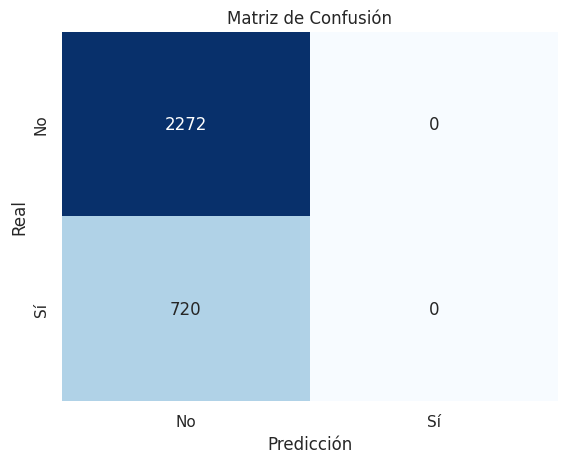

In [350]:
# Obtener los mejores hiperparámetros
best_params_nn = study.best_params
print(f'Mejor combinación de hiperparámetros: {best_params_nn}')

# Entrenar el modelo final con los mejores hiperparámetros
best_model_cnn = build_model(num_layers=best_params_nn['num_layers'], num_neurons=best_params_nn['num_neurons'])

print("n° de parámetros:", best_model_cnn.count_params())

# Evaluar el modelo final en el conjunto de prueba
test_predictions = best_model_cnn.predict(X_test_scaled_lr)
predictions_test = (test_predictions > 0.5).astype(int)
accuracy = accuracy_score(y_test_logr, predictions_test)
f1 = f1_score(y_test_logr, predictions_test)
precision = precision_score(y_test_logr, predictions_test)
recall = recall_score(y_test_logr, predictions_test)

print(f'Accuracy en conjunto de test: {accuracy:.4f}')
print(f'Precision en conjunto de test: {precision:.4f}')
print(f'Recall en conjunto de validación: {recall:.4f}')
print(f'F1 Score en conjunto de test: {f1:.4f}')

# Calcular la matriz de confusión
matriz_confusion = confusion_matrix(y_test_logr, predictions_test)

# Visualizar la matriz de confusión con Seaborn
sns.heatmap(matriz_confusion, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No', 'Sí'], yticklabels=['No', 'Sí'])
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.title('Matriz de Confusión')
plt.show()

In [351]:
# Calculo la ROC y el AUC
fpr, tpr, thresholds = roc_curve(y_test_logr, predictions_test)
roc_auc = auc(fpr, tpr)

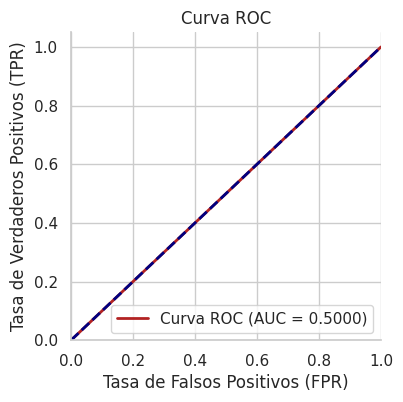

In [352]:
# Grafico la curva ROC
plt.figure(figsize=(4, 4))
sns.set(style="whitegrid")
plt.plot(fpr, tpr, color='firebrick', lw=2, label='Curva ROC (AUC = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos (FPR)')
plt.ylabel('Tasa de Verdaderos Positivos (TPR)')
plt.title('Curva ROC')
plt.legend(loc="lower right")
sns.despine()
plt.show()

In [353]:
print(f"ROC AUC: {roc_auc:.4f}")

ROC AUC: 0.5000


Se observa que,a pesar de haber entrenado la red neuronal con los mejores hiperparámetros hallados, la capacidad de predicción del modelo ha disminuido mucho en relación con el obtenido para la regresión logística, lo que también se refleja en el gráfico de la curva ROC.

## 10 - Explicabilidad mediante SHAP
SHAP (SHapley Additive exPlanations) es una técnica que se utiliza para determinar la influencia de cada característica o "feature" en el resultado de un modelo de aprendizaje automático. SHAP utiliza conceptos como el valor de Shapley para calcular la contribución de cada característica al resultado de un modelo.



### 10.1 - Explicabilidad SHAP para Regresión Logísitica

#### 10.1.1 - Diagrama de barras global
Se crea un gráfico de importancia de entidad global, en el que la importancia global de cada entidad se toma como el valor absoluto medio de esa entidad en todas las muestras dadas.

In [373]:
# Crear el explainer con feature_names
feature_names= X_train_logr.columns.tolist()
explainer = shap.Explainer(best_random_model, X_test_scaled_lr, feature_names=feature_names)

# Calcular los valores SHAP
shap_values = explainer.shap_values(X_test_scaled_lr)

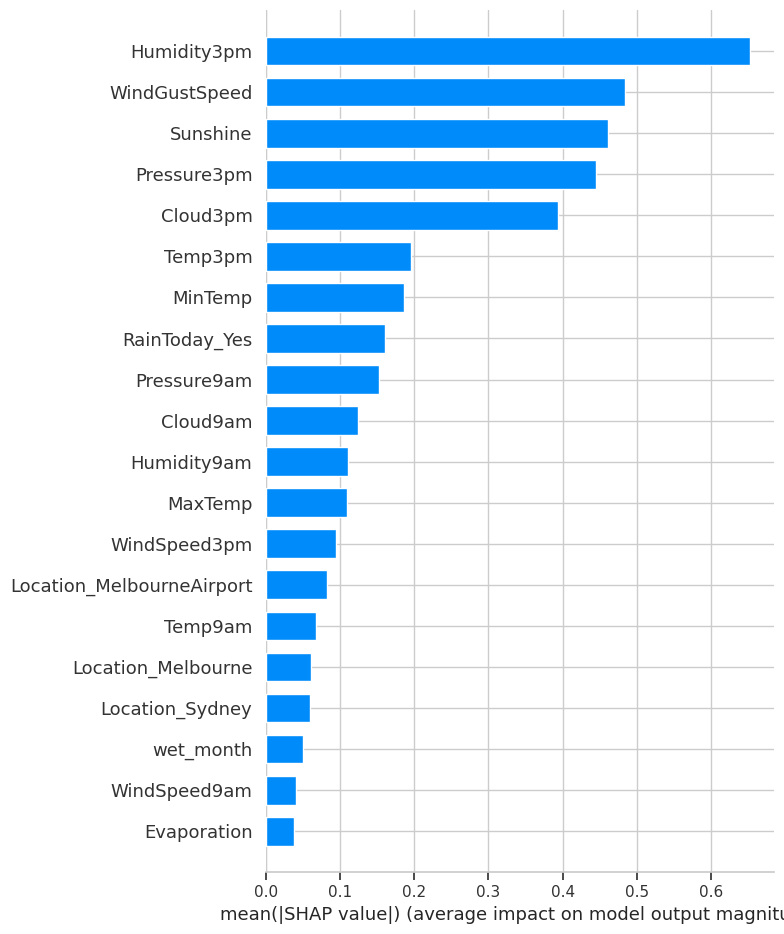

In [374]:
# Graficar los valores SHAP con nombres de características
shap.summary_plot(shap_values, X_test_scaled_lr, feature_names=feature_names, plot_type="bar")
plt.show()

En este gráfico puede observarse el valor absoluto promedio de cada feature, es decir su importancia global en la determinación de la clase. Aquí, se puede ver que la humedad a las 3pm, la velocidad máxima del viento, la presión tanto a las 9am como 3pm, la cantidad de luz solar, la cobertura del cielo por parte de las nubes y la temperatura a las 3pm condensan más del 75% de la "influencia" para determinar si llovió al día siguiente o no.

Cabe destacar que varias de estas características están relacionadas. Por ejemplo, la velocidad del viento, por el principio de Bernoulli tiene efecto en la presión, así como también la temperatura ya que el aire caliente es menos denso que el frío, y la humedad porque el aire húmedo es más denso que el seco. Además, la cantidad de luz solar es proporcional al porcentaje de cielo cubierto por las nubes.

#### 10.1.2 - Gráfico de Enjambre de Abejas
El gráfico de enjambre de abejas está diseñado para mostrar un resumen denso en información de cómo las features principales de un dataset afectan a la salida del modelo. En cada caso, la explicación dada está representada por un solo punto en cada característica de la imagen. La posición x del punto está determinada por el valor SHAP de esa feature, y los puntos se "apilan" a lo largo de la fila de cada feature para mostrar la densidad. El color se utiliza para mostrar el valor original de una feature.

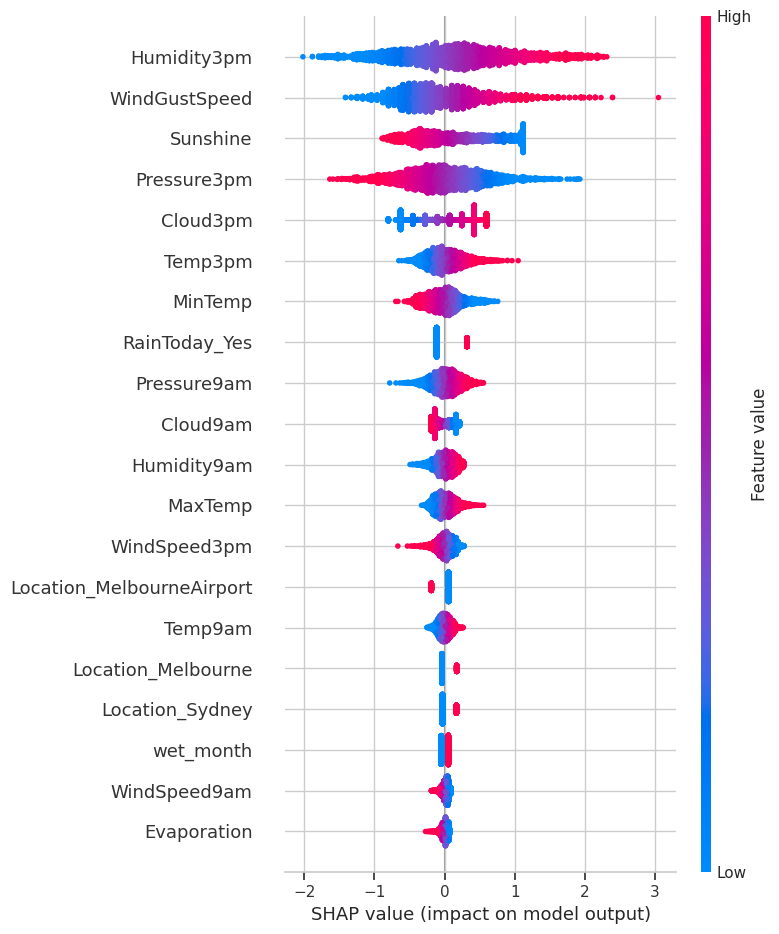

In [357]:
# Graficar los valores SHAP con nombres de características
shap.summary_plot(shap_values, X_test_scaled_lr, feature_names=feature_names)
plt.show()

Las características, al igual que en el diagrama de barras global, están ordenadas en orden descendiente de valor medio absoluto de los valores SHAP para los registros. Pero además podemos ver no solo la distribución de los valores SHAP para cada característica, sino tambén Cómo se comporta el valor shar según el valor de la característica. Por ejemplo, en las características más influyentes en determinar la clase del registro, A valores más altos de humedad, influye positivamente en favor de predecir que lloverá al día siguiente, mientras que valores más bajos a lo contrario. Lo mismo sucede la velocidad del viento, la presión a las 9am y temperatura a las 3pm, pero sucede lo contrario con la presión a las 3pm y las horas luz solar en el día.

Es interesante destacar las presiones tomadas en distintas horas del día, aportan valores SHAP de signos opuesto para una misma intensidad de presión. Esto podría revelar que aquellos días dónde la la presión desciende de la mañana a la tarde, son probables de ser sucedidos por días de lluvia.

### 10.2 - Explicabilidad SHAP para Red Neuronal

#### 10.2.1 - Diagrama de barras global


In [383]:
# Crear el explainer con feature_names
feature_names= X_train_logr.columns.tolist()
explainer_nn = shap.Explainer(best_model_cnn, X_test_scaled_lr, feature_names=feature_names)

# Calcular los valores SHAP
shap_values = explainer_nn.shap_values(X_test_scaled_lr)

PermutationExplainer explainer: 2993it [05:34,  8.69it/s]


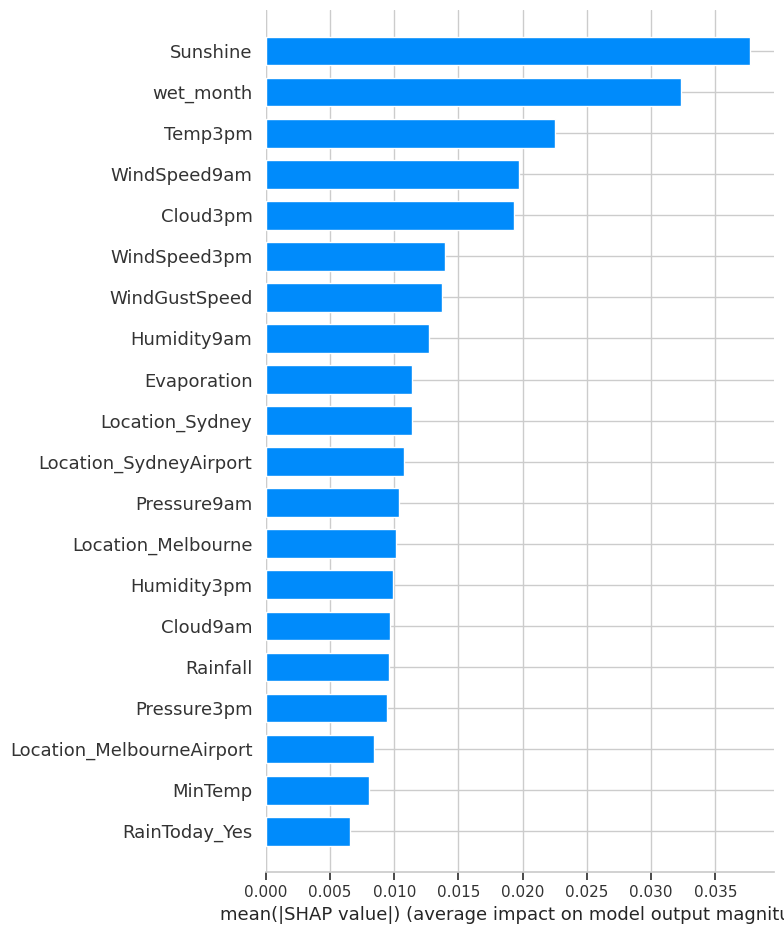

In [384]:
# Graficar los valores SHAP con nombres de características
shap.summary_plot(shap_values, X_test_scaled_lr, feature_names=feature_names, plot_type="bar")
plt.show()

Se observa que para el modelo de red neuronal entrenado, las variables que mayor influencia tienen en promedio a la hora de realizar predicciones son las de Sunshine, wt_month y Temp3pm.

Las variables más rlevantes a la hora de realizar la predicción difieren sustancialemente de las consideradas en el modelo de regresión logística.
Esto hace pensar que una de las razones por las que la red neuronal tiene tan bajo rendimiento, es porque en su aprendizaje priorizó variables que en realidad no so relevantes.
Puede darse a que ha realizado un overfitting sobre los datos de entrenamiento.

#### 10.2.2 - Gráfico de Enjambre de Abejas


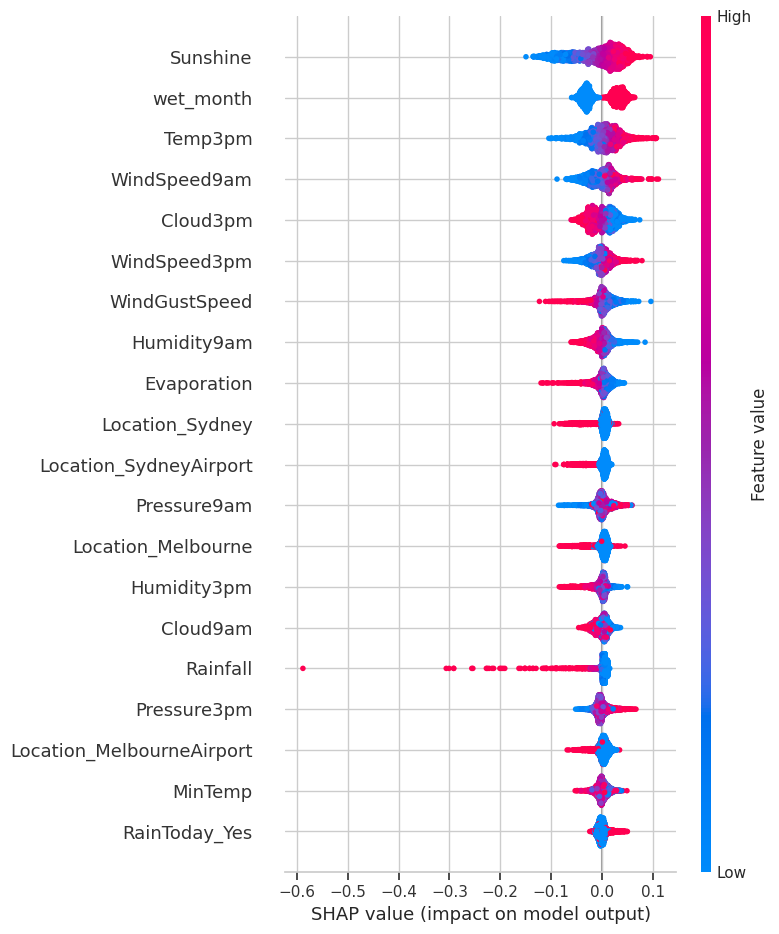

In [385]:
# Graficar los valores SHAP con nombres de características
shap.summary_plot(shap_values, X_test_scaled_lr, feature_names=feature_names)
plt.show()

Observando en más detalle, se encuentra que todas las variables tienen un rango de shap values muy bajo, ya sea positivo o negativo. Es decir, el aporte de cada valor de la variable para la predicción de un dato es muy similar para todas las variables, no destacandose ninguna con una contribución mucho más significativa que el resto.


# Conclusiones

- Sobre el análisis descriptivo:

  Se debe describir adecuadamente cada variable involucrada en el problema, para entenderlo mejor.
  La decisión  que se tome sobre los datos faltantes debe basarse en una comprensión del conjunto de datos y puede implicar la imputación o eliminación de datos faltantes. En este caso se ha usado KNN que es una técnica conocida y pensamos efectiva al considerar la cercanía al momento de imputar.
  La visualización de datos, como histogramas, scatterplots y diagramas de caja, ayuda a comprender las distribuciones y las relaciones entre variables.
  Evaluar si el dataset está balanceado es crucial para el rendimiento del modelo. Un desequilibrio puede afectar la capacidad del modelo para aprender patrones en las clases minoritarias.

- Sobre codificación de variables categóricas:

  Codificar adecuadamente las variables categóricas es esencial para que los algoritmos de aprendizaje automático las utilicen de manera efectiva, ya que de no hacerlo no podrían utilizarse y se podría con ello perder información valiosa.

- Sobre modelos de regresión:

  El probar diferentes métodos de regresión (Lineal, Gradient Descent, Regularización) ha permitido evaluar cuál se ajusta mejor al problema.
  La elección del mejor modelo se ha basado en métricas como R2 ajustado y RMSE, sobre todo en el primero ya que se buscaba que la explicación de la variabilidad fuera la mayor posible, aunque se equivoque con errores más grandes.

- Sobre modelos de regresión logística:

  La regresión logística ha sido un buen punto de partida para problemas de clasificación binaria. Su rendimiento ha sido destacado. Balancear el set de entrenamiento ha tenido influencia en ello.
  Las métricas de clasificación (Accuracy, Precision, Recall, F1 Score, ROC-AUC) han permitido evaluar el rendimiento del modelo.

- Sobre redes neuronales:

  Implementar redes neuronales ha permitido explorar patrones no lineales y complejidades en los datos. Esto ha mostrado ser una incorporación que produjo una considerable mejora al momento de predecir la cantidad de lluvia. Más no lo ha sido para predecir si llueve o no, posiblemete debido a un overfitting de la red neuronal para el set de entrenamiento.

- Sobre la optimización de hiperparámetros:

  La optimización de hiperparámetros es esencial cuando se busca mejorar el rendimiento del modelo. En los casos aplicados, ha hallado parámetros óptimos dentro de los sigeridos, pero no se ha logrado un salto cualitativo en los rendimientos del modelo. Puede que haya sido necesario probar más combinaciones o que el modelo haya llegado a un límite en su rendimiento.

- Sobre la explicabilidad de los modelos:

  SHAP puede proporcionar insights sobre cómo las características contribuyen a las predicciones del modelo.
  Realizar este análisis ha sido de mucha utilidad para conocer las diferencias de los modelos a un nivel más cualitativo que cuantitativo, es decir, a nivel de métricas. Se ha podido observar cómo los modelos difieren en cuanto a las variables que en promedio más contribuyen al resultado de la predicción y se ha podrido asociar esto con los rendimientos numéricos.

Conclusiones finales:

La comparación entre modelos de regresión y clasificación puede revelar cuál se adapta mejor al problema específico. En el caso analizado se encuentra que la clasificación se adapta mejor a los datos proporcionados.
Las redes neuronales pueden ser poderosas pero deben sopesarse con la complejidad y recursos necesarios. Entrenar redes neuronales ha consumido muchos recursos de cómputo y tiempo. En el caso de la clasificación, si fuera éste un proyecto de una organización, se podría considerar que quizá no sea la mejoor opción para la clasificación.
La explicabilidad del modelo es crucial para entender cómo toma decisiones el mismo. Esto también permite hacer hincapié sobre los datos que es más importante disponer al momento de realizar predicciones futuras. Es decir, tener la certeza de que son valores que se pueden obtener en el futuro para tener una mayor confianza en las estimaciones del modelo y en su correcto funcionamiento.